In [1]:
# import relevant packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_selection import mutual_info_classif, mutual_info_regression, SelectKBest, f_regression
from sklearn.feature_selection import f_classif, RFECV, chi2
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression, LassoCV, LinearRegression
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.model_selection import train_test_split, cross_val_score, KFold, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import TransformedTargetRegressor
from sklearn.metrics import mean_squared_error, r2_score, SCORERS, accuracy_score, confusion_matrix
from sklearn.metrics import classification_report, roc_auc_score
from imblearn.over_sampling import RandomOverSampler
from sklearn.dummy import DummyRegressor, DummyClassifier
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier


%matplotlib inline

Using TensorFlow backend.
/Applications/anaconda3/lib/python3.6/site-packages/dask/config.py:168: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}
/Applications/anaconda3/lib/python3.6/site-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


# 1) Data Gathering

## 1.1) Create dataframe with feature descriptions

In [2]:
# df with feature descriptions
df_features = pd.read_excel('CollegeScorecardDataDictionary.xlsx', sheet_name=3)

In [3]:
# visually inspect df
df_features.head()

,NAME OF DATA ELEMENT,dev-category,developer-friendly name,API data type,VARIABLE NAME,VALUE,LABEL,SOURCE,NOTES
0,Unit ID for institution,root,id,integer,UNITID,NaN,NaN,IPEDS,Shown/used on consumer website.
1,8-digit OPE ID for institution,root,ope8_id,string,OPEID,NaN,NaN,IPEDS,Shown/used on consumer website.
2,6-digit OPE ID for institution,root,ope6_id,string,OPEID6,NaN,NaN,IPEDS,Shown/used on consumer website.
3,Institution name,school,name,autocomplete,INSTNM,NaN,NaN,IPEDS,Shown/used on consumer website.
4,City,school,city,autocomplete,CITY,NaN,NaN,IPEDS,Shown/used on consumer website.


## 1.2) Create dataframe with working data (feature columns and datapoint rows)

In [4]:
# df with working data
df_data = pd.read_csv('MERGED2017_18_PP.csv')

/Applications/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3020: DtypeWarning: Columns (31,1726,1727,1728,1729,1815,1817,1823,1830,1879,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,1890,1891,1892,1893,1894,1895,1896,1897,1898,1957,1958,1959,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,1975,1976) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [5]:
# visually inspect data
df_data.head()

,UNITID,OPEID,OPEID6,INSTNM,CITY,STABBR,ZIP,ACCREDAGENCY,INSTURL,NPCURL,...,OMAWDP8_NOTFIRSTTIME_POOLED_SUPP,OMENRUP_NOTFIRSTTIME_POOLED_SUPP,OMENRYP_FULLTIME_POOLED_SUPP,OMENRAP_FULLTIME_POOLED_SUPP,OMAWDP8_FULLTIME_POOLED_SUPP,OMENRUP_FULLTIME_POOLED_SUPP,OMENRYP_PARTTIME_POOLED_SUPP,OMENRAP_PARTTIME_POOLED_SUPP,OMAWDP8_PARTTIME_POOLED_SUPP,OMENRUP_PARTTIME_POOLED_SUPP
0,100654,100200,1002,Alabama A & M University,Normal,AL,35762,Southern Association of Colleges and Schools C...,www.aamu.edu/,https://galileo.aamu.edu/NetPriceCalculator/np...,...,0.4048,0.2645,0.0137,0.315,0.3755,0.2958,0.0289,0.4224,0.2635,0.2852
1,100663,105200,1052,University of Alabama at Birmingham,Birmingham,AL,35294-0110,Southern Association of Colleges and Schools C...,www.uab.edu,uab.studentaidcalculator.com/survey.aspx,...,0.5448,0.12,0.0728,0.2583,0.5872,0.0817,0.1398,0.2618,0.3977,0.2008
2,100690,2503400,25034,Amridge University,Montgomery,AL,36117-3553,Southern Association of Colleges and Schools C...,www.amridgeuniversity.edu,www2.amridgeuniversity.edu:9091/,...,0.4647,0.1912,0.0148,0.3284,0.4391,0.2177,0.028,0.3645,0.4486,0.1589
3,100706,105500,1055,University of Alabama in Huntsville,Huntsville,AL,35899,Southern Association of Colleges and Schools C...,www.uah.edu,finaid.uah.edu/,...,0.5121,0.1593,0.0165,0.323,0.5361,0.1243,0.0245,0.3947,0.3476,0.2331
4,100724,100500,1005,Alabama State University,Montgomery,AL,36104-0271,Southern Association of Colleges and Schools C...,www.alasu.edu,www.alasu.edu/cost-aid/forms/calculator/index....,...,0.4226,0.0754,0.0254,0.5327,0.3133,0.1286,0.021,0.5804,0.1678,0.2308


# 2) Data Assessment

## 2.1) Assess df with feature descriptions

In [6]:
# dimensionality of df_features
df_features.shape

(2231, 9)

**Clean df_features first and continue assessment with cleanded df**

In [23]:
# after cleaning df_features are there NaNs
# df_features_clean created in data cleaning section
df_features_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1977 entries, 0 to 2230
Data columns (total 3 columns):
VARIABLE NAME           1977 non-null object
API data type           1977 non-null object
NAME OF DATA ELEMENT    1977 non-null object
dtypes: object(3)
memory usage: 61.8+ KB


In [24]:
# is there a description of ICLEVEL data
df_features_clean[df_features_clean['VARIABLE NAME'].str.contains('ICLEVEL')]

,VARIABLE NAME,API data type,NAME OF DATA ELEMENT
1983,ICLEVEL,integer,Level of institution


In [25]:
# what are NPT variables about
df_features_clean[df_features_clean['VARIABLE NAME'].str.contains('NPT')]

,VARIABLE NAME,API data type,NAME OF DATA ELEMENT
558,NPT4_PUB,integer,Average net price for Title IV institutions (p...
559,NPT4_PRIV,integer,Average net price for Title IV institutions (p...
560,NPT4_PROG,integer,Average net price for the largest program at t...
561,NPT4_OTHER,integer,Average net price for the largest program at t...
562,NPT41_PUB,integer,"Average net price for $0-$30,000 family income..."
563,NPT42_PUB,integer,"Average net price for $30,001-$48,000 family i..."
564,NPT43_PUB,integer,"Average net price for $48,001-$75,000 family i..."
565,NPT44_PUB,integer,"Average net price for $75,001-$110,000 family ..."
566,NPT45_PUB,integer,"Average net price for $110,000+ family income ..."
567,NPT41_PRIV,integer,"Average net price for $0-$30,000 family income..."


**Coment:
NPT varibles can be dropped.**

In [26]:
# description of possible dependent variables
df_features_clean[df_features_clean['VARIABLE NAME'].str.contains('OMA') | df_features_clean['VARIABLE NAME'].str.contains('OME')]

,VARIABLE NAME,API data type,NAME OF DATA ELEMENT
206,WOMENONLY,integer,Flag for women-only college
1987,UGDS_WOMEN,float,Total share of enrollment of undergraduate deg...
2026,OMACHT6_FTFT,integer,"Adjusted cohort count of full-time, first-time..."
2027,OMAWDP6_FTFT,float,"Percentage of full-time, first-time student re..."
2028,OMACHT8_FTFT,integer,"Adjusted cohort count of full-time, first-time..."
2029,OMAWDP8_FTFT,float,"Percentage of full-time, first-time student re..."
2030,OMENRYP8_FTFT,float,"Percentage of full-time, first-time students t..."
2031,OMENRAP8_FTFT,float,"Percentage of full-time, first-time students t..."
2032,OMENRUP8_FTFT,float,"Percentage of full-time, first-time students t..."
2033,OMACHT6_PTFT,integer,"Adjusted cohort count of part-time, first-time..."


## 2.2) Assess df with working data

In [7]:
# dimensionality of df
df_data.shape

(7112, 1977)

In [8]:
# get info about features
df_data.info(max_cols=2000)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7112 entries, 0 to 7111
Data columns (total 1977 columns):
UNITID                              7112 non-null int64
OPEID                               7112 non-null int64
OPEID6                              7112 non-null int64
INSTNM                              7112 non-null object
CITY                                7112 non-null object
STABBR                              7112 non-null object
ZIP                                 7112 non-null object
ACCREDAGENCY                        6493 non-null object
INSTURL                             7093 non-null object
NPCURL                              6608 non-null object
SCH_DEG                             0 non-null float64
HCM2                                7112 non-null int64
MAIN                                7112 non-null int64
NUMBRANCH                           7112 non-null int64
PREDDEG                             7112 non-null int64
HIGHDEG                             7112 non-

In [9]:
# check 0 non-null column
df_data['IND_YR6_N'].isnull().sum()

7112

In [10]:
# check 0 non-null column
df_data['IND_YR6_N'][np.r_[:10, -10:-0]]

/Applications/anaconda3/lib/python3.6/site-packages/pandas/core/series.py:696: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self.loc[key]


 0    NaN
 1    NaN
 2    NaN
 3    NaN
 4    NaN
 5    NaN
 6    NaN
 7    NaN
 8    NaN
 9    NaN
-10   NaN
-9    NaN
-8    NaN
-7    NaN
-6    NaN
-5    NaN
-4    NaN
-3    NaN
-2    NaN
-1    NaN
Name: IND_YR6_N, dtype: float64

In [11]:
# check variable on which data dependent variables were created
df_data['ICLEVEL'].value_counts(dropna=False)

1    3212
2    2021
3    1879
Name: ICLEVEL, dtype: int64

**Remove all NaN columns first in cleaning section and continue assessment with partially cleaned df**

In [27]:
# check distribution of values of SAT variables
# df_copy was created in data cleaning section below
df_copy[['SATVR25', 'SATVR75', 'SATMT25', 'SATMT75', 'SATVRMID', 'SATMTMID', 'SAT_AVG', 'SAT_AVG_ALL','ACTCMMID', 'ACTENMID', 'ACTMTMID']]

,SATVR25,SATVR75,SATMT25,SATMT75,SATVRMID,SATMTMID,SAT_AVG,SAT_AVG_ALL,ACTCMMID,ACTENMID,ACTMTMID
0,365.0,485.0,360.0,495.0,425.0,428.0,929.0,929.0,18.0,17.0,17.0
1,440.0,630.0,550.0,740.0,535.0,645.0,1195.0,1195.0,25.0,27.0,24.0
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,550.0,660.0,530.0,670.0,605.0,600.0,1322.0,1322.0,28.0,29.0,27.0
4,380.0,485.0,375.0,481.0,433.0,428.0,935.0,935.0,18.0,17.0,17.0
5,530.0,640.0,520.0,640.0,585.0,580.0,1278.0,1278.0,28.0,28.0,25.0
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,490.0,565.0,475.0,545.0,528.0,510.0,1083.0,1083.0,22.0,22.0,20.0
9,570.0,650.0,560.0,660.0,610.0,610.0,1282.0,1282.0,27.0,28.0,26.0


In [28]:
# check distribution of PCIP variables
df_copy[['PCIP01', 'PCIP03', 'PCIP04']]

,PCIP01,PCIP03,PCIP04
0,0.0375,0.0177,0.0088
1,0.0000,0.0000,0.0000
2,0.0000,0.0000,0.0000
3,0.0000,0.0000,0.0000
4,0.0000,0.0000,0.0000
5,0.0000,0.0034,0.0000
6,0.0000,0.0000,0.0000
7,0.0000,0.0000,0.0000
8,0.0000,0.0046,0.0000
9,0.0439,0.0157,0.0157


In [29]:
# check distribution of PCIP NaN
df_copy[['PCIP01', 'PCIP03', 'PCIP04']].iloc[6667: , :].head()

,PCIP01,PCIP03,PCIP04
6667,0.0,0.0,0.0
6668,NaN,NaN,NaN
6669,NaN,NaN,NaN
6670,NaN,NaN,NaN
6671,NaN,NaN,NaN


In [30]:
# check  sum of percentages of PCP variables per datapoint
df_copy.iloc[6000, 60:98].sum()

1.0

In [31]:
# check CIP variables and distribution of NaN
df_copy[['CIP54CERT1', 'CIP54CERT2', 'CIP54ASSOC', 'CIP54CERT4', 'CIP54BACHL']].iloc[6667: , :].head()

,CIP54CERT1,CIP54CERT2,CIP54ASSOC,CIP54CERT4,CIP54BACHL
6667,0.0,0.0,0.0,0.0,0.0
6668,NaN,NaN,NaN,NaN,NaN
6669,NaN,NaN,NaN,NaN,NaN
6670,NaN,NaN,NaN,NaN,NaN
6671,NaN,NaN,NaN,NaN,NaN


**Comment:
Seems that starting with datapoint 6668 till end of df only NaN values**

In [32]:
# check possible dependent variables
df_copy[['C150_4_POOLED', 'C150_L4_POOLED', 'OMAWDP6_FTFT', 'RET_FT4_POOLED', 'RET_FTL4_POOLED', 'RET_PT4_POOLED', 'RET_PTL4_POOLED']]

,C150_4_POOLED,C150_L4_POOLED,OMAWDP6_FTFT,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED
0,0.2594,NaN,0.3049,0.5828,NaN,0.2759,NaN
1,0.5300,NaN,0.5372,0.8312,NaN,0.4357,NaN
2,0.2424,NaN,0.3750,0.2500,NaN,0.1765,NaN
3,0.4864,NaN,0.4740,0.8251,NaN,0.5000,NaN
4,0.2468,NaN,0.2657,0.6082,NaN,0.3636,NaN
5,0.6828,NaN,0.6674,0.8669,NaN,0.4528,NaN
6,NaN,0.2462,0.1522,NaN,0.6243,NaN,0.3711
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,0.2488,NaN,0.1907,0.6747,NaN,0.4713,NaN
9,0.7580,NaN,0.7315,0.9125,NaN,0.8072,NaN


In [33]:
# check possible dependent variables
df_copy[['C150_4_POOLED', 'C150_L4_POOLED', 'OMAWDP6_FTFT', 'RET_FT4_POOLED', 'RET_FTL4_POOLED', 'RET_PT4_POOLED', 'RET_PTL4_POOLED']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7112 entries, 0 to 7111
Data columns (total 7 columns):
C150_4_POOLED      2399 non-null float64
C150_L4_POOLED     3576 non-null float64
OMAWDP6_FTFT       3822 non-null float64
RET_FT4_POOLED     2221 non-null float64
RET_FTL4_POOLED    3489 non-null float64
RET_PT4_POOLED     1555 non-null float64
RET_PTL4_POOLED    2016 non-null float64
dtypes: float64(7)
memory usage: 389.0 KB


In [34]:
# check REGION variable
df_copy['REGION'][:5]

0    5
1    5
2    5
3    5
4    5
Name: REGION, dtype: int64

In [35]:
# check LOCALE variable
df_copy['LOCALE'][:5]

0    12.0
1    12.0
2    12.0
3    12.0
4    12.0
Name: LOCALE, dtype: float64

**Coment:
Varibles can be dropped.**

# 3) Data Cleaning

## 3.1) Clean dataframe with feature descriptions

In [12]:
# condense df to variables of interest
df_features_clean = df_features.loc[:,['VARIABLE NAME', 'API data type','NAME OF DATA ELEMENT']]

In [13]:
# check df
df_features_clean.head()

,VARIABLE NAME,API data type,NAME OF DATA ELEMENT
0,UNITID,integer,Unit ID for institution
1,OPEID,string,8-digit OPE ID for institution
2,OPEID6,string,6-digit OPE ID for institution
3,INSTNM,autocomplete,Institution name
4,CITY,autocomplete,City


In [14]:
# check if variables are complete
df_features_clean.isna().sum()

VARIABLE NAME           254
API data type           254
NAME OF DATA ELEMENT    254
dtype: int64

In [15]:
# delete NaN rows
df_features_clean.dropna(axis=0, how='all', inplace=True)

In [16]:
# check df
df_features_clean.head(30)

,VARIABLE NAME,API data type,NAME OF DATA ELEMENT
0,UNITID,integer,Unit ID for institution
1,OPEID,string,8-digit OPE ID for institution
2,OPEID6,string,6-digit OPE ID for institution
3,INSTNM,autocomplete,Institution name
4,CITY,autocomplete,City
5,STABBR,string,State postcode
6,ZIP,string,ZIP code
7,ACCREDAGENCY,string,Accreditor for institution
8,INSTURL,string,URL for institution's homepage
9,NPCURL,string,URL for institution's net price calculator


In [17]:
# reset index
df_features_clean.reset_index(drop=True).head()

,VARIABLE NAME,API data type,NAME OF DATA ELEMENT
0,UNITID,integer,Unit ID for institution
1,OPEID,string,8-digit OPE ID for institution
2,OPEID6,string,6-digit OPE ID for institution
3,INSTNM,autocomplete,Institution name
4,CITY,autocomplete,City


In [18]:
# check dtypes of variables
df_features_clean['API data type'].value_counts(dropna=False)

float           1343
integer          608
string            23
autocomplete       3
Name: API data type, dtype: int64

## 3.2) Clean df with working data

### 3.2.1) Make working copy of df

In [19]:
# create copy of original data
df_copy = df_data.copy()

### 3.2.2) Delete all "all NaN" columns

In [20]:
# drop columns containing exclusively NaN
df_copy.dropna(how='all', axis=1, inplace=True)

In [21]:
# check df
df_copy.shape

(7112, 648)

In [22]:
# check df
df_copy.info(max_cols=1000)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7112 entries, 0 to 7111
Data columns (total 648 columns):
UNITID                              7112 non-null int64
OPEID                               7112 non-null int64
OPEID6                              7112 non-null int64
INSTNM                              7112 non-null object
CITY                                7112 non-null object
STABBR                              7112 non-null object
ZIP                                 7112 non-null object
ACCREDAGENCY                        6493 non-null object
INSTURL                             7093 non-null object
NPCURL                              6608 non-null object
HCM2                                7112 non-null int64
MAIN                                7112 non-null int64
NUMBRANCH                           7112 non-null int64
PREDDEG                             7112 non-null int64
HIGHDEG                             7112 non-null int64
CONTROL                             7112 non-

### 3.2.3) Delete columns that are assessed as not institution related

**(see: df_features_clean and https://collegescorecard.ed.gov/assets/FullDataDocumentation.pdf)**

In [36]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='NPT')))]

In [37]:
# check df
df_copy.shape

(7112, 630)

In [38]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='POOLY')))]

In [39]:
#check df
df_copy.shape

(7112, 616)

In [40]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='OMENR.P')))]

In [41]:
# check df
df_copy.shape

(7112, 550)

In [42]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='MTHC')))]

In [43]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='CIP[CT]')))]

In [44]:
# check df
df_copy.shape

(7112, 520)

In [45]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='.1.0')))]

In [46]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='TRANS')))]

In [47]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='.2.0')))]

In [48]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='DEBT')))]

In [49]:
# check df
df_copy.shape

(7112, 400)

In [50]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='N..4')))]

In [51]:
#check df
df_copy.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7112 entries, 0 to 7111
Data columns (total 388 columns):
UNITID                              7112 non-null int64
OPEID                               7112 non-null int64
OPEID6                              7112 non-null int64
INSTNM                              7112 non-null object
CITY                                7112 non-null object
STABBR                              7112 non-null object
ZIP                                 7112 non-null object
ACCREDAGENCY                        6493 non-null object
INSTURL                             7093 non-null object
NPCURL                              6608 non-null object
HCM2                                7112 non-null int64
MAIN                                7112 non-null int64
NUMBRANCH                           7112 non-null int64
PREDDEG                             7112 non-null int64
HIGHDEG                             7112 non-null int64
CONTROL                             7112 non-

In [52]:
# drop not needed columns
df_copy = df_copy.drop(df_copy.columns[-21:], axis=1)

In [53]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='OMACHT')))]

In [54]:
# check df
df_copy.info(max_cols=360)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7112 entries, 0 to 7111
Data columns (total 351 columns):
UNITID                  7112 non-null int64
OPEID                   7112 non-null int64
OPEID6                  7112 non-null int64
INSTNM                  7112 non-null object
CITY                    7112 non-null object
STABBR                  7112 non-null object
ZIP                     7112 non-null object
ACCREDAGENCY            6493 non-null object
INSTURL                 7093 non-null object
NPCURL                  6608 non-null object
HCM2                    7112 non-null int64
MAIN                    7112 non-null int64
NUMBRANCH               7112 non-null int64
PREDDEG                 7112 non-null int64
HIGHDEG                 7112 non-null int64
CONTROL                 7112 non-null int64
ST_FIPS                 7112 non-null int64
REGION                  7112 non-null int64
LOCALE                  6668 non-null float64
LATITUDE                6668 non-null float64
L

In [55]:
# drop not needed columns
df_copy = df_copy[df_copy.columns.drop(list(df_copy.filter(regex='OMAWDP8')))]

In [56]:
# drop not needed columns
df_copy = df_copy.drop(df_copy.columns[np.r_[-12:-4, -27:-16]], axis=1)

In [57]:
# drop not needed columns
df_copy = df_copy.drop(df_copy.columns[-21:-11], axis=1)

In [58]:
# drop not needed columns
df_copy = df_copy.drop('CURROPER', axis=1)

In [59]:
# drop not needed columns
df_copy = df_copy.drop(df_copy.columns[:3], axis=1)

In [60]:
# drop not needed columns
df_copy = df_copy.drop(df_copy.columns[np.r_[1,3:10,13:16, 18:21]], axis=1)

In [61]:
# drop not needed columns
df_copy = df_copy.drop('SAT_AVG', axis=1)

In [62]:
# check df
df_copy.shape

(7112, 295)

In [63]:
# check df
df_copy.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7112 entries, 0 to 7111
Data columns (total 295 columns):
INSTNM                  7112 non-null object
STABBR                  7112 non-null object
PREDDEG                 7112 non-null int64
HIGHDEG                 7112 non-null int64
CONTROL                 7112 non-null int64
LATITUDE                6668 non-null float64
LONGITUDE               6668 non-null float64
HBCU                    6587 non-null float64
PBI                     6587 non-null float64
ANNHI                   6587 non-null float64
TRIBAL                  6587 non-null float64
AANAPII                 6587 non-null float64
HSI                     7112 non-null object
NANTI                   6587 non-null float64
MENONLY                 6668 non-null float64
WOMENONLY               6668 non-null float64
RELAFFIL                921 non-null float64
ADM_RATE                2037 non-null float64
ADM_RATE_ALL            2250 non-null float64
SATVR25                 1238

In [64]:
# delete rows that predominantly contain NaNs see data assessment
df_copy = df_copy.iloc[:6668 , :]

In [65]:
# check df
df_copy.tail()

,INSTNM,STABBR,PREDDEG,HIGHDEG,CONTROL,LATITUDE,LONGITUDE,HBCU,PBI,ANNHI,...,UGDS_MEN,UGDS_WOMEN,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
6663,Johnny Matthew's Hairdressing Training School,OR,1,1,3,44.941812,-123.038361,0.0,0.0,0.0,...,0.2982,0.7018,NaN,0.6667,NaN,NaN,NaN,NaN,NaN,NaN
6664,University of Wisconsin-Milwaukee Flex,WI,3,3,1,43.076848,-87.880488,0.0,0.0,0.0,...,0.3234,0.6766,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6665,University of Wisconsin-Parkside Flex,WI,1,1,1,42.645603,-87.855007,0.0,0.0,0.0,...,0.8000,0.2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6666,University of Wisconsin Colleges Flex,WI,2,2,1,43.068214,-89.398590,0.0,0.0,0.0,...,0.4074,0.5926,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6667,Platt College-Edge Tech Academy,TX,1,0,3,32.834122,-97.196111,0.0,0.0,0.0,...,0.7500,0.2500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [66]:
# check df
df_copy.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6668 entries, 0 to 6667
Data columns (total 295 columns):
INSTNM                  6668 non-null object
STABBR                  6668 non-null object
PREDDEG                 6668 non-null int64
HIGHDEG                 6668 non-null int64
CONTROL                 6668 non-null int64
LATITUDE                6668 non-null float64
LONGITUDE               6668 non-null float64
HBCU                    6587 non-null float64
PBI                     6587 non-null float64
ANNHI                   6587 non-null float64
TRIBAL                  6587 non-null float64
AANAPII                 6587 non-null float64
HSI                     6668 non-null object
NANTI                   6587 non-null float64
MENONLY                 6668 non-null float64
WOMENONLY               6668 non-null float64
RELAFFIL                921 non-null float64
ADM_RATE                2037 non-null float64
ADM_RATE_ALL            2139 non-null float64
SATVR25                 1238

### 3.2.4) Save partially cleaned df

In [67]:
# save partially cleaned df
df_copy.to_csv('df_copy.csv', index=False)

In [68]:
# read in partially cleaned df
df_copy = pd.read_csv('df_copy.csv')

In [69]:
# check working df
df_copy.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6668 entries, 0 to 6667
Data columns (total 295 columns):
INSTNM                  6668 non-null object
STABBR                  6668 non-null object
PREDDEG                 6668 non-null int64
HIGHDEG                 6668 non-null int64
CONTROL                 6668 non-null int64
LATITUDE                6668 non-null float64
LONGITUDE               6668 non-null float64
HBCU                    6587 non-null float64
PBI                     6587 non-null float64
ANNHI                   6587 non-null float64
TRIBAL                  6587 non-null float64
AANAPII                 6587 non-null float64
HSI                     6668 non-null object
NANTI                   6587 non-null float64
MENONLY                 6668 non-null float64
WOMENONLY               6668 non-null float64
RELAFFIL                921 non-null float64
ADM_RATE                2037 non-null float64
ADM_RATE_ALL            2139 non-null float64
SATVR25                 1238

### 3.2.5) Clean remaining variables

**Check STABBR variable**

**(State postcode)**

In [70]:
# check features
df_copy['STABBR'].value_counts(dropna=False)

CA    663
NY    442
TX    411
FL    361
PA    357
OH    307
IL    264
NC    176
MA    172
MO    171
MI    170
TN    169
GA    161
VA    157
NJ    156
PR    140
OK    127
LA    126
AZ    120
IN    117
WA    112
CO    110
MN    108
SC    105
WI    103
KY     97
IA     87
OR     87
AL     87
MD     85
AR     81
KS     79
CT     78
WV     74
UT     71
MS     56
NE     49
NM     48
NV     41
NH     40
ME     37
ID     37
MT     31
ND     29
SD     29
HI     25
VT     25
RI     23
DC     22
DE     17
WY     10
AK      9
GU      3
VI      1
MH      1
MP      1
AS      1
FM      1
PW      1
Name: STABBR, dtype: int64

**Comment:
State column can be deleted as independent variable but will be kept for EDA.**

**Check categorical variables**

**(Predominant undergraduate degree awarded, Highest degree awarded, Control of institution)**

In [71]:
# check features
df_copy['PREDDEG'].value_counts(dropna=False)

1    3010
3    2109
2    1235
4     310
0       4
Name: PREDDEG, dtype: int64

**Comment:
Nominal variable will be OneHotEncoded. Graduate degree not higher than bachelors degree.**

In [72]:
# check features
df_copy['HIGHDEG'].value_counts(dropna=False)

1    2279
4    2052
2    1518
3     788
0      31
Name: HIGHDEG, dtype: int64

**Comment:
Nominal variable will be OneHotEncoded. Graduate degree not higher than Bachelor degree.**

In [73]:
# check features
df_copy['CONTROL'].value_counts(dropna=False)

3    2776
1    1987
2    1905
Name: CONTROL, dtype: int64

**Comment:
Nominal variable will be OneHotEncoded**

**Check RELAFFIL variable**

**(Religous affiliation of the institution)**

In [74]:
# check features
df_copy['RELAFFIL'].value_counts(dropna=False)

NaN       5747
 30.0      251
 71.0       95
 54.0       64
 66.0       56
 42.0       39
 80.0       35
 39.0       28
 79.0       27
 75.0       24
 88.0       22
 52.0       18
 74.0       18
 61.0       18
 48.0       17
 95.0       14
 76.0       14
 27.0       13
 99.0       12
 68.0       12
 57.0       10
 59.0       10
 73.0        8
 89.0        8
 65.0        7
 58.0        6
 69.0        6
 78.0        6
 51.0        6
 49.0        5
          ... 
 94.0        4
 102.0       4
 24.0        3
 81.0        3
 35.0        3
 47.0        3
 41.0        3
 103.0       3
 43.0        2
 50.0        2
 93.0        2
 28.0        2
 38.0        2
 37.0        2
 44.0        2
 97.0        2
 60.0        2
 67.0        2
 33.0        2
 36.0        1
 100.0       1
 108.0       1
 22.0        1
 84.0        1
 45.0        1
 92.0        1
 87.0        1
 91.0        1
 105.0       1
 107.0       1
Name: RELAFFIL, Length: 63, dtype: int64

**Comment:
RELAFFIL column can be deleted.**

In [75]:
# RELAFFIL can be deleted
df_copy = df_copy.drop('RELAFFIL', axis=1)

In [76]:
# check df
df_copy.shape

(6668, 294)

**Check minority flag variables**

**(Flag for Historically Black College and University, Hispanic. Alaska, Hawaian.....)**

In [77]:
# check features
df_copy['HBCU'].value_counts(dropna=False)

 0.0    6486
 1.0     101
NaN       81
Name: HBCU, dtype: int64

In [78]:
# check features
df_copy['NANTI'].value_counts(dropna=False)

 0.0    6559
NaN       81
 1.0      28
Name: NANTI, dtype: int64

In [79]:
# check features
df_copy['HSI'].value_counts(dropna=False)

0     6145
1      442
NU      81
Name: HSI, dtype: int64

In [80]:
# dropna from minority flag columns
# 81 NaNs see assessment above
df_copy = df_copy.dropna(axis=0, subset=['HBCU'])

In [81]:
# check NaNs in minority flag columns
df_copy.iloc[:, np.r_[7:14]].isna().sum()

HBCU       0
PBI        0
ANNHI      0
TRIBAL     0
AANAPII    0
HSI        0
NANTI      0
dtype: int64

In [82]:
# convert minority flag columns to int
df_copy.iloc[:, np.r_[7:14]] = df_copy.iloc[:, np.r_[7:14]].astype('int64')

In [83]:
# check minority flag columns
df_copy.iloc[:, np.r_[7:14]].describe()

,HBCU,PBI,ANNHI,TRIBAL,AANAPII,HSI,NANTI
count,6587.000000,6587.000000,6587.000000,6587.000000,6587.000000,6587.000000,6587.000000
mean,0.015333,0.015333,0.004403,0.005162,0.020191,0.067102,0.004251
std,0.122884,0.122884,0.066211,0.071665,0.140665,0.250217,0.065064
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [84]:
# check for NU values in HSI
df_copy['HSI'].value_counts(dropna=False)

0    6145
1     442
Name: HSI, dtype: int64

**Comment:
Create binary variable from minority flag columns**

In [85]:
# check df
df_copy.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6587 entries, 0 to 6667
Data columns (total 294 columns):
INSTNM                  6587 non-null object
STABBR                  6587 non-null object
PREDDEG                 6587 non-null int64
HIGHDEG                 6587 non-null int64
CONTROL                 6587 non-null int64
LATITUDE                6587 non-null float64
LONGITUDE               6587 non-null float64
HBCU                    6587 non-null int64
PBI                     6587 non-null int64
ANNHI                   6587 non-null int64
TRIBAL                  6587 non-null int64
AANAPII                 6587 non-null int64
HSI                     6587 non-null int64
NANTI                   6587 non-null int64
MENONLY                 6587 non-null float64
WOMENONLY               6587 non-null float64
ADM_RATE                2033 non-null float64
ADM_RATE_ALL            2134 non-null float64
SATVR25                 1237 non-null float64
SATVR75                 1237 non-null fl

**Check gender variables**

**(Flag for men-only/women-only college)**

In [86]:
# check gender columns
df_copy['MENONLY'].value_counts(dropna=False)

0.0    6524
1.0      63
Name: MENONLY, dtype: int64

In [87]:
# check gender columns
df_copy['WOMENONLY'].value_counts(dropna=False)

0.0    6552
1.0      35
Name: WOMENONLY, dtype: int64

**Comment:
Create binary variable from these two gender columns**

**Check ADM_RATE variables**

**(Admission rate)**

In [88]:
# delete ADM_RATE
df_copy = df_copy.drop(['ADM_RATE'], axis=1)

In [89]:
# check NaN values of ADM_RATE_ALL
df_copy['ADM_RATE_ALL'].isna().sum()

4453

In [90]:
# delete ADM_RATE_ALL
df_copy = df_copy.drop(['ADM_RATE_ALL'], axis=1)

In [91]:
# check df
df_copy.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6587 entries, 0 to 6667
Data columns (total 292 columns):
INSTNM                  6587 non-null object
STABBR                  6587 non-null object
PREDDEG                 6587 non-null int64
HIGHDEG                 6587 non-null int64
CONTROL                 6587 non-null int64
LATITUDE                6587 non-null float64
LONGITUDE               6587 non-null float64
HBCU                    6587 non-null int64
PBI                     6587 non-null int64
ANNHI                   6587 non-null int64
TRIBAL                  6587 non-null int64
AANAPII                 6587 non-null int64
HSI                     6587 non-null int64
NANTI                   6587 non-null int64
MENONLY                 6587 non-null float64
WOMENONLY               6587 non-null float64
SATVR25                 1237 non-null float64
SATVR75                 1237 non-null float64
SATMT25                 1237 non-null float64
SATMT75                 1237 non-null fl

**Check SAT and ACT variables 1**

**(SAT scores and ACT cumulative scores)**

In [92]:
# check admission scores in combination with outcome variables as there is a high percentage of NaNS
df_copy.iloc[:, np.r_[16:31, -8:-0]].head(50)

,SATVR25,SATVR75,SATMT25,SATMT75,SATVRMID,SATMTMID,ACTCM25,ACTCM75,ACTEN25,ACTEN75,...,ACTENMID,ACTMTMID,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
0,365.0,485.0,360.0,495.0,425.0,428.0,16.0,19.0,14.0,20.0,...,17.0,17.0,0.5828,NaN,0.2759,NaN,0.3282,0.1493,0.4439,0.2810
1,440.0,630.0,550.0,740.0,535.0,645.0,21.0,28.0,22.0,31.0,...,27.0,24.0,0.8312,NaN,0.4357,NaN,0.5449,0.1379,0.5869,0.3759
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,0.2500,NaN,0.1765,NaN,0.3548,0.0000,0.4403,0.4639
3,550.0,660.0,530.0,670.0,605.0,600.0,25.0,31.0,25.0,33.0,...,29.0,27.0,0.8251,NaN,0.5000,NaN,0.4680,0.1940,0.5474,0.3460
4,380.0,485.0,375.0,481.0,433.0,428.0,16.0,20.0,15.0,19.0,...,17.0,17.0,0.6082,NaN,0.3636,NaN,0.2610,0.0317,0.4340,0.2375
5,530.0,640.0,520.0,640.0,585.0,580.0,23.0,32.0,23.0,33.0,...,28.0,25.0,0.8669,NaN,0.4528,NaN,0.6621,0.2833,0.6649,0.4709
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.6243,NaN,0.3711,0.1643,0.1746,0.2541,0.2897
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6373,0.4543
8,490.0,565.0,475.0,545.0,528.0,510.0,19.0,24.0,19.0,24.0,...,22.0,20.0,0.6747,NaN,0.4713,NaN,0.2033,0.0973,0.5179,0.3459
9,570.0,650.0,560.0,660.0,610.0,610.0,24.0,30.0,24.0,32.0,...,28.0,26.0,0.9125,NaN,0.8072,NaN,0.7212,0.2045,0.7191,0.4673


In [93]:
# check NaNs in admission rate and outcome variables
df_copy.iloc[:, np.r_[16:31, -8:-0]].isna().sum()

SATVR25                 5350
SATVR75                 5350
SATMT25                 5350
SATMT75                 5350
SATVRMID                5350
SATMTMID                5350
ACTCM25                 5296
ACTCM75                 5296
ACTEN25                 5376
ACTEN75                 5376
ACTMT25                 5376
ACTMT75                 5376
ACTCMMID                5296
ACTENMID                5376
ACTMTMID                5376
RET_FT4_POOLED          4371
RET_FTL4_POOLED         3143
RET_PT4_POOLED          5032
RET_PTL4_POOLED         4589
OMAWDP6_FTFT_POOLED     2763
OMAWDP6_PTFT_POOLED     3535
OMAWDP6_FTNFT_POOLED    2744
OMAWDP6_PTNFT_POOLED    3359
dtype: int64

**Comment:
Before evaluating these features I have to check dependent variables if they can be combined**

**Check dependent variables RET and OMAWDP6**

**(Retention rate 4 years and less than 4 years for First time full time and part time and not first time full time and part time sudents AND students recieving an award after 6 years full time and part time first year and full time and part time not first year AND Pooled values from 2 years to overcome variability)**

In [94]:
# statistics of dependent variables
df_copy.iloc[:, -8:].describe()

,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
count,2216.000000,3444.000000,1555.000000,1998.000000,3824.000000,3052.000000,3843.000000,3228.000000
mean,0.716318,0.693512,0.465092,0.555963,0.468667,0.224398,0.547530,0.366499
std,0.159655,0.158584,0.238060,0.217515,0.214744,0.211583,0.210304,0.210692
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.628475,0.594100,0.313900,0.405400,0.295400,0.096500,0.392000,0.213250
50%,0.741900,0.701550,0.454500,0.502850,0.445700,0.163850,0.558100,0.345650
75%,0.825875,0.806550,0.604200,0.736625,0.627525,0.285700,0.701650,0.500000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [95]:
# check if ICLEVEL 1 = 4 years
df_copy[df_copy['ICLEVEL']==1].head()

,INSTNM,STABBR,PREDDEG,HIGHDEG,CONTROL,LATITUDE,LONGITUDE,HBCU,PBI,ANNHI,...,UGDS_MEN,UGDS_WOMEN,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
0,Alabama A & M University,AL,3,4,1,34.783368,-86.568502,1,0,0,...,0.4225,0.5775,0.5828,NaN,0.2759,NaN,0.3282,0.1493,0.4439,0.2810
1,University of Alabama at Birmingham,AL,3,4,1,33.505697,-86.799345,0,0,0,...,0.4042,0.5958,0.8312,NaN,0.4357,NaN,0.5449,0.1379,0.5869,0.3759
2,Amridge University,AL,3,4,2,32.362609,-86.174010,0,0,0,...,0.3634,0.6366,0.2500,NaN,0.1765,NaN,0.3548,0.0000,0.4403,0.4639
3,University of Alabama in Huntsville,AL,3,4,1,34.724557,-86.640449,0,0,0,...,0.5805,0.4195,0.8251,NaN,0.5000,NaN,0.4680,0.1940,0.5474,0.3460
4,Alabama State University,AL,3,4,1,32.364317,-86.295677,1,0,0,...,0.3781,0.6219,0.6082,NaN,0.3636,NaN,0.2610,0.0317,0.4340,0.2375


In [96]:
# check if ICLEVEL 2 = L4 years
df_copy[df_copy['ICLEVEL']==2].head()

,INSTNM,STABBR,PREDDEG,HIGHDEG,CONTROL,LATITUDE,LONGITUDE,HBCU,PBI,ANNHI,...,UGDS_MEN,UGDS_WOMEN,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
6,Central Alabama Community College,AL,2,2,1,32.924780,-85.945266,0,0,0,...,0.4017,0.5983,NaN,0.6243,NaN,0.3711,0.1643,0.1746,0.2541,0.2897
11,Chattahoochee Valley Community College,AL,2,2,1,32.423910,-85.031485,0,1,0,...,0.3971,0.6029,NaN,0.5289,NaN,0.3768,0.1900,0.0876,0.2733,0.2145
14,Enterprise State Community College,AL,2,2,1,31.297496,-85.836956,0,0,0,...,0.5231,0.4769,NaN,0.5280,NaN,0.2842,0.2816,0.1489,0.3498,0.1778
15,Coastal Alabama Community College,AL,2,2,1,30.851343,-87.778193,0,0,0,...,0.3584,0.6416,NaN,0.5486,NaN,0.3803,0.2491,0.2046,0.2532,0.2509
17,Gadsden State Community College,AL,1,2,1,33.994001,-85.991438,1,0,0,...,0.3969,0.6031,NaN,0.5789,NaN,0.3944,0.2486,0.1386,0.2651,0.2649


In [97]:
# check if ICLEVEL 3 = L4 years
df_copy[df_copy['ICLEVEL']==3].head()

,INSTNM,STABBR,PREDDEG,HIGHDEG,CONTROL,LATITUDE,LONGITUDE,HBCU,PBI,ANNHI,...,UGDS_MEN,UGDS_WOMEN,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
18,New Beginning College of Cosmetology,AL,1,1,3,34.278710,-86.196931,0,0,0,...,0.0361,0.9639,NaN,0.8673,NaN,0.2500,NaN,NaN,NaN,NaN
64,AVTEC-Alaska's Institute of Technology,AK,1,1,1,60.110626,-149.444487,0,0,0,...,0.8687,0.1313,NaN,0.8847,NaN,0.9987,NaN,NaN,NaN,NaN
67,Empire Beauty School-Tucson,AZ,1,1,3,32.235657,-110.927187,0,0,0,...,0.0932,0.9068,NaN,0.6406,NaN,0.5000,NaN,NaN,NaN,NaN
69,American Institute of Trucking,AZ,1,1,3,33.426692,-112.162577,0,0,0,...,0.8607,0.1393,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
74,Arizona Academy of Beauty-East,AZ,1,1,3,32.237253,-110.872305,0,0,0,...,0.0926,0.9074,NaN,0.7647,NaN,NaN,NaN,NaN,NaN,NaN


In [98]:
# number of data points for single ICLEVELs
len(df_copy[df_copy['ICLEVEL']==1])

2900

In [99]:
# number of data points for single ICLEVELs
len(df_copy[df_copy['ICLEVEL']==2])

1921

In [100]:
# number of data points for single ICLEVELs
len(df_copy[df_copy['ICLEVEL']==3])

1766

In [101]:
# explore if part time and full time retention correlates for 4 year institutions
pd.DataFrame(df_copy['RET_FT4_POOLED']).corrwith(df_copy['RET_PT4_POOLED'])

RET_FT4_POOLED    0.361986
dtype: float64

In [102]:
# explore if part time and full time retention correlates for less than 4 year institutions
pd.DataFrame(df_copy['RET_FTL4_POOLED']).corrwith(df_copy['RET_PTL4_POOLED'])

RET_FTL4_POOLED    0.624713
dtype: float64

In [103]:
# explore if full time first time and full time not first time students receiving awards are correlated
pd.DataFrame(df_copy['OMAWDP6_FTFT_POOLED']).corrwith(df_copy['OMAWDP6_FTNFT_POOLED'])

OMAWDP6_FTFT_POOLED    0.774064
dtype: float64

In [104]:
# explore if part time first time and part time not first time students receiving awards are correlated
pd.DataFrame(df_copy['OMAWDP6_PTFT_POOLED']).corrwith(df_copy['OMAWDP6_PTNFT_POOLED'])

OMAWDP6_PTFT_POOLED    0.483454
dtype: float64

In [105]:
# explore if full time first time and part time first time students receiving awards are correlated
pd.DataFrame(df_copy['OMAWDP6_FTFT_POOLED']).corrwith(df_copy['OMAWDP6_PTFT_POOLED'])

OMAWDP6_FTFT_POOLED    0.476686
dtype: float64

**Comment:
correlations do not warrant fusion/creation of dependent variables. Fulltime and Parttime and Firsttime and not Firsttime variables have to be evaluated seperately. Therefore inclusion or not of independent variables  has to be done on level of individual dependent variable.**

**Check SAT and ACT variables 2**

**(SAT scores and ACT cumulative scores)**

In [106]:
# 25 and 75 and MID columns are redundant
# delete admission score variables except average columns
del_list = df_copy.columns[np.r_[16:20, 22:28]].values
del_list

array(['SATVR25', 'SATVR75', 'SATMT25', 'SATMT75', 'ACTCM25', 'ACTCM75',
       'ACTEN25', 'ACTEN75', 'ACTMT25', 'ACTMT75'], dtype=object)

In [107]:
# delete admission score variables except average columns
df_copy = df_copy.drop(del_list, axis=1)

In [108]:
# delete admission score variables except average columns
df_copy = df_copy.drop('SAT_AVG_ALL', axis=1)

In [109]:
# check df
df_copy.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6587 entries, 0 to 6667
Data columns (total 281 columns):
INSTNM                  6587 non-null object
STABBR                  6587 non-null object
PREDDEG                 6587 non-null int64
HIGHDEG                 6587 non-null int64
CONTROL                 6587 non-null int64
LATITUDE                6587 non-null float64
LONGITUDE               6587 non-null float64
HBCU                    6587 non-null int64
PBI                     6587 non-null int64
ANNHI                   6587 non-null int64
TRIBAL                  6587 non-null int64
AANAPII                 6587 non-null int64
HSI                     6587 non-null int64
NANTI                   6587 non-null int64
MENONLY                 6587 non-null float64
WOMENONLY               6587 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null fl

**Check PCIP variables**

**(Percentage of degrees awarded in agriculture, natural resources, architecture.....)**

In [110]:
# evaluate PCIP NaN distribution
df_copy.iloc[:, 21:59].isna().sum()

PCIP01    301
PCIP03    301
PCIP04    301
PCIP05    301
PCIP09    301
PCIP10    301
PCIP11    301
PCIP12    301
PCIP13    301
PCIP14    301
PCIP15    301
PCIP16    301
PCIP19    301
PCIP22    301
PCIP23    301
PCIP24    301
PCIP25    301
PCIP26    301
PCIP27    301
PCIP29    301
PCIP30    301
PCIP31    301
PCIP38    301
PCIP39    301
PCIP40    301
PCIP41    301
PCIP42    301
PCIP43    301
PCIP44    301
PCIP45    301
PCIP46    301
PCIP47    301
PCIP48    301
PCIP49    301
PCIP50    301
PCIP51    301
PCIP52    301
PCIP54    301
dtype: int64

In [111]:
# explore NaN values of PCIP columns
df_copy[df_copy['PCIP01'].isna()][250:]

,INSTNM,STABBR,PREDDEG,HIGHDEG,CONTROL,LATITUDE,LONGITUDE,HBCU,PBI,ANNHI,...,UGDS_MEN,UGDS_WOMEN,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
5323,Brite Divinity School,TX,4,4,2,32.710145,-97.359137,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5346,Arizona Summit Law School,AZ,4,4,3,33.448504,-112.073224,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5355,Academy for Five Element Acupuncture,FL,4,4,2,29.650075,-82.321994,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5383,Charleston School of Law,SC,4,4,3,32.790288,-79.938357,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5456,Institute of Taoist Education and Acupuncture,CO,4,4,2,39.987288,-105.139444,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5480,Urshan Graduate School of Theology,MO,4,4,2,38.801695,-90.364462,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5484,Daoist Traditions College of Chinese Medical Arts,NC,4,4,3,35.606831,-82.568537,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5499,Pacific Northwest University of Health Sciences,WA,4,4,2,46.602872,-120.455980,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5500,The Chicago School of Professional Psychology ...,CA,4,4,2,33.650763,-117.838089,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5520,Institute of World Politics,DC,4,4,2,38.910537,-77.036112,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**Comment:
NaN values of PCIP columns correlate within PCIP columns and with NaN values of dependent variables. Therefore drop rows with PCIP NaNs.** 

In [112]:
# delete rows of PCIP NaNs
df_copy = df_copy.dropna(axis=0, subset=['PCIP01'])

In [113]:
df_copy['PCIP50'].value_counts(dropna=False)

0.0000    4076
1.0000      57
0.0345       9
0.0165       9
0.0141       9
0.0095       9
0.0347       9
0.0222       8
0.0230       8
0.0183       8
0.0263       8
0.0110       7
0.0049       7
0.0068       7
0.0261       7
0.0079       7
0.0200       7
0.0190       7
0.0179       7
0.0106       7
0.0152       7
0.0045       7
0.0201       7
0.0191       7
0.0154       7
0.0313       7
0.0084       7
0.0063       7
0.0148       7
0.0056       7
          ... 
0.0679       1
0.0248       1
0.0989       1
0.0705       1
0.3636       1
0.0157       1
0.1055       1
0.0516       1
0.1056       1
0.0411       1
0.1481       1
0.4706       1
0.0009       1
0.0639       1
0.0734       1
0.0821       1
0.1020       1
0.5143       1
0.2695       1
0.1166       1
0.8073       1
0.0280       1
0.0398       1
0.6610       1
0.0025       1
0.6626       1
0.0884       1
0.0213       1
0.6061       1
0.0373       1
Name: PCIP50, Length: 924, dtype: int64

In [114]:
# evaluate PCIP columns
df_copy.iloc[:, 21:59].describe()

,PCIP01,PCIP03,PCIP04,PCIP05,PCIP09,PCIP10,PCIP11,PCIP12,PCIP13,PCIP14,...,PCIP44,PCIP45,PCIP46,PCIP47,PCIP48,PCIP49,PCIP50,PCIP51,PCIP52,PCIP54
count,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,...,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000
mean,0.004848,0.003145,0.001322,0.001168,0.013155,0.005350,0.023395,0.202680,0.020767,0.010696,...,0.007528,0.016854,0.009954,0.031826,0.014379,0.009479,0.032585,0.265251,0.094411,0.003637
std,0.036861,0.017398,0.022620,0.009524,0.052287,0.050503,0.066556,0.385106,0.056444,0.055212,...,0.028130,0.046744,0.051672,0.122674,0.066603,0.073703,0.128075,0.342219,0.142836,0.009529
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.111050,0.025200,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.026275,0.067050,0.017300,0.000000,...,0.000000,0.000800,0.000000,0.000000,0.000000,0.000000,0.018100,0.397075,0.150600,0.000000
max,1.000000,0.571400,1.000000,0.451600,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.111100


In [115]:
# function to calculate sum over slice of rows
def row_percentage(df, x, y):
    stat_list = []
    for i in range(len(df)):
        stat_list.append(df.iloc[i, x:y].sum())
    return stat_list
    

In [116]:
# check if percentages of PCIP rows sum up to 1
pd.Series(row_percentage(df_copy, 21, 59)).value_counts(dropna=False)

1.0000    3782
1.0001     630
0.9999     449
1.0002     210
1.0000     194
0.9999     157
0.9998     113
0.9999     106
1.0001      88
1.0000      74
0.9998      60
1.0001      55
1.0003      48
1.0002      40
0.9998      35
0.0000      30
0.9997      30
1.0000      27
0.9999      20
1.0002      19
0.9999      18
0.9998      18
0.9997      14
1.0003      12
1.0004       8
0.9996       6
0.9997       6
0.9997       6
1.0003       4
0.9998       4
1.0004       4
0.9999       3
0.9996       3
0.9995       2
0.9998       2
0.9997       2
1.0002       1
1.0001       1
0.9996       1
0.9996       1
0.9997       1
1.0002       1
1.0000       1
dtype: int64

**Comment:
PCIP variables can be used as such. Each row sums up to approximately 1.**

**Check CIP variables**

**(Certificates of less than one/more than one less than two years, associates degree, award of more than 2 less than 4years, bachelors degree for agriculture, natural resources, architecture.......)**

In [117]:
# evaluate CIP variables
df_copy.iloc[:, 59:64].head()

,CIP01CERT1,CIP01CERT2,CIP01ASSOC,CIP01CERT4,CIP01BACHL
0,0.0,0.0,0.0,0.0,1.0
1,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0


In [118]:
# evaluate CIP variables
df_copy.iloc[:, 59:64].describe()

,CIP01CERT1,CIP01CERT2,CIP01ASSOC,CIP01CERT4,CIP01BACHL
count,6286.000000,6286.000000,6286.000000,6286.000000,6286.000000
mean,0.052020,0.048043,0.075406,0.003182,0.034839
std,0.234627,0.221907,0.279862,0.056321,0.191867
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000
max,2.000000,2.000000,2.000000,1.000000,2.000000


In [119]:
# evaluate CIP variables
df_copy.iloc[:, 64].value_counts(dropna=False)

0.0    6175
1.0     101
2.0      10
Name: CIP03CERT1, dtype: int64

**Comment:
0: no certificate, 1: certificate, 2: certificate distance only. Therefore create binary variables where 2 are recoded with 1. Create ordinal variable across CIP01 - CIP54 for type of degree**

**Check DISTANCEONLY variables**

**(Flag for distance-education-only education)**

In [120]:
# check DISTANCEONLY column
df_copy['DISTANCEONLY'].value_counts(dropna=False)

0.0    6239
1.0      47
Name: DISTANCEONLY, dtype: int64

**Comment:
Distanceonly column can be used as such.**

**Check UGDS variables**

**(Enrollement of undergraduate certificate/degree seeking students, proportion of white, black......)**

In [121]:
# evaluate UGDS columns
df_copy.loc[: , 'UGDS':'UGDS_UNKN'].describe()

,UGDS,UGDS_WHITE,UGDS_BLACK,UGDS_HISP,UGDS_ASIAN,UGDS_AIAN,UGDS_NHPI,UGDS_2MOR,UGDS_NRA,UGDS_UNKN
count,6283.000000,6283.000000,6283.000000,6283.000000,6283.000000,6283.000000,6283.000000,6283.000000,6283.000000,6283.000000
mean,2457.405061,0.496056,0.185580,0.176975,0.036737,0.013966,0.004568,0.027563,0.020553,0.037046
std,5511.091569,0.284472,0.221224,0.226437,0.075973,0.071150,0.032944,0.034768,0.062141,0.074021
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,109.000000,0.250000,0.037300,0.035100,0.002700,0.000000,0.000000,0.000000,0.000000,0.000000
50%,413.000000,0.539000,0.097400,0.087200,0.014300,0.002400,0.000400,0.022600,0.000000,0.013900
75%,2052.500000,0.728900,0.249000,0.224550,0.037000,0.007100,0.002600,0.038800,0.016200,0.040800
max,77269.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.999500,0.909100,1.000000,1.000000


In [122]:
# evaluate UGDS column
df_copy['UGDS'].value_counts(dropna=False)

18.0       25
48.0       25
61.0       24
37.0       24
34.0       22
38.0       21
57.0       21
36.0       21
24.0       21
50.0       21
39.0       21
41.0       21
66.0       20
23.0       20
67.0       20
45.0       20
69.0       20
46.0       20
43.0       20
33.0       19
60.0       19
78.0       19
40.0       19
70.0       19
79.0       18
21.0       18
31.0       18
25.0       18
47.0       18
26.0       18
           ..
3624.0      1
1124.0      1
5560.0      1
10188.0     1
14284.0     1
6029.0      1
2661.0      1
5419.0      1
3167.0      1
12426.0     1
11512.0     1
2486.0      1
1852.0      1
1484.0      1
866.0       1
471.0       1
437.0       1
18585.0     1
5829.0      1
3243.0      1
2301.0      1
30330.0     1
29082.0     1
3689.0      1
5404.0      1
5124.0      1
3915.0      1
1827.0      1
44853.0     1
22598.0     1
Name: UGDS, Length: 2822, dtype: int64

In [123]:
# evaluate UGDS column
df_copy['UGDS'].isna().sum()

3

In [124]:
# index of NaN rows in UGDS column
df_copy[df_copy['UGDS'].isna()]

,INSTNM,STABBR,PREDDEG,HIGHDEG,CONTROL,LATITUDE,LONGITUDE,HBCU,PBI,ANNHI,...,UGDS_MEN,UGDS_WOMEN,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
91,School of Architecture at Taliesin,AZ,4,4,2,33.607097,-111.845411,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
964,Rosalind Franklin University of Medicine and S...,IL,4,4,2,42.300069,-87.859632,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1590,New England College of Optometry,MA,3,4,2,42.351853,-71.086829,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [125]:
# index of NaN rows in UGDS_WHITE column
df_copy[df_copy['UGDS_WHITE'].isna()]

,INSTNM,STABBR,PREDDEG,HIGHDEG,CONTROL,LATITUDE,LONGITUDE,HBCU,PBI,ANNHI,...,UGDS_MEN,UGDS_WOMEN,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
91,School of Architecture at Taliesin,AZ,4,4,2,33.607097,-111.845411,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
964,Rosalind Franklin University of Medicine and S...,IL,4,4,2,42.300069,-87.859632,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1590,New England College of Optometry,MA,3,4,2,42.351853,-71.086829,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [126]:
# delete NaN rows
df_copy = df_copy.dropna(axis=0, subset=['UGDS'])

In [127]:
# check df
df_copy.info(max_cols=290)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6283 entries, 0 to 6667
Data columns (total 281 columns):
INSTNM                  6283 non-null object
STABBR                  6283 non-null object
PREDDEG                 6283 non-null int64
HIGHDEG                 6283 non-null int64
CONTROL                 6283 non-null int64
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
HBCU                    6283 non-null int64
PBI                     6283 non-null int64
ANNHI                   6283 non-null int64
TRIBAL                  6283 non-null int64
AANAPII                 6283 non-null int64
HSI                     6283 non-null int64
NANTI                   6283 non-null int64
MENONLY                 6283 non-null float64
WOMENONLY               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null fl

In [128]:
# check sum of percentages of UGDS_ columns
pd.Series(row_percentage(df_copy, -30,-21)).value_counts(dropna=False)

1.0000    2520
1.0001    1071
0.9999     655
1.0000     590
0.9999     351
0.9999     216
1.0000     188
1.0001     129
1.0002     112
1.0001      97
1.0000      87
0.9998      62
0.9999      56
0.9998      42
0.9998      25
1.0002      25
0.9999      22
0.9998       9
1.0002       8
0.0000       6
0.9997       4
1.0003       3
0.9997       2
1.0000       1
1.0003       1
0.9998       1
dtype: int64

**Comment:
Values can be used as such. Also create UGDS binary (white versus minority) and bin UGDS in quartiles**

**Check PPTUG_EF variable** 

**(Share of undergraduate, degree-/certificate-seeking students who are part-time)**

In [129]:
# check PPTUG_EF column
df_copy['PPTUG_EF'].value_counts(dropna=False)

 0.0000    1763
 1.0000      42
 0.5000      17
NaN          11
 0.6667      10
 0.1667      10
 0.3333      10
 0.4000       8
 0.0095       8
 0.2500       7
 0.2000       6
 0.0082       6
 0.0030       5
 0.0593       5
 0.0024       5
 0.0233       5
 0.1818       5
 0.1176       5
 0.1448       5
 0.5455       5
 0.1333       5
 0.1154       5
 0.1579       5
 0.0754       5
 0.1250       5
 0.0103       5
 0.1429       4
 0.0107       4
 0.0251       4
 0.0108       4
           ... 
 0.4135       1
 0.6232       1
 0.2018       1
 0.3371       1
 0.0961       1
 0.0232       1
 0.3035       1
 0.2704       1
 0.4964       1
 0.4957       1
 0.3866       1
 0.2988       1
 0.2595       1
 0.3680       1
 0.8494       1
 0.3262       1
 0.0848       1
 0.3504       1
 0.3265       1
 0.7942       1
 0.6631       1
 0.1218       1
 0.1589       1
 0.6903       1
 0.1643       1
 0.2109       1
 0.1440       1
 0.6927       1
 0.0899       1
 0.3651       1
Name: PPTUG_EF, Length: 

In [130]:
# check NaNs of PPTUG column
df_copy[df_copy['PPTUG_EF'].isna()]

,INSTNM,STABBR,PREDDEG,HIGHDEG,CONTROL,LATITUDE,LONGITUDE,HBCU,PBI,ANNHI,...,UGDS_MEN,UGDS_WOMEN,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
1388,New Orleans Baptist Theological Seminary,LA,1,4,2,30.004336,-90.043439,0,0,0,...,0.0000,0.0000,0.619,NaN,0.5625,NaN,0.1905,0.0782,0.0625,0.0625
2874,Beau Monde College of Hair Design,OR,1,1,3,45.532356,-122.653583,0,0,0,...,0.0000,0.0000,NaN,0.7727,NaN,NaN,NaN,NaN,NaN,NaN
2901,National University of Natural Medicine,OR,4,4,2,45.501931,-122.676600,0,0,0,...,0.1316,0.8684,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3305,Pentecostal Theological Seminary,TN,1,4,2,35.162528,-84.868326,0,0,0,...,0.0000,0.0000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3957,Ponce Health Sciences University,PR,4,4,3,17.993242,-66.620343,0,0,0,...,0.3333,0.6667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4084,Montana Bible College,MT,1,3,2,45.655524,-111.064143,0,0,0,...,0.0000,0.0000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5296,Virginia Beach Theological Seminary,VA,4,4,2,36.765993,-76.189475,0,0,0,...,0.0000,1.0000,NaN,NaN,NaN,NaN,NaN,1.0000,NaN,0.0000
5300,American College of Education,IN,4,4,3,39.769750,-86.160161,0,0,0,...,0.4444,0.5556,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6092,Shiloh University,IA,4,4,2,41.459135,-91.705724,0,0,0,...,0.4444,0.5556,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0000
6441,Eastern Suffolk BOCES,NY,1,0,1,40.745531,-73.109752,0,0,0,...,0.0000,0.0000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**Comment:
Not all NaN rows of this variable correlate with NaN rows in dependent variable. Therefore apply imputation**

In [131]:
# create function to impute with median
def median_fill(df, col):
    df[col] = df[col].fillna(value=df[col].median())
    return df

In [132]:
# impute column with median
df_copy = median_fill(df_copy, 'PPTUG_EF')

In [133]:
# check column
df_copy['PPTUG_EF'].isnull().sum()

0

In [134]:
# check df
df_copy.info(max_cols=283)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6283 entries, 0 to 6667
Data columns (total 281 columns):
INSTNM                  6283 non-null object
STABBR                  6283 non-null object
PREDDEG                 6283 non-null int64
HIGHDEG                 6283 non-null int64
CONTROL                 6283 non-null int64
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
HBCU                    6283 non-null int64
PBI                     6283 non-null int64
ANNHI                   6283 non-null int64
TRIBAL                  6283 non-null int64
AANAPII                 6283 non-null int64
HSI                     6283 non-null int64
NANTI                   6283 non-null int64
MENONLY                 6283 non-null float64
WOMENONLY               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null fl

**Check COSTT4 variables** 

**(Average cost of attendance (academic year or program year institutions))**

In [135]:
# evaluate cost variables
df_copy[['COSTT4_A', 'COSTT4_P']].describe()

,COSTT4_A,COSTT4_P
count,3574.000000,2260.000000
mean,26364.728875,20074.592478
std,15017.606565,6616.483048
min,3930.000000,5705.000000
25%,14031.500000,15655.750000
50%,22593.500000,19437.500000
75%,34092.250000,24075.000000
max,93704.000000,105745.000000


In [136]:
# check NaN overlap
sum(df_copy['COSTT4_A'].eq(df_copy['COSTT4_P']))

0

In [137]:
# check NaN overlap
sum(df_copy['COSTT4_A'].fillna('-1').eq(df_copy['COSTT4_P'].fillna(-1)))

0

**Comment:
NaN overlapp not existent. The two features are connected to different outcome variables**

In [138]:
# check connections
df_copy[['COSTT4_A', 'COSTT4_P', 'RET_FT4_POOLED', 'RET_FTL4_POOLED']][~df_copy['COSTT4_P'].isna()].head(20)

,COSTT4_A,COSTT4_P,RET_FT4_POOLED,RET_FTL4_POOLED
18,NaN,13543.0,NaN,0.8673
64,NaN,12117.0,NaN,0.8847
66,NaN,22978.0,NaN,0.7155
67,NaN,18323.0,NaN,0.6406
69,NaN,19688.0,NaN,NaN
70,NaN,23419.0,NaN,0.7071
71,NaN,23430.0,NaN,0.6918
72,NaN,23000.0,NaN,0.6621
74,NaN,16184.0,NaN,0.7647
75,NaN,34050.0,NaN,0.6545


**Comment:
Deal with these variables in the final datasets for single dependent variables.**

In [139]:
# check df
df_copy.info(max_cols=283)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6283 entries, 0 to 6667
Data columns (total 281 columns):
INSTNM                  6283 non-null object
STABBR                  6283 non-null object
PREDDEG                 6283 non-null int64
HIGHDEG                 6283 non-null int64
CONTROL                 6283 non-null int64
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
HBCU                    6283 non-null int64
PBI                     6283 non-null int64
ANNHI                   6283 non-null int64
TRIBAL                  6283 non-null int64
AANAPII                 6283 non-null int64
HSI                     6283 non-null int64
NANTI                   6283 non-null int64
MENONLY                 6283 non-null float64
WOMENONLY               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null fl

**Check tuition variables** 

**(Tuition and fees in state/out state/program year institution)**

In [140]:
# descriptive statistics
df_copy.iloc[:, -18:-15].describe()

,TUITIONFEE_IN,TUITIONFEE_OUT,TUITIONFEE_PROG
count,3719.000000,3719.000000,2363.000000
mean,15358.405754,18428.942458,15403.892933
std,13059.402342,12051.789246,7866.776316
min,480.000000,480.000000,370.000000
25%,5128.500000,9058.000000,12002.500000
50%,11250.000000,15000.000000,15100.000000
75%,21142.000000,25117.000000,17225.000000
max,74514.000000,74514.000000,117450.000000


In [141]:
# check NaN
df_copy.iloc[:, -18:-15].isna().sum()

TUITIONFEE_IN      2564
TUITIONFEE_OUT     2564
TUITIONFEE_PROG    3920
dtype: int64

In [142]:
# check NaN overlap
sum(df_copy['TUITIONFEE_IN'].eq(df_copy['TUITIONFEE_OUT']))

2203

In [143]:
# check NaN overlapp
sum(df_copy['TUITIONFEE_IN'].fillna('-1').eq(df_copy['TUITIONFEE_OUT'].fillna('-1')))

4767

**Comment:
Complete overlap of NaN values between TUITIONFEE IN and OUT variables**

In [144]:
# check NaN overlap
sum(df_copy['TUITIONFEE_IN'].eq(df_copy['TUITIONFEE_PROG']))

0

In [145]:
# check NaN overlapp
sum(df_copy['TUITIONFEE_IN'].fillna('-1').eq(df_copy['TUITIONFEE_PROG'].fillna('-1')))

201

**Comment:
Only a small overlap of NaN values to TUITIONFEE_PROG. Create ordinal variables**

**Check economic indicator variables** 

**(Net tuition revenue per full-time equivalent student,Instructional expenditures per full-time equivalent student, Average faculty salary, Proportion of faculty that is full-time)**

In [146]:
# descriptive statistics
df_copy.iloc[:, -15:-11].describe()

,TUITFTE,INEXPFTE,AVGFACSAL,PFTFAC
count,6271.000000,6271.000000,3960.000000,3507.000000
mean,10224.271886,7401.589380,6571.270960,0.583406
std,12008.641099,8422.934429,2391.496617,0.292584
min,0.000000,0.000000,56.000000,0.000000
25%,4690.000000,3616.000000,4955.750000,0.328100
50%,8913.000000,5762.000000,6335.500000,0.560000
75%,13520.500000,8602.500000,7897.750000,0.863400
max,712078.000000,241649.000000,22924.000000,1.000000


In [147]:
# check NaN 
df_copy.iloc[:, -15:-11].isna().sum()

TUITFTE        12
INEXPFTE       12
AVGFACSAL    2323
PFTFAC       2776
dtype: int64

In [148]:
# check NaN rows
df_copy[df_copy['TUITFTE'].isna()]

,INSTNM,STABBR,PREDDEG,HIGHDEG,CONTROL,LATITUDE,LONGITUDE,HBCU,PBI,ANNHI,...,UGDS_MEN,UGDS_WOMEN,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
629,United States Coast Guard Academy,CT,3,3,1,41.375823,-72.101583,0,0,0,...,0.6485,0.3515,0.9574,NaN,NaN,NaN,0.8553,NaN,NaN,NaN
4084,Montana Bible College,MT,1,3,2,45.655524,-111.064143,0,0,0,...,0.0000,0.0000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4881,New Saint Andrews College,ID,3,4,2,46.731422,-117.001804,0,0,0,...,0.5000,0.5000,0.9394,NaN,NaN,NaN,0.8113,0.0000,0.6667,NaN
5153,W L Bonner College,SC,1,1,2,34.039816,-81.033046,0,0,0,...,0.3077,0.6923,NaN,NaN,1.0,NaN,0.5000,0.2778,1.0000,0.8462
5300,American College of Education,IN,4,4,3,39.769750,-86.160161,0,0,0,...,0.4444,0.5556,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5533,Liberty Technical College,PR,1,1,3,18.134531,-66.129813,0,0,0,...,0.2444,0.7556,NaN,0.6442,NaN,NaN,0.4921,NaN,NaN,NaN
6441,Eastern Suffolk BOCES,NY,1,0,1,40.745531,-73.109752,0,0,0,...,0.0000,0.0000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6638,Manuel and Theresa's School of Hair Design,TX,1,0,3,30.176143,-96.387591,0,0,0,...,0.0000,1.0000,NaN,0.8889,NaN,NaN,NaN,NaN,NaN,NaN
6656,National American University-Career Point Coll...,TX,1,2,3,29.493372,-98.551158,0,0,0,...,0.0941,0.9059,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6659,Advanced College-Stockton,CA,2,0,3,38.025552,-121.294530,0,0,0,...,0.2857,0.7143,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**Comment:
Not all NaN rows of this variable correlate with NaN rows in dependent variable. Therefore apply imputation**

In [149]:
# impute column with median
df_copy = median_fill(df_copy, 'TUITFTE')

In [150]:
# impute column with median
df_copy = median_fill(df_copy, 'INEXPFTE')

**Comment:
Create quartiles column**

In [151]:
# check NaN overlap
sum(df_copy['AVGFACSAL'].eq(df_copy['PFTFAC']))

0

In [152]:
# check NaN overlapp
sum(df_copy['AVGFACSAL'].fillna('-1').eq(df_copy['PFTFAC'].fillna('-1')))

2297

In [153]:
# correlation of these columns
pd.DataFrame(df_copy['AVGFACSAL']).corrwith(df_copy['PFTFAC'])

AVGFACSAL    0.132073
dtype: float64

**Comment:
Almost all NaN overlap. Create quartil columns**

**Check gender enrollment variables** 

**(Total share of enrollment of undergraduate degree-seeking students who are men/women)**

In [154]:
# check complementarity of UGDS variables
df_copy.iloc[:, -10:-8].describe()

,UGDS_MEN,UGDS_WOMEN
count,6283.000000,6283.000000
mean,0.353555,0.645491
std,0.239580,0.240161
min,0.000000,0.000000
25%,0.145800,0.527250
50%,0.373000,0.626500
75%,0.472300,0.853100
max,1.000000,1.000000


**Comment:
Only one column needed**

In [155]:
# delete MEN column
df_copy = df_copy.drop('UGDS_MEN', axis=1)

In [156]:
# check if MENONLY, WOMENONLY and UGDS_WOMEN are correlated
df_x = df_copy[['MENONLY', 'UGDS_WOMEN']]

In [157]:
# check if MENONLY, WOMENONLY and UGDS_WOMEN are correlated
df_x[df_x['MENONLY']==1]

,MENONLY,UGDS_WOMEN
520,1.0,0.0000
761,1.0,0.0179
771,1.0,0.0000
848,1.0,0.0000
1066,1.0,0.0000
1149,1.0,0.0000
1161,1.0,0.3846
1401,1.0,0.0000
1487,1.0,0.0000
1607,1.0,0.0000


**Comment:
MENONLY and WOMENONLY columns can be deleted**

In [158]:
# delete columns
df_copy = df_copy.drop(['MENONLY', 'WOMENONLY'], axis=1)

### 3.2.6) Save partially cleaned df

In [159]:
# safe copy of partially cleaned df
df_copy.to_csv('df_copy1.csv', index=False)

In [160]:
# create working df from saved copy
df_copy = pd.read_csv('df_copy1.csv')

In [161]:
# check df
df_copy.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 278 columns):
INSTNM                  6283 non-null object
STABBR                  6283 non-null object
PREDDEG                 6283 non-null int64
HIGHDEG                 6283 non-null int64
CONTROL                 6283 non-null int64
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
HBCU                    6283 non-null int64
PBI                     6283 non-null int64
ANNHI                   6283 non-null int64
TRIBAL                  6283 non-null int64
AANAPII                 6283 non-null int64
HSI                     6283 non-null int64
NANTI                   6283 non-null int64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null float64
PCIP01                  6283 non-null fl

In [162]:
# remove feature columns that are not used as independent variables
df_copy = df_copy.drop(['INSTNM', 'ICLEVEL'], axis=1)

In [163]:
# check df
df_copy.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 276 columns):
STABBR                  6283 non-null object
PREDDEG                 6283 non-null int64
HIGHDEG                 6283 non-null int64
CONTROL                 6283 non-null int64
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
HBCU                    6283 non-null int64
PBI                     6283 non-null int64
ANNHI                   6283 non-null int64
TRIBAL                  6283 non-null int64
AANAPII                 6283 non-null int64
HSI                     6283 non-null int64
NANTI                   6283 non-null int64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null float64
PCIP01                  6283 non-null float64
PCIP03                  6283 non-null f

### 3.2.7) Save partially cleaned df

In [164]:
# safe copy of partially cleaned df
df_copy.to_csv('df_copy2.csv', index=False)

In [165]:
# read in partially cleaned df as working copy df
df_copy = pd.read_csv('df_copy2.csv')

### 3.2.8) Subdivide working df depending on outcome variables including engineered features

In [261]:
# read in df including engineered features
df_copy = pd.read_csv('df_copy_feat.csv')

In [262]:
# check df
df_copy.info(max_cols=500)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 393 columns):
PREDDEG_2                    6283 non-null int64
PREDDEG_3                    6283 non-null int64
PREDDEG_4                    6283 non-null int64
HIGHDEG_1                    6283 non-null int64
HIGHDEG_2                    6283 non-null int64
HIGHDEG_3                    6283 non-null int64
HIGHDEG_4                    6283 non-null int64
CONTROL_2                    6283 non-null int64
CONTROL_3                    6283 non-null int64
STABBR                       6283 non-null object
PREDDEG                      6283 non-null int64
HIGHDEG                      6283 non-null int64
CONTROL                      6283 non-null int64
LATITUDE                     6283 non-null float64
LONGITUDE                    6283 non-null float64
SATVRMID                     1237 non-null float64
SATMTMID                     1237 non-null float64
ACTCMMID                     1291 non-null float64

**Check once again if merging RET variables could make sense**

In [263]:
# check similarity of FT4 FTL4 retention rates
df_copy[['RET_FT4_POOLED', 'RET_FTL4_POOLED']].describe()

,RET_FT4_POOLED,RET_FTL4_POOLED
count,2216.000000,3444.000000
mean,0.716318,0.693512
std,0.159655,0.158584
min,0.000000,0.000000
25%,0.628475,0.594100
50%,0.741900,0.701550
75%,0.825875,0.806550
max,1.000000,1.000000


In [264]:
# check similarity of FT4 PT4 retention rates
df_copy[['RET_FT4_POOLED', 'RET_PT4_POOLED']].describe()

,RET_FT4_POOLED,RET_PT4_POOLED
count,2216.000000,1555.000000
mean,0.716318,0.465092
std,0.159655,0.238060
min,0.000000,0.000000
25%,0.628475,0.313900
50%,0.741900,0.454500
75%,0.825875,0.604200
max,1.000000,1.000000


In [265]:
# check one independent variable from FT4 subset
df_cc = df_copy.dropna(axis=0, subset=['RET_FT4_POOLED'])

In [266]:
# check variable from FT4 subset
df_cc['INEXPFTE'].describe()

count      2216.000000
mean       9905.100632
std        8888.098284
min         495.000000
25%        5614.500000
50%        8047.500000
75%       11464.750000
max      118824.000000
Name: INEXPFTE, dtype: float64

In [268]:
# check one variable from FTL4 subset
df_cc1 = df_copy.dropna(axis=0, subset=['RET_FTL4_POOLED'])

In [269]:
# check one variable from PT4 subset
df_cc2 = df_copy.dropna(axis=0, subset=['RET_PT4_POOLED'])

In [270]:
# check variable from FTL4 subset
df_cc1['INEXPFTE'].describe()

count      3444.000000
mean       5475.770616
std        4547.976874
min           0.000000
25%        3042.500000
50%        4730.500000
75%        6735.250000
max      122954.000000
Name: INEXPFTE, dtype: float64

In [271]:
# check variable from FTL4 subset
df_cc2['INEXPFTE'].describe()

count      1555.000000
mean       8763.985209
std        6447.152801
min         758.000000
25%        5581.500000
50%        7683.000000
75%       10534.500000
max      118824.000000
Name: INEXPFTE, dtype: float64

In [272]:
# compare graduation outcome variables
df_copy[['OMAWDP6_FTFT_POOLED', 'OMAWDP6_PTFT_POOLED']].describe()

,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED
count,3823.000000,3051.000000
mean,0.468534,0.224322
std,0.214615,0.211577
min,0.000000,0.000000
25%,0.295400,0.096400
50%,0.445600,0.163600
75%,0.627200,0.284850
max,1.000000,1.000000


**Either dependend or independend variables differ too much to merge. Therefore subdivide df according to outcome variables for analysis. I will choose only 1-2 resulting dfs to carry out analysis because of scope of project.**

**Create a dataframe for the RET_FT4_POOLED outcome variables**

In [273]:
# check column index
pd.Series(df_copy.columns.values)[350:]

350                   CIP49_ord1
351                   CIP50_ord1
352                   CIP51_ord1
353                   CIP52_ord1
354                   CIP54_ord1
355                    UGDS_binq
356              UGDS_WHITE_binq
357              UGDS_BLACK_binq
358               UGDS_HISP_binq
359              UGDS_ASIAN_binq
360               UGDS_AIAN_binq
361               UGDS_NHPI_binq
362               UGDS_2MOR_binq
363                UGDS_NRA_binq
364               UGDS_UNKN_binq
365              UGDS_WHITE_binr
366                COSTT4_A_binq
367                COSTT4_P_binq
368           TUITIONFEE_IN_binq
369          TUITIONFEE_OUT_binq
370         TUITIONFEE_PROG_binq
371                 TUITFTE_binq
372                INEXPFTE_binq
373               AVGFACSAL_binq
374                  PFTFAC_binq
375          RET_FT4_POOLED_binr
376         RET_FT4_POOLED_binrm
377         RET_FTL4_POOLED_binr
378          RET_PT4_POOLED_binr
379         RET_PTL4_POOLED_binr
380     OM

In [274]:
# create RET FT 4 years df
df_ret_ft_4 = df_copy.drop(df_copy.columns[np.r_[271:278, 377:384, 385:392]], axis=1)

In [275]:
# check df
df_ret_ft_4.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 372 columns):
PREDDEG_2               6283 non-null int64
PREDDEG_3               6283 non-null int64
PREDDEG_4               6283 non-null int64
HIGHDEG_1               6283 non-null int64
HIGHDEG_2               6283 non-null int64
HIGHDEG_3               6283 non-null int64
HIGHDEG_4               6283 non-null int64
CONTROL_2               6283 non-null int64
CONTROL_3               6283 non-null int64
STABBR                  6283 non-null object
PREDDEG                 6283 non-null int64
HIGHDEG                 6283 non-null int64
CONTROL                 6283 non-null int64
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null float

In [276]:
# drop row with NaNs for outcome variable
df_ret_ft_4 = df_ret_ft_4.dropna(axis=0, subset=['RET_FT4_POOLED'])

In [277]:
# check df
df_ret_ft_4.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 6268
Data columns (total 372 columns):
PREDDEG_2               2216 non-null int64
PREDDEG_3               2216 non-null int64
PREDDEG_4               2216 non-null int64
HIGHDEG_1               2216 non-null int64
HIGHDEG_2               2216 non-null int64
HIGHDEG_3               2216 non-null int64
HIGHDEG_4               2216 non-null int64
CONTROL_2               2216 non-null int64
CONTROL_3               2216 non-null int64
STABBR                  2216 non-null object
PREDDEG                 2216 non-null int64
HIGHDEG                 2216 non-null int64
CONTROL                 2216 non-null int64
LATITUDE                2216 non-null float64
LONGITUDE               2216 non-null float64
SATVRMID                1218 non-null float64
SATMTMID                1218 non-null float64
ACTCMMID                1271 non-null float64
ACTENMID                1192 non-null float64
ACTMTMID                1192 non-null float

In [278]:
# drop columns with too many NaNs
df_ret_ft_4= df_ret_ft_4.dropna(axis=1, thresh= 1300)

In [279]:
# check df
df_ret_ft_4.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 6268
Data columns (total 363 columns):
PREDDEG_2               2216 non-null int64
PREDDEG_3               2216 non-null int64
PREDDEG_4               2216 non-null int64
HIGHDEG_1               2216 non-null int64
HIGHDEG_2               2216 non-null int64
HIGHDEG_3               2216 non-null int64
HIGHDEG_4               2216 non-null int64
CONTROL_2               2216 non-null int64
CONTROL_3               2216 non-null int64
STABBR                  2216 non-null object
PREDDEG                 2216 non-null int64
HIGHDEG                 2216 non-null int64
CONTROL                 2216 non-null int64
LATITUDE                2216 non-null float64
LONGITUDE               2216 non-null float64
PCIP01                  2216 non-null float64
PCIP03                  2216 non-null float64
PCIP04                  2216 non-null float64
PCIP05                  2216 non-null float64
PCIP09                  2216 non-null float

In [280]:
# check NaNs in df
null_counts = df_ret_ft_4.isna().sum()
mask = null_counts[null_counts > 0].index
mask

Index(['COSTT4_A', 'TUITIONFEE_IN', 'TUITIONFEE_OUT', 'AVGFACSAL', 'PFTFAC',
       'COSTT4_A_binq', 'TUITIONFEE_IN_binq', 'TUITIONFEE_OUT_binq',
       'AVGFACSAL_binq', 'PFTFAC_binq'],
      dtype='object')

In [281]:
# check NaNs in df
df_null = df_ret_ft_4.loc[:, mask]

In [282]:
# check df
df_null.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 6268
Data columns (total 10 columns):
COSTT4_A               2131 non-null float64
TUITIONFEE_IN          2188 non-null float64
TUITIONFEE_OUT         2188 non-null float64
AVGFACSAL              2166 non-null float64
PFTFAC                 2059 non-null float64
COSTT4_A_binq          2131 non-null float64
TUITIONFEE_IN_binq     2188 non-null float64
TUITIONFEE_OUT_binq    2188 non-null float64
AVGFACSAL_binq         2166 non-null float64
PFTFAC_binq            2059 non-null float64
dtypes: float64(10)
memory usage: 190.4 KB


In [283]:
# fill numeric with median
for col in df_null.columns[:5].values:
    median = df_ret_ft_4[col].median()
    df_ret_ft_4[col].fillna(median, inplace=True)

In [284]:
# fill ordinals with 3 as median would fall into this quartile
for col in df_null.columns[5:].values:
    df_ret_ft_4[col].fillna(3, inplace=True)

In [285]:
# check df
df_ret_ft_4.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 6268
Data columns (total 363 columns):
PREDDEG_2               2216 non-null int64
PREDDEG_3               2216 non-null int64
PREDDEG_4               2216 non-null int64
HIGHDEG_1               2216 non-null int64
HIGHDEG_2               2216 non-null int64
HIGHDEG_3               2216 non-null int64
HIGHDEG_4               2216 non-null int64
CONTROL_2               2216 non-null int64
CONTROL_3               2216 non-null int64
STABBR                  2216 non-null object
PREDDEG                 2216 non-null int64
HIGHDEG                 2216 non-null int64
CONTROL                 2216 non-null int64
LATITUDE                2216 non-null float64
LONGITUDE               2216 non-null float64
PCIP01                  2216 non-null float64
PCIP03                  2216 non-null float64
PCIP04                  2216 non-null float64
PCIP05                  2216 non-null float64
PCIP09                  2216 non-null float

In [286]:
# is distanceonly cat or numeric
df_ret_ft_4['DISTANCEONLY'].value_counts()

0.0    2192
1.0      24
Name: DISTANCEONLY, dtype: int64

In [287]:
# create df for retention outcome variables
df_ret_ft_4.iloc[:, np.r_[243, 352:355, 357:359, 361]] = df_ret_ft_4.iloc[:, np.r_[243, 352:355, 357:359, 361]].astype('int64')

In [288]:
# check df
df_ret_ft_4.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 6268
Data columns (total 363 columns):
PREDDEG_2               2216 non-null int64
PREDDEG_3               2216 non-null int64
PREDDEG_4               2216 non-null int64
HIGHDEG_1               2216 non-null int64
HIGHDEG_2               2216 non-null int64
HIGHDEG_3               2216 non-null int64
HIGHDEG_4               2216 non-null int64
CONTROL_2               2216 non-null int64
CONTROL_3               2216 non-null int64
STABBR                  2216 non-null object
PREDDEG                 2216 non-null int64
HIGHDEG                 2216 non-null int64
CONTROL                 2216 non-null int64
LATITUDE                2216 non-null float64
LONGITUDE               2216 non-null float64
PCIP01                  2216 non-null float64
PCIP03                  2216 non-null float64
PCIP04                  2216 non-null float64
PCIP05                  2216 non-null float64
PCIP09                  2216 non-null float

In [290]:
# create df with numerical features
df_ret_ft_4_num = df_ret_ft_4.select_dtypes(include=['float64'])

In [291]:
# check df
df_ret_ft_4_num.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 6268
Data columns (total 60 columns):
LATITUDE          2216 non-null float64
LONGITUDE         2216 non-null float64
PCIP01            2216 non-null float64
PCIP03            2216 non-null float64
PCIP04            2216 non-null float64
PCIP05            2216 non-null float64
PCIP09            2216 non-null float64
PCIP10            2216 non-null float64
PCIP11            2216 non-null float64
PCIP12            2216 non-null float64
PCIP13            2216 non-null float64
PCIP14            2216 non-null float64
PCIP15            2216 non-null float64
PCIP16            2216 non-null float64
PCIP19            2216 non-null float64
PCIP22            2216 non-null float64
PCIP23            2216 non-null float64
PCIP24            2216 non-null float64
PCIP25            2216 non-null float64
PCIP26            2216 non-null float64
PCIP27            2216 non-null float64
PCIP29            2216 non-null float64
PCIP30       

In [292]:
# create df with categorical features
df_ret_ft_4_cat = df_ret_ft_4.select_dtypes(include=['int64'])

In [293]:
# check df
df_ret_ft_4_cat.info(max_cols=310)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 6268
Data columns (total 302 columns):
PREDDEG_2               2216 non-null int64
PREDDEG_3               2216 non-null int64
PREDDEG_4               2216 non-null int64
HIGHDEG_1               2216 non-null int64
HIGHDEG_2               2216 non-null int64
HIGHDEG_3               2216 non-null int64
HIGHDEG_4               2216 non-null int64
CONTROL_2               2216 non-null int64
CONTROL_3               2216 non-null int64
PREDDEG                 2216 non-null int64
HIGHDEG                 2216 non-null int64
CONTROL                 2216 non-null int64
CIP01CERT1              2216 non-null int64
CIP01CERT2              2216 non-null int64
CIP01ASSOC              2216 non-null int64
CIP01CERT4              2216 non-null int64
CIP01BACHL              2216 non-null int64
CIP03CERT1              2216 non-null int64
CIP03CERT2              2216 non-null int64
CIP03ASSOC              2216 non-null int64
CIP03CERT4  

In [294]:
# add outcome variable
df_ret_ft_4_num['RET_FT4_POOLED_binr'] = df_ret_ft_4_cat.iloc[:, 298]

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [295]:
# add outcome variable
df_ret_ft_4_cat['RET_FT4_POOLED'] = df_ret_ft_4_num.iloc[:, 59]

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [296]:
# add outcome variable
df_ret_ft_4_num['RET_FT4_POOLED_binq'] = df_ret_ft_4_cat.iloc[:, 300]

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [297]:
# add  outcome variable
df_ret_ft_4_num['RET_FT4_POOLED_binrm'] = df_ret_ft_4_cat.iloc[:, 299]

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [298]:
# add CONTROL variable
df_ret_ft_4_num['CONTROL'] = df_ret_ft_4['CONTROL']

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [299]:
# add STABBR variable
df_ret_ft_4_num['STABBR'] = df_ret_ft_4['STABBR']

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [300]:
# check numerical df
df_ret_ft_4_num.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 6268
Data columns (total 65 columns):
LATITUDE                2216 non-null float64
LONGITUDE               2216 non-null float64
PCIP01                  2216 non-null float64
PCIP03                  2216 non-null float64
PCIP04                  2216 non-null float64
PCIP05                  2216 non-null float64
PCIP09                  2216 non-null float64
PCIP10                  2216 non-null float64
PCIP11                  2216 non-null float64
PCIP12                  2216 non-null float64
PCIP13                  2216 non-null float64
PCIP14                  2216 non-null float64
PCIP15                  2216 non-null float64
PCIP16                  2216 non-null float64
PCIP19                  2216 non-null float64
PCIP22                  2216 non-null float64
PCIP23                  2216 non-null float64
PCIP24                  2216 non-null float64
PCIP25                  2216 non-null float64
PCIP26             

In [301]:
# check categorical df
df_ret_ft_4_cat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 6268
Data columns (total 303 columns):
PREDDEG_2               2216 non-null int64
PREDDEG_3               2216 non-null int64
PREDDEG_4               2216 non-null int64
HIGHDEG_1               2216 non-null int64
HIGHDEG_2               2216 non-null int64
HIGHDEG_3               2216 non-null int64
HIGHDEG_4               2216 non-null int64
CONTROL_2               2216 non-null int64
CONTROL_3               2216 non-null int64
PREDDEG                 2216 non-null int64
HIGHDEG                 2216 non-null int64
CONTROL                 2216 non-null int64
CIP01CERT1              2216 non-null int64
CIP01CERT2              2216 non-null int64
CIP01ASSOC              2216 non-null int64
CIP01CERT4              2216 non-null int64
CIP01BACHL              2216 non-null int64
CIP03CERT1              2216 non-null int64
CIP03CERT2              2216 non-null int64
CIP03ASSOC              2216 non-null int64
CIP03CERT4  

In [302]:
# save numerical df
df_ret_ft_4_num.to_csv('df_ret_ft_4_num.csv', index=False)

In [2]:
# read in numerical df
df_ret_ft_4_num = pd.read_csv('df_ret_ft_4_num.csv')

In [304]:
# save categorical df
df_ret_ft_4_cat.to_csv('df_ret_ft_4_cat.csv', index=False)

In [3]:
# read in categorical df
df_ret_ft_4_cat = pd.read_csv('df_ret_ft_4_cat.csv')

**Create a dataframe for the OMAWDP6_FTFT_POOLED outcome variables**

In [306]:
# check column index
pd.Series(df_copy.columns.values)[350:]

350                   CIP49_ord1
351                   CIP50_ord1
352                   CIP51_ord1
353                   CIP52_ord1
354                   CIP54_ord1
355                    UGDS_binq
356              UGDS_WHITE_binq
357              UGDS_BLACK_binq
358               UGDS_HISP_binq
359              UGDS_ASIAN_binq
360               UGDS_AIAN_binq
361               UGDS_NHPI_binq
362               UGDS_2MOR_binq
363                UGDS_NRA_binq
364               UGDS_UNKN_binq
365              UGDS_WHITE_binr
366                COSTT4_A_binq
367                COSTT4_P_binq
368           TUITIONFEE_IN_binq
369          TUITIONFEE_OUT_binq
370         TUITIONFEE_PROG_binq
371                 TUITFTE_binq
372                INEXPFTE_binq
373               AVGFACSAL_binq
374                  PFTFAC_binq
375          RET_FT4_POOLED_binr
376         RET_FT4_POOLED_binrm
377         RET_FTL4_POOLED_binr
378          RET_PT4_POOLED_binr
379         RET_PTL4_POOLED_binr
380     OM

In [307]:
# create df for graduation rate outcome variables
df_oma_ftft = df_copy.drop(df_copy.columns[np.r_[270:274, 275:278,389:392, 375:381, 382:388]], axis=1)

In [308]:
# check df
df_oma_ftft.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 371 columns):
PREDDEG_2                   6283 non-null int64
PREDDEG_3                   6283 non-null int64
PREDDEG_4                   6283 non-null int64
HIGHDEG_1                   6283 non-null int64
HIGHDEG_2                   6283 non-null int64
HIGHDEG_3                   6283 non-null int64
HIGHDEG_4                   6283 non-null int64
CONTROL_2                   6283 non-null int64
CONTROL_3                   6283 non-null int64
STABBR                      6283 non-null object
PREDDEG                     6283 non-null int64
HIGHDEG                     6283 non-null int64
CONTROL                     6283 non-null int64
LATITUDE                    6283 non-null float64
LONGITUDE                   6283 non-null float64
SATVRMID                    1237 non-null float64
SATMTMID                    1237 non-null float64
ACTCMMID                    1291 non-null float64
ACTENMID         

In [309]:
# drop row with NaNs for outcome variable
df_oma_ftft = df_oma_ftft.dropna(axis=0, subset=['OMAWDP6_FTFT_POOLED'])

In [310]:
# check df
df_oma_ftft.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3823 entries, 0 to 6271
Data columns (total 371 columns):
PREDDEG_2                   3823 non-null int64
PREDDEG_3                   3823 non-null int64
PREDDEG_4                   3823 non-null int64
HIGHDEG_1                   3823 non-null int64
HIGHDEG_2                   3823 non-null int64
HIGHDEG_3                   3823 non-null int64
HIGHDEG_4                   3823 non-null int64
CONTROL_2                   3823 non-null int64
CONTROL_3                   3823 non-null int64
STABBR                      3823 non-null object
PREDDEG                     3823 non-null int64
HIGHDEG                     3823 non-null int64
CONTROL                     3823 non-null int64
LATITUDE                    3823 non-null float64
LONGITUDE                   3823 non-null float64
SATVRMID                    1226 non-null float64
SATMTMID                    1226 non-null float64
ACTCMMID                    1280 non-null float64
ACTENMID         

In [311]:
# drop columns with too many NaNs
df_oma_ftft= df_oma_ftft.dropna(axis=1, thresh= 1300)

In [312]:
# check df
df_oma_ftft.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3823 entries, 0 to 6271
Data columns (total 362 columns):
PREDDEG_2                   3823 non-null int64
PREDDEG_3                   3823 non-null int64
PREDDEG_4                   3823 non-null int64
HIGHDEG_1                   3823 non-null int64
HIGHDEG_2                   3823 non-null int64
HIGHDEG_3                   3823 non-null int64
HIGHDEG_4                   3823 non-null int64
CONTROL_2                   3823 non-null int64
CONTROL_3                   3823 non-null int64
STABBR                      3823 non-null object
PREDDEG                     3823 non-null int64
HIGHDEG                     3823 non-null int64
CONTROL                     3823 non-null int64
LATITUDE                    3823 non-null float64
LONGITUDE                   3823 non-null float64
PCIP01                      3823 non-null float64
PCIP03                      3823 non-null float64
PCIP04                      3823 non-null float64
PCIP05           

In [313]:
# check NaNs in df
null_counts = df_oma_ftft.isna().sum()
mask = null_counts[null_counts > 0].index
mask

Index(['COSTT4_A', 'TUITIONFEE_IN', 'TUITIONFEE_OUT', 'AVGFACSAL', 'PFTFAC',
       'COSTT4_A_binq', 'TUITIONFEE_IN_binq', 'TUITIONFEE_OUT_binq',
       'AVGFACSAL_binq', 'PFTFAC_binq'],
      dtype='object')

In [314]:
# check NaNs in df
df_null = df_oma_ftft.loc[:, mask]

In [315]:
# check df
df_null.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3823 entries, 0 to 6271
Data columns (total 10 columns):
COSTT4_A               3385 non-null float64
TUITIONFEE_IN          3473 non-null float64
TUITIONFEE_OUT         3473 non-null float64
AVGFACSAL              3719 non-null float64
PFTFAC                 3344 non-null float64
COSTT4_A_binq          3385 non-null float64
TUITIONFEE_IN_binq     3473 non-null float64
TUITIONFEE_OUT_binq    3473 non-null float64
AVGFACSAL_binq         3719 non-null float64
PFTFAC_binq            3344 non-null float64
dtypes: float64(10)
memory usage: 328.5 KB


In [316]:
# drop row with NaNs for outcome variable
df_oma_ftft = df_oma_ftft.dropna(axis=0, subset=['TUITIONFEE_IN'])

In [317]:
# fill numeric with median
for col in df_null.columns[:3].values:
    median = df_oma_ftft[col].median()
    df_oma_ftft[col].fillna(median, inplace=True)

In [318]:
# fill ordinals with 3 as median would fall into this quartile
for col in df_null.columns[3:].values:
    df_oma_ftft[col].fillna(3, inplace=True)

In [319]:
# check df
df_oma_ftft.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3473 entries, 0 to 6271
Data columns (total 362 columns):
PREDDEG_2                   3473 non-null int64
PREDDEG_3                   3473 non-null int64
PREDDEG_4                   3473 non-null int64
HIGHDEG_1                   3473 non-null int64
HIGHDEG_2                   3473 non-null int64
HIGHDEG_3                   3473 non-null int64
HIGHDEG_4                   3473 non-null int64
CONTROL_2                   3473 non-null int64
CONTROL_3                   3473 non-null int64
STABBR                      3473 non-null object
PREDDEG                     3473 non-null int64
HIGHDEG                     3473 non-null int64
CONTROL                     3473 non-null int64
LATITUDE                    3473 non-null float64
LONGITUDE                   3473 non-null float64
PCIP01                      3473 non-null float64
PCIP03                      3473 non-null float64
PCIP04                      3473 non-null float64
PCIP05           

In [320]:
# check column index
pd.Series(df_oma_ftft.columns.values)[350:]

350              UGDS_UNKN_binq
351             UGDS_WHITE_binr
352               COSTT4_A_binq
353          TUITIONFEE_IN_binq
354         TUITIONFEE_OUT_binq
355                TUITFTE_binq
356               INEXPFTE_binq
357              AVGFACSAL_binq
358                 PFTFAC_binq
359    OMAWDP6_FTFT_POOLED_binr
360    OMAWDP6_FTFT_POOLED_binq
361                   MINT_binr
dtype: object

In [321]:
# change dtype of cat variables
df_oma_ftft.iloc[:, np.r_[243, 352:355, 357:359, 360]] = df_oma_ftft.iloc[:, np.r_[243, 352:355, 357:359, 360]].astype('int64')

In [322]:
# check df
df_oma_ftft.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3473 entries, 0 to 6271
Data columns (total 362 columns):
PREDDEG_2                   3473 non-null int64
PREDDEG_3                   3473 non-null int64
PREDDEG_4                   3473 non-null int64
HIGHDEG_1                   3473 non-null int64
HIGHDEG_2                   3473 non-null int64
HIGHDEG_3                   3473 non-null int64
HIGHDEG_4                   3473 non-null int64
CONTROL_2                   3473 non-null int64
CONTROL_3                   3473 non-null int64
STABBR                      3473 non-null object
PREDDEG                     3473 non-null int64
HIGHDEG                     3473 non-null int64
CONTROL                     3473 non-null int64
LATITUDE                    3473 non-null float64
LONGITUDE                   3473 non-null float64
PCIP01                      3473 non-null float64
PCIP03                      3473 non-null float64
PCIP04                      3473 non-null float64
PCIP05           

In [323]:
# create df with numerical features
df_oma_ftft_num = df_oma_ftft.select_dtypes(include=['float64'])

In [324]:
# check df
df_oma_ftft_num.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3473 entries, 0 to 6271
Data columns (total 60 columns):
LATITUDE               3473 non-null float64
LONGITUDE              3473 non-null float64
PCIP01                 3473 non-null float64
PCIP03                 3473 non-null float64
PCIP04                 3473 non-null float64
PCIP05                 3473 non-null float64
PCIP09                 3473 non-null float64
PCIP10                 3473 non-null float64
PCIP11                 3473 non-null float64
PCIP12                 3473 non-null float64
PCIP13                 3473 non-null float64
PCIP14                 3473 non-null float64
PCIP15                 3473 non-null float64
PCIP16                 3473 non-null float64
PCIP19                 3473 non-null float64
PCIP22                 3473 non-null float64
PCIP23                 3473 non-null float64
PCIP24                 3473 non-null float64
PCIP25                 3473 non-null float64
PCIP26                 3473 non-null f

In [325]:
# create df with categorical features
df_oma_ftft_cat = df_oma_ftft.select_dtypes(include=['int64'])

In [326]:
# check df
df_oma_ftft_cat.info(max_cols=310)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3473 entries, 0 to 6271
Data columns (total 301 columns):
PREDDEG_2                   3473 non-null int64
PREDDEG_3                   3473 non-null int64
PREDDEG_4                   3473 non-null int64
HIGHDEG_1                   3473 non-null int64
HIGHDEG_2                   3473 non-null int64
HIGHDEG_3                   3473 non-null int64
HIGHDEG_4                   3473 non-null int64
CONTROL_2                   3473 non-null int64
CONTROL_3                   3473 non-null int64
PREDDEG                     3473 non-null int64
HIGHDEG                     3473 non-null int64
CONTROL                     3473 non-null int64
CIP01CERT1                  3473 non-null int64
CIP01CERT2                  3473 non-null int64
CIP01ASSOC                  3473 non-null int64
CIP01CERT4                  3473 non-null int64
CIP01BACHL                  3473 non-null int64
CIP03CERT1                  3473 non-null int64
CIP03CERT2                  

In [327]:
# add outcome variable
df_oma_ftft_num['OMAWDP6_FTFT_POOLED_binr'] = df_oma_ftft_cat.iloc[:, 298]

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [328]:
# add outcome variable
df_oma_ftft_cat['OMAWDP6_FTFT_POOLED'] = df_oma_ftft_num.iloc[:, 59]

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [329]:
# add outcome variable
df_oma_ftft_num['OMAWDP6_FTFT_POOLED_binq'] = df_oma_ftft_cat.iloc[:, 299]

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [330]:
# add CONTROL variable
df_oma_ftft_num['CONTROL'] = df_oma_ftft['CONTROL']

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [331]:
# add STABBR variable
df_oma_ftft_num['STABBR'] = df_oma_ftft['STABBR']

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [332]:
# check numerical df
df_oma_ftft_num.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3473 entries, 0 to 6271
Data columns (total 64 columns):
LATITUDE                    3473 non-null float64
LONGITUDE                   3473 non-null float64
PCIP01                      3473 non-null float64
PCIP03                      3473 non-null float64
PCIP04                      3473 non-null float64
PCIP05                      3473 non-null float64
PCIP09                      3473 non-null float64
PCIP10                      3473 non-null float64
PCIP11                      3473 non-null float64
PCIP12                      3473 non-null float64
PCIP13                      3473 non-null float64
PCIP14                      3473 non-null float64
PCIP15                      3473 non-null float64
PCIP16                      3473 non-null float64
PCIP19                      3473 non-null float64
PCIP22                      3473 non-null float64
PCIP23                      3473 non-null float64
PCIP24                      3473 non-null f

In [333]:
# check categorical df
df_oma_ftft_cat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3473 entries, 0 to 6271
Data columns (total 302 columns):
PREDDEG_2                   3473 non-null int64
PREDDEG_3                   3473 non-null int64
PREDDEG_4                   3473 non-null int64
HIGHDEG_1                   3473 non-null int64
HIGHDEG_2                   3473 non-null int64
HIGHDEG_3                   3473 non-null int64
HIGHDEG_4                   3473 non-null int64
CONTROL_2                   3473 non-null int64
CONTROL_3                   3473 non-null int64
PREDDEG                     3473 non-null int64
HIGHDEG                     3473 non-null int64
CONTROL                     3473 non-null int64
CIP01CERT1                  3473 non-null int64
CIP01CERT2                  3473 non-null int64
CIP01ASSOC                  3473 non-null int64
CIP01CERT4                  3473 non-null int64
CIP01BACHL                  3473 non-null int64
CIP03CERT1                  3473 non-null int64
CIP03CERT2                  

In [334]:
# save numerical df
df_oma_ftft_num.to_csv('df_oma_ftft_num.csv', index=False)

In [4]:
# read in numerical df
df_oma_ftft_num = pd.read_csv('df_oma_ftft_num.csv')

In [336]:
# save categorical df
df_oma_ftft_cat.to_csv('df_oma_ftft_cat.csv', index=False)

In [5]:
# read in categorical df
df_oma_ftft_cat = pd.read_csv('df_oma_ftft_cat.csv')

#  4) EDA

## 4.1) Explore RET_FT4_POOLED df

### 4.1.1) Explore numerical variables

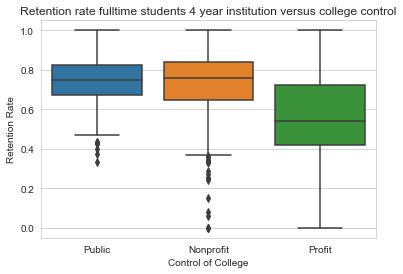

In [338]:
# outcome variable against control of college
sns.set_style("whitegrid")

control = df_ret_ft_4_num.CONTROL
control = control.astype('category')
control = control.cat.rename_categories(['Public',
                                         'Nonprofit',
                                         'Profit'])
retention = df_ret_ft_4_num.RET_FT4_POOLED

boxp = sns.boxplot(x=control, 
                   y=retention);
boxp.set(xlabel = 'Control of College', 
       ylabel = 'Retention Rate',
       title = 'Retention rate fulltime students 4 year institution versus college control');

In [339]:
# saving boxplot in an image
fig = boxp.get_figure()
fig.savefig("boxp_RTFT4CONTROL.png", dpi=900)

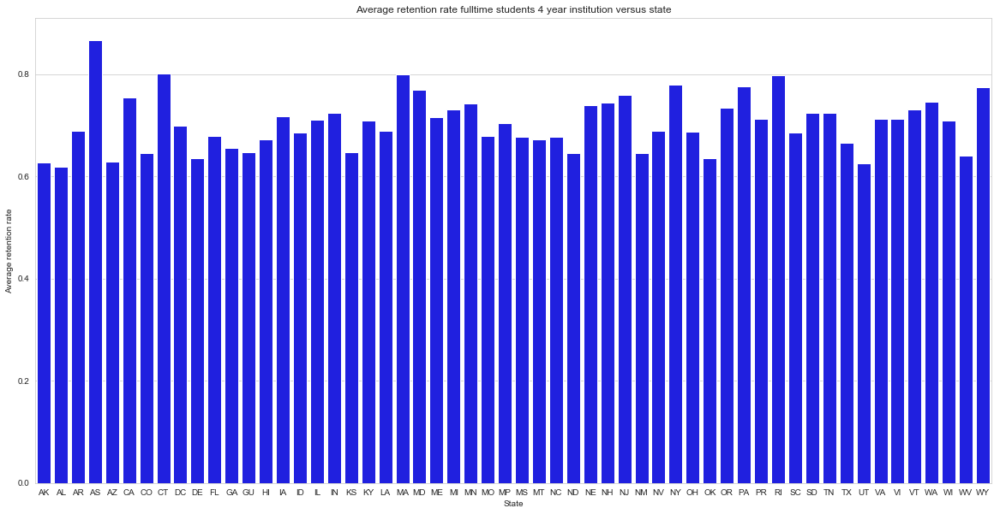

In [340]:
# outcome variable against state
sns.set_style("whitegrid")
plt.figure(figsize=(20,10))

grouped = df_ret_ft_4_num.groupby('STABBR')['RET_FT4_POOLED'].mean()
state = grouped.index
barp = sns.barplot(x=state, y=grouped, color='blue');
barp.set(xlabel = 'State', 
         ylabel = 'Average retention rate',
         title = 'Average retention rate fulltime students 4 year institution versus state');

In [341]:
# saving barplot in an image
fig = barp.get_figure()
fig.savefig("barp_RTFT4STATE.png", dpi=900)

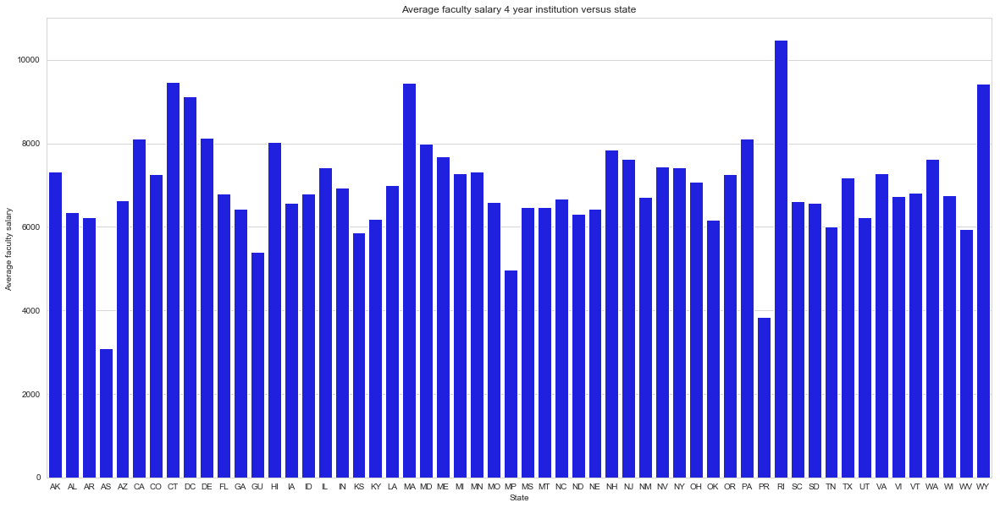

In [342]:
# average faculty salary against state
sns.set_style("whitegrid")
plt.figure(figsize=(20,10))

grouped = df_ret_ft_4_num.groupby('STABBR')['AVGFACSAL'].mean()
state = grouped.index
barp = sns.barplot(x=state, y=grouped, color='blue');
barp.set(xlabel = 'State', 
         ylabel = 'Average faculty salary ',
         title = 'Average faculty salary 4 year institution versus state');

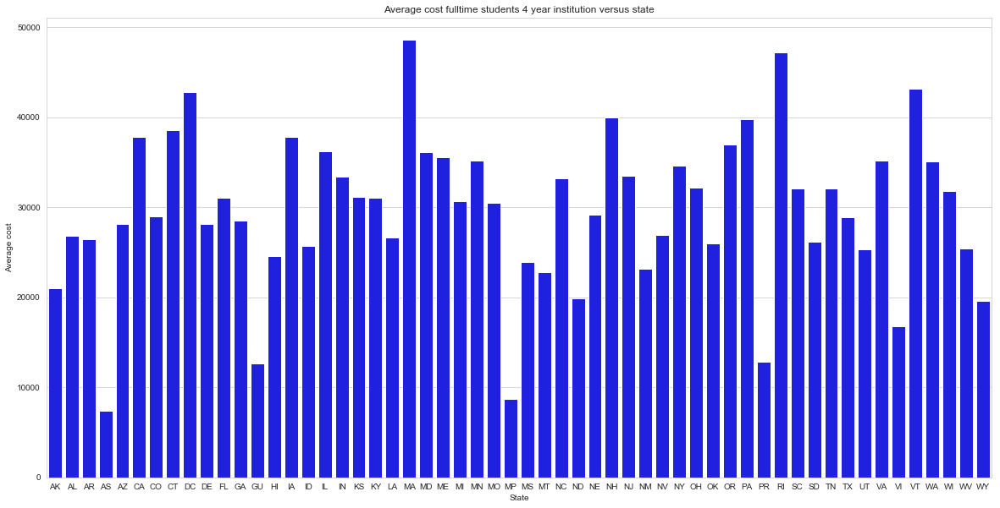

In [343]:
# average cost for students against state
sns.set_style("whitegrid")
plt.figure(figsize=(20,10))

grouped = df_ret_ft_4_num.groupby('STABBR')['COSTT4_A'].mean()
state = grouped.index
barp = sns.barplot(x=state, y=grouped, color='blue');
barp.set(xlabel = 'State', 
         ylabel = 'Average cost',
         title = 'Average cost fulltime students 4 year institution versus state');

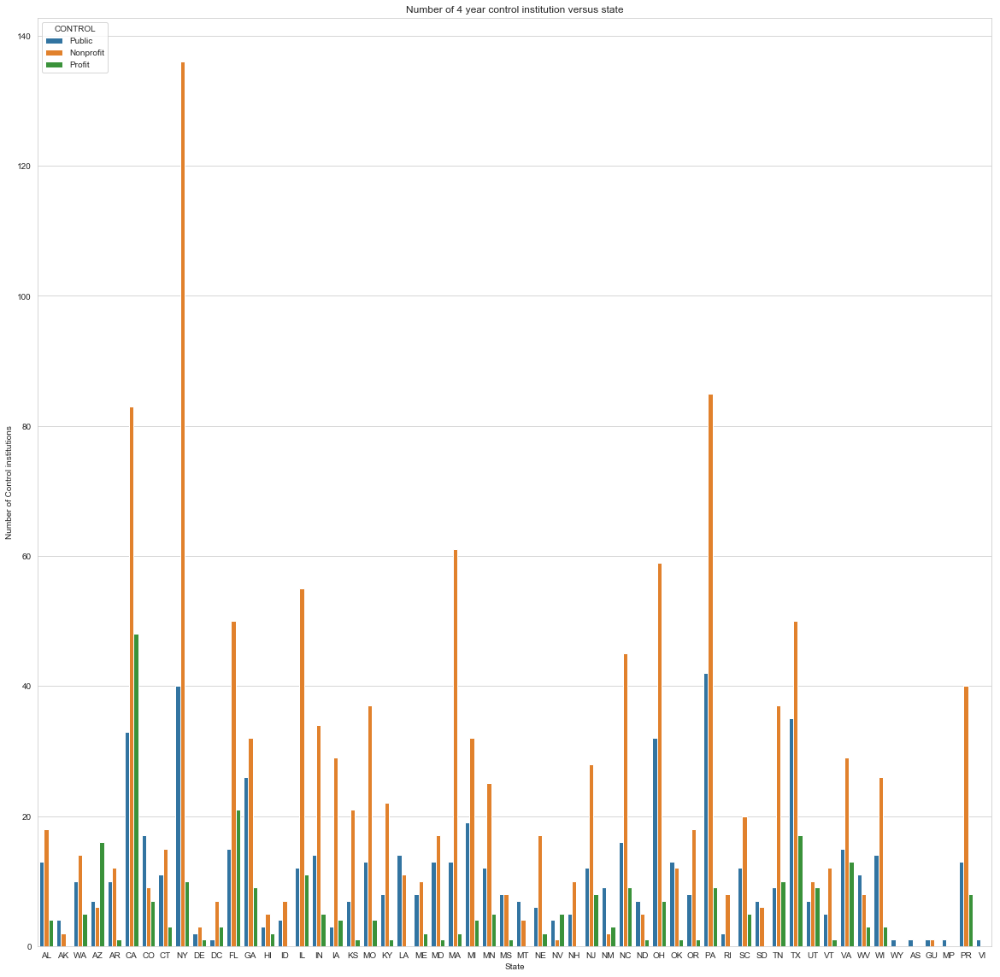

In [344]:
# control of college against state
sns.set_style("whitegrid")
plt.figure(figsize=(20,20))

count = df_ret_ft_4_num['CONTROL']
count = count.astype('category')
count = count.cat.rename_categories(['Public',
                                     'Nonprofit',
                                     'Profit'])
state = df_ret_ft_4_num['STABBR']
countp = sns.countplot(x=state, hue=count);
countp.set(xlabel = 'State', 
         ylabel = 'Number of Control institutions',
         title = 'Number of 4 year control institution versus state');

**Comment: In general higher retention rates for public and nonprofit colleges**

In [345]:
# saving countplot in an image
fig = countp.get_figure()
fig.savefig("countp_RTFT4STATECONTROL.png", dpi=900)

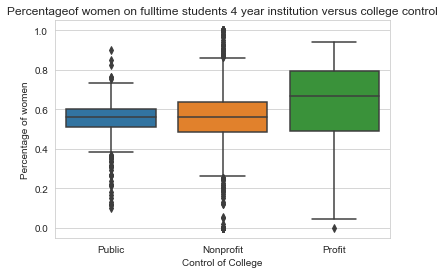

In [346]:
# percentage of women against control of college
sns.set_style("whitegrid")

control = df_ret_ft_4_num.CONTROL
control = control.astype('category')
control = control.cat.rename_categories(['Public',
                                         'Nonprofit',
                                         'Profit'])
women = df_ret_ft_4_num.UGDS_WOMEN

boxp1 = sns.boxplot(x=control, 
                    y=women);
boxp1.set(xlabel = 'Control of College', 
       ylabel = 'Percentage of women',
       title = 'Percentageof women on fulltime students 4 year institution versus college control');

In [347]:
# saving boxplot in an image
fig = boxp1.get_figure()
fig.savefig("boxp_RTFT4WOMENCONTROL.png", dpi=900)

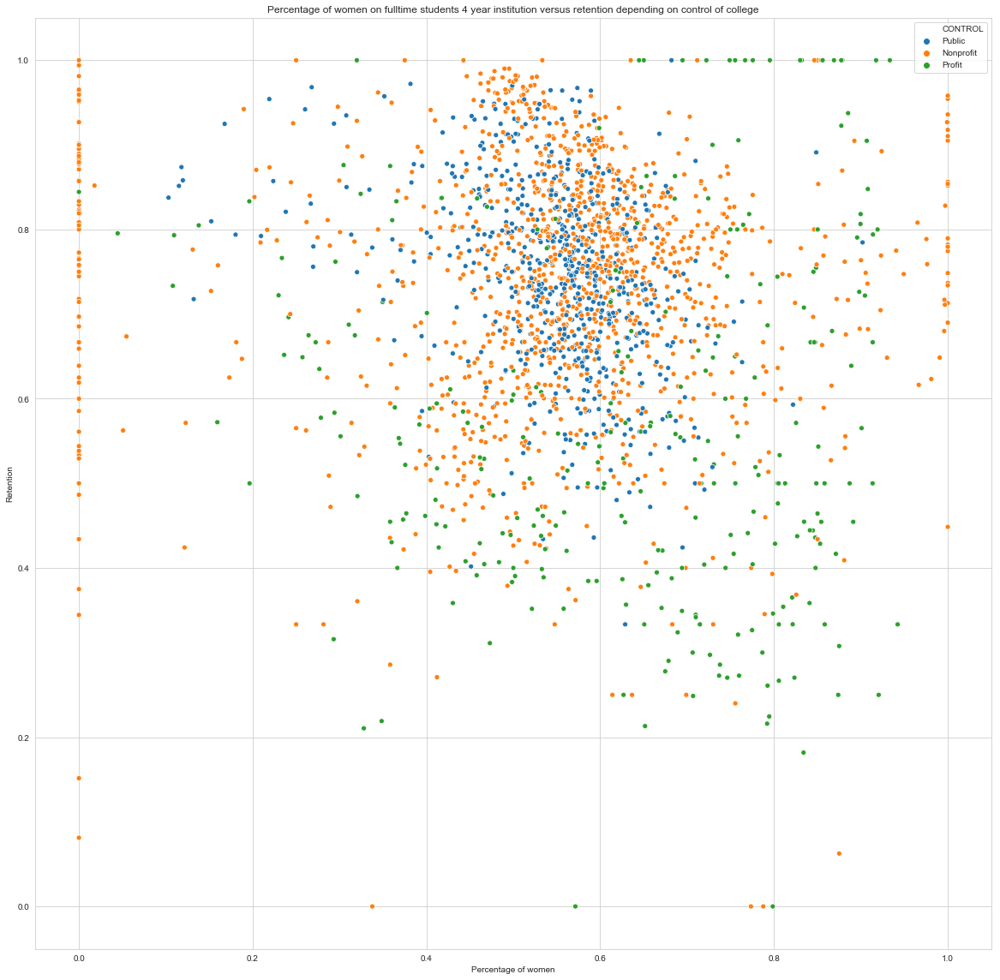

In [348]:
# percentage of women against retention depending on control of college
sns.set_style("whitegrid")
plt.figure(figsize=(20,20))
control = df_ret_ft_4_num.CONTROL
control = control.astype('category')
control = control.cat.rename_categories(['Public',
                                        'Nonprofit',
                                         'Profit'])
retention = df_ret_ft_4_num.RET_FT4_POOLED
women = df_ret_ft_4_num.UGDS_WOMEN

scrpl = sns.scatterplot(x=women, y=retention, hue=control);
scrpl.set(ylabel = 'Retention', 
          xlabel = 'Percentage of women',
         title = 'Percentage of women on fulltime students 4 year institution versus retention depending on control of college');

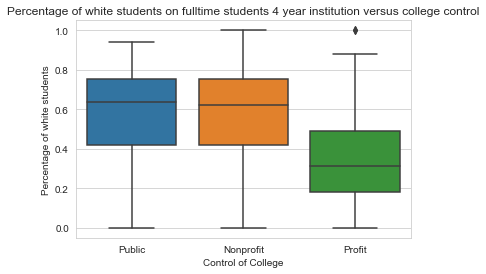

In [349]:
# percentage of white students against control of college
sns.set_style("whitegrid")

control = df_ret_ft_4_num.CONTROL
control = control.astype('category')
control = control.cat.rename_categories(['Public',
                                         'Nonprofit',
                                         'Profit'])
color = df_ret_ft_4_num.UGDS_WHITE

boxp1 = sns.boxplot(x=control, 
                    y=color);
boxp1.set(xlabel = 'Control of College', 
       ylabel = 'Percentage of white students',
       title = 'Percentage of white students on fulltime students 4 year institution versus college control');

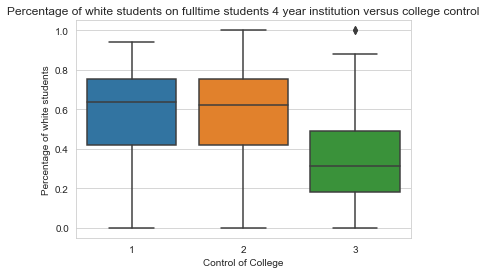

In [350]:
# percentage of white students against control of college
sns.set_style("whitegrid")

control = df_ret_ft_4_num.CONTROL
#control = control.astype('category')
#control = control.cat.rename_categories(['Public',
 #                                        'Nonprofit',
 #                                        'Profit'])
color = df_ret_ft_4_num.UGDS_WHITE

boxp4 = sns.boxplot(x=control, 
                    y=color);
boxp4.set(xlabel = 'Control of College', 
       ylabel = 'Percentage of white students',
       title = 'Percentage of white students on fulltime students 4 year institution versus college control');

In [351]:
df_data.iloc[:100,np.r_[3, 16]][df_data['CONTROL']==3]

/Applications/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


,INSTNM,CONTROL
13,South University-Montgomery,3
18,New Beginning College of Cosmetology,3
65,Charter College,3
66,Alaska Career College,3
67,Empire Beauty School-Tucson,3
69,American Institute of Trucking,3
70,Carrington College-Phoenix North,3
71,Carrington College-Mesa,3
72,Carrington College-Tucson,3
74,Arizona Academy of Beauty-East,3


In [352]:
# saving plot in an image
fig = boxp1.get_figure()
fig.savefig("boxp_RT4UGDSWHITECONTROL.png", dpi=900)

**Explore numerical variables**

In [353]:
# delete not needed columns
df_ret_ft_4_num = df_ret_ft_4_num.drop(['LATITUDE', 'LONGITUDE', 'CONTROL', 'STABBR'], axis=1)

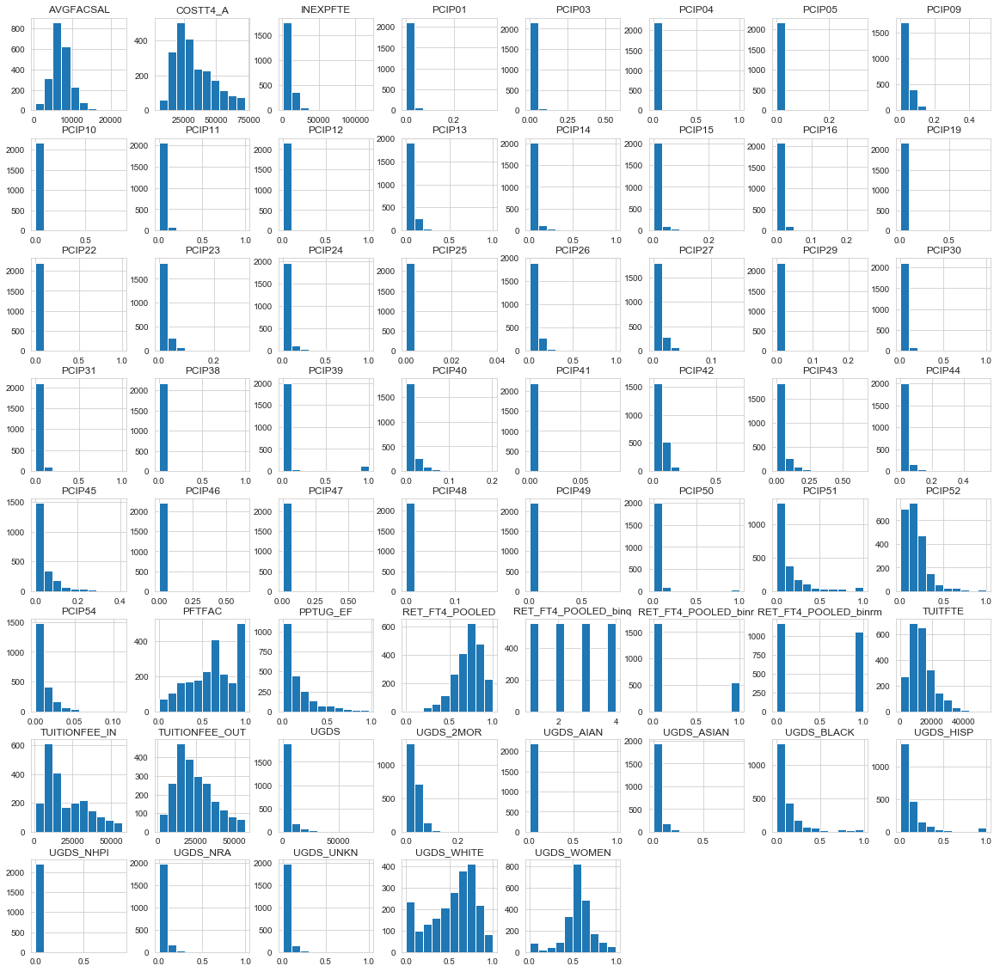

In [354]:
# check numerical data 
df_ret_ft_4_num.hist(figsize=(20,20));

**Comment:
Most of the numerical data are right skewed. The numerical outcome variable is left skewed. Therefore transform data to normal distribution.**

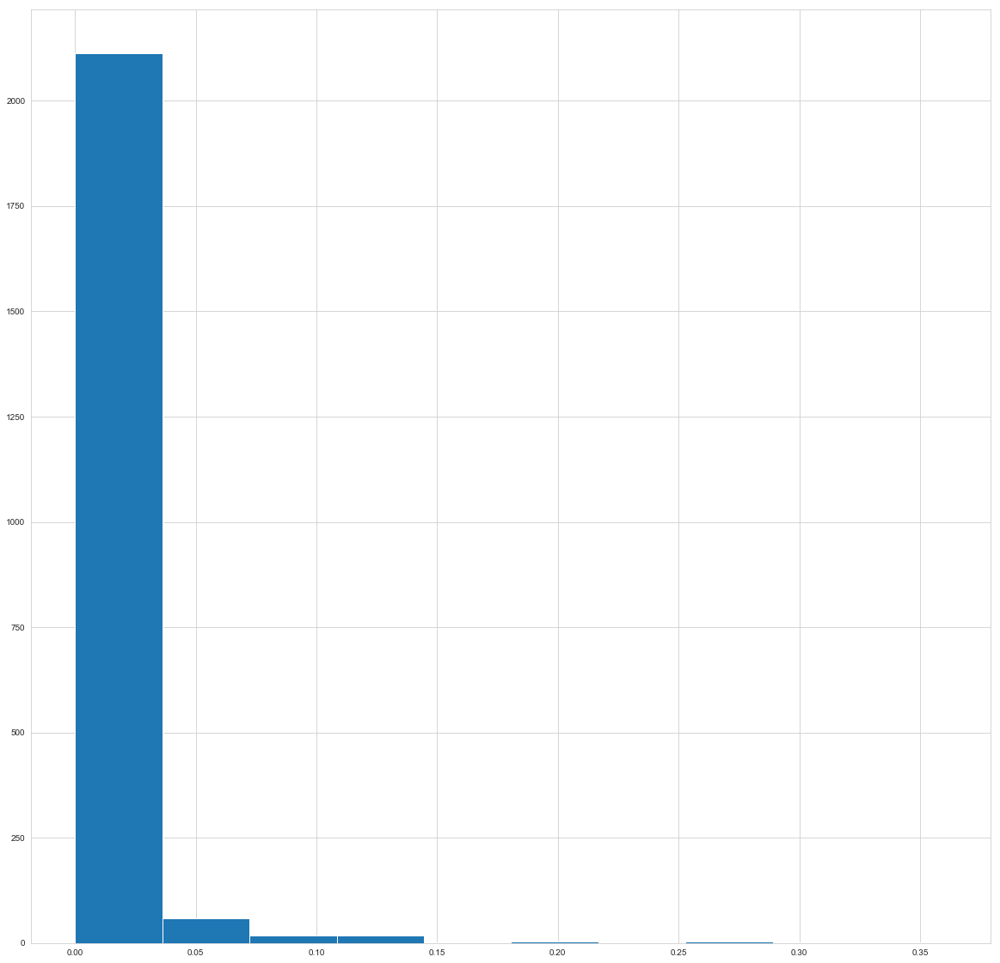

In [355]:
# check one PCIP variable in detail
df_ret_ft_4_num['PCIP01'].hist(figsize=(20,20));

In [356]:
# log transform data
df_ret_ft_4_num_log = np.log(1+df_ret_ft_4_num)

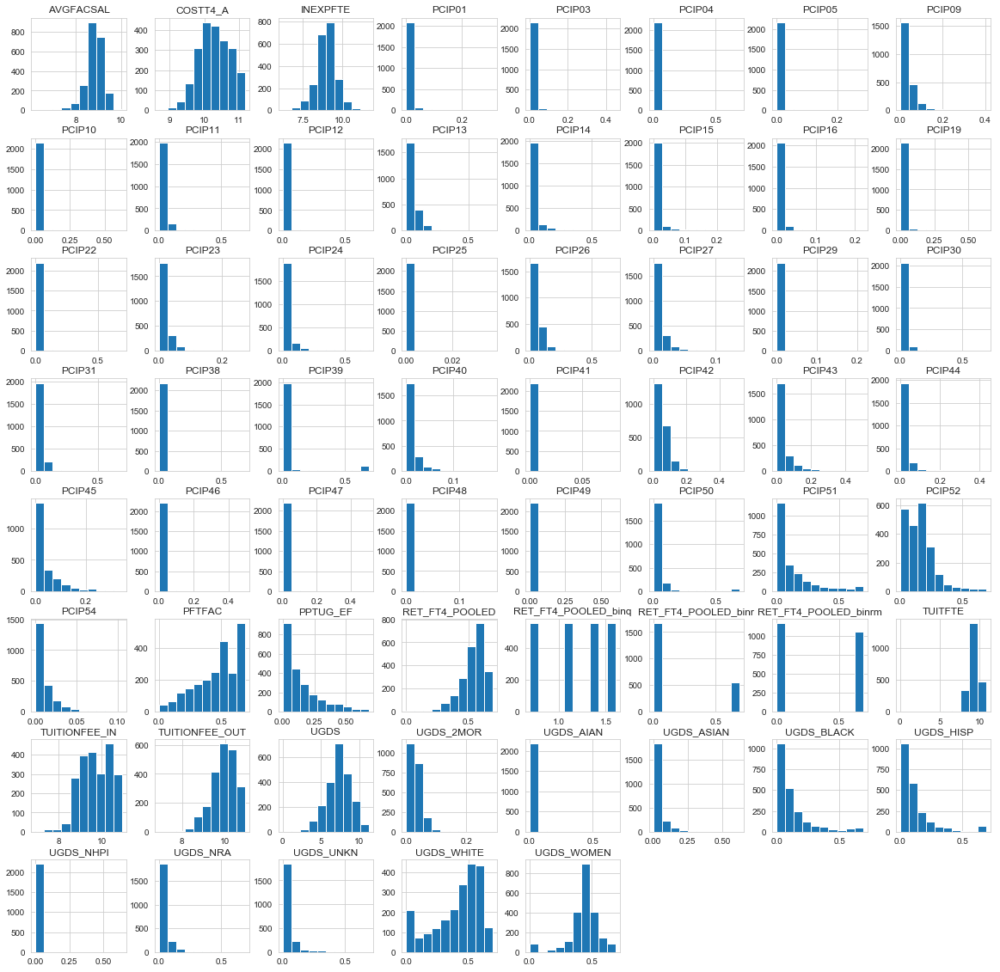

In [357]:
# check transformed data
df_ret_ft_4_num_log.hist(figsize=(20,20));

In [358]:
# transform data with cubic root
df_ret_ft_4_num_cbr = np.cbrt(df_ret_ft_4_num)

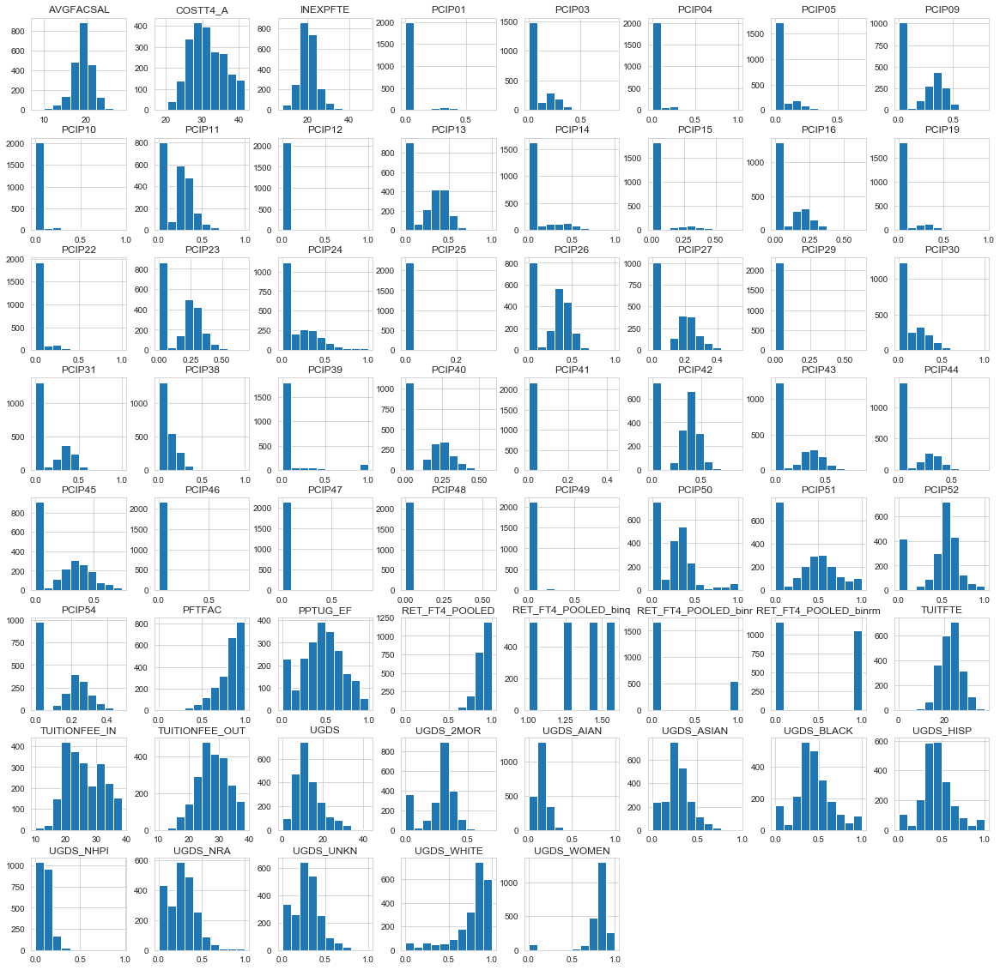

In [359]:
# check transformed data
df_ret_ft_4_num_cbr.hist(figsize=(20,20));

In [360]:
# transform data with square root
df_ret_ft_4_num_sqr = np.sqrt(df_ret_ft_4_num)

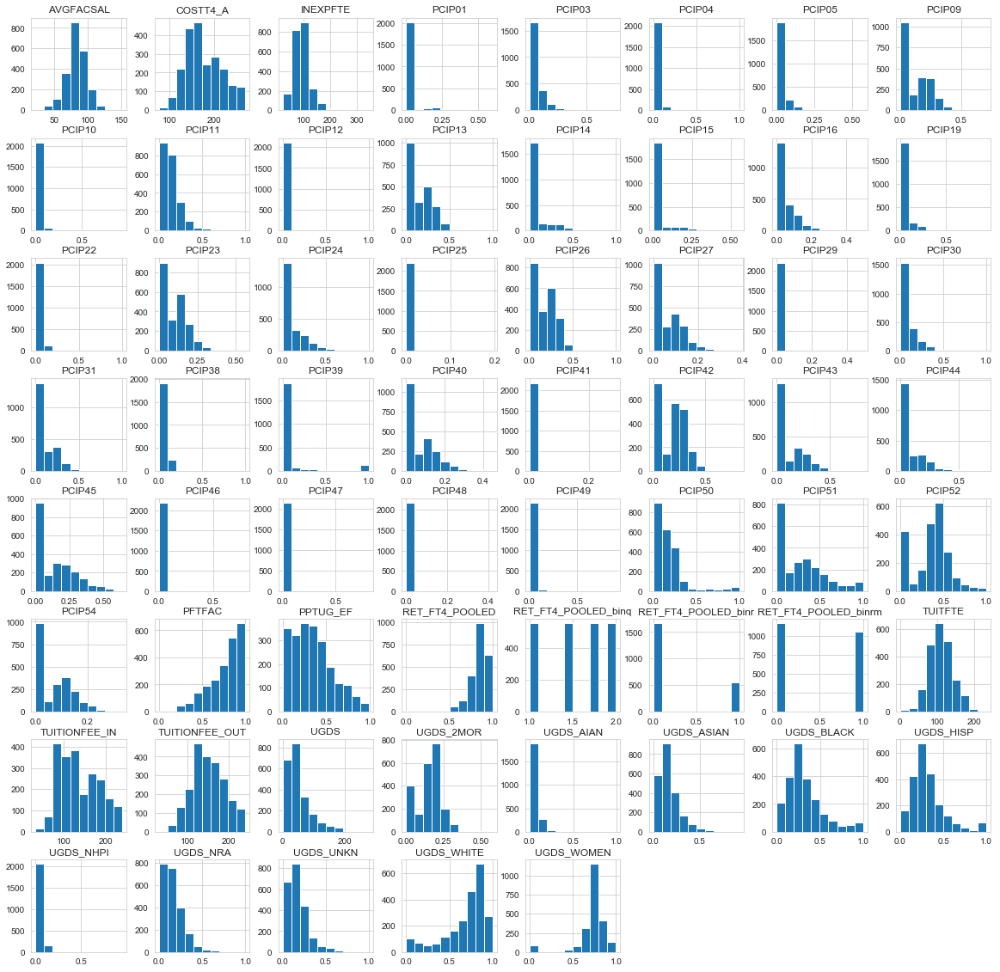

In [361]:
# check transformed data
df_ret_ft_4_num_sqr.hist(figsize=(20,20));

In [362]:
# square transform data
df_ret_ft_4_num_square = np.square(df_ret_ft_4_num)

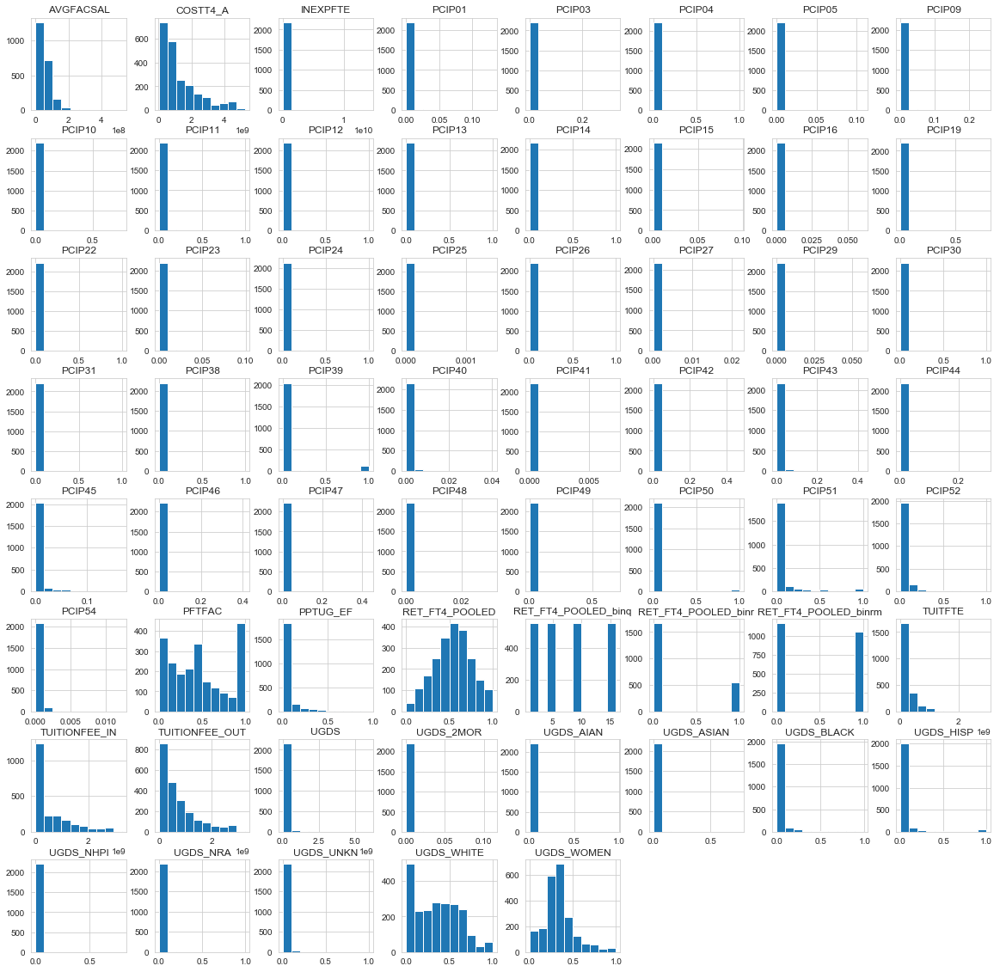

In [363]:
# check transformed data
df_ret_ft_4_num_square.hist(figsize=(20,20));

* cbr:AVGFACSAL, INEXPFTE, PCIP all, PPTUG_EF, TUITFTE,TUITIONFEE_IN, TUITIONFEE_OUT, UGDS_X all except White&WOMEN,
* square: RET_FT4_POOLED, UGDS_WHITE, PFTFAC
* log: COST4_A, UGDS
* no transformation: categorical variables, UGDS_WOMEN

In [364]:
# check column index
pd.Series(df_ret_ft_4_num.columns.values)[20:]

20                  PCIP30
21                  PCIP31
22                  PCIP38
23                  PCIP39
24                  PCIP40
25                  PCIP41
26                  PCIP42
27                  PCIP43
28                  PCIP44
29                  PCIP45
30                  PCIP46
31                  PCIP47
32                  PCIP48
33                  PCIP49
34                  PCIP50
35                  PCIP51
36                  PCIP52
37                  PCIP54
38                    UGDS
39              UGDS_WHITE
40              UGDS_BLACK
41               UGDS_HISP
42              UGDS_ASIAN
43               UGDS_AIAN
44               UGDS_NHPI
45               UGDS_2MOR
46                UGDS_NRA
47               UGDS_UNKN
48                PPTUG_EF
49                COSTT4_A
50           TUITIONFEE_IN
51          TUITIONFEE_OUT
52                 TUITFTE
53                INEXPFTE
54               AVGFACSAL
55                  PFTFAC
56              UGDS_WOMEN
5

In [365]:
# create df for transformations
df_ret_ft_4_num_transform = df_ret_ft_4_num.copy()

In [366]:
# cbrt transformation
df_ret_ft_4_num_transform.iloc[:, np.r_[:38, 40:49, 50:55 ]] = np.cbrt(df_ret_ft_4_num_transform.iloc[:, np.r_[:38, 40:49, 50:55 ]])

In [367]:
# square transformation
df_ret_ft_4_num_transform.iloc[:, np.r_[39, 55, 57 ]] = np.square(df_ret_ft_4_num_transform.iloc[:, np.r_[39, 55, 57 ]])

In [368]:
# log transformation
df_ret_ft_4_num_transform.iloc[:, np.r_[38, 49]] = np.log(1+df_ret_ft_4_num_transform.iloc[:, np.r_[38, 49]])

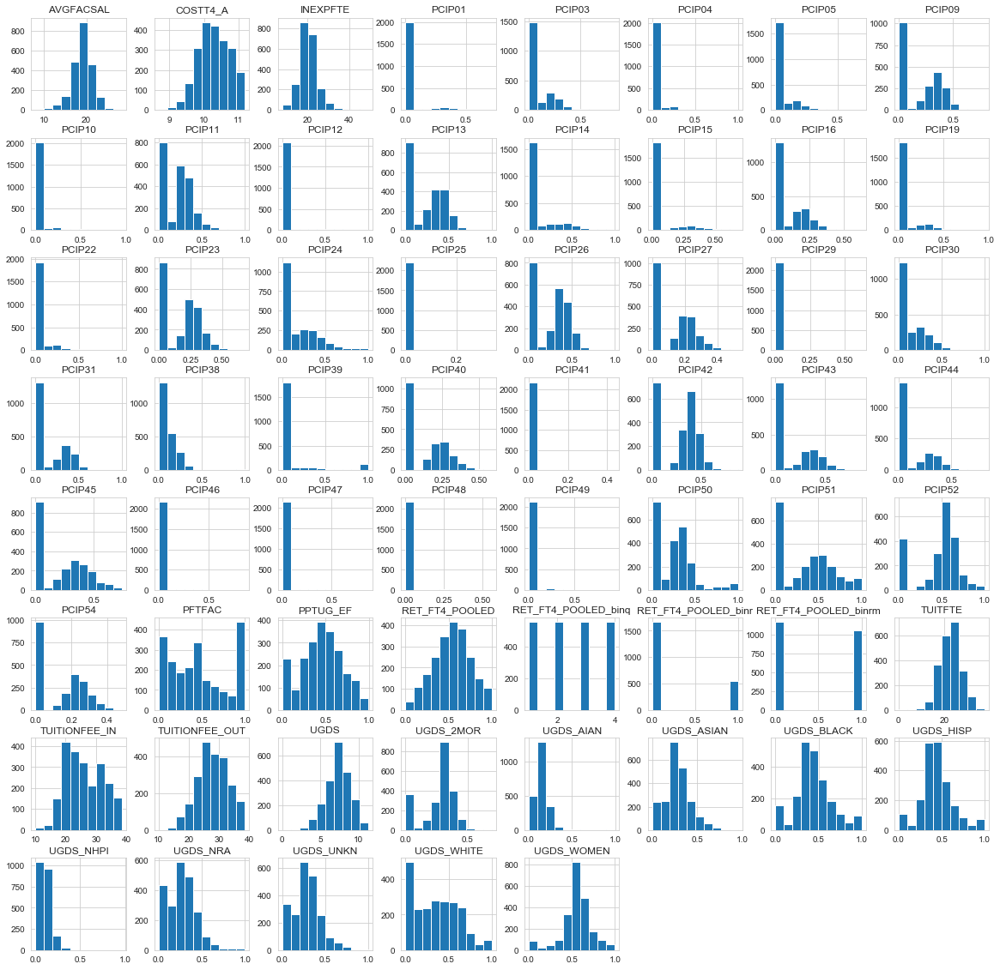

In [369]:
# check transformed df
df_ret_ft_4_num_transform.hist(figsize=(20,20));

In [370]:
# save transformed df
df_ret_ft_4_num_transform.to_csv('df_ret_ft_4_num_transform.csv', index=False)

In [6]:
# read transformed df
df_ret_ft_4_num_transform = pd.read_csv('df_ret_ft_4_num_transform.csv')

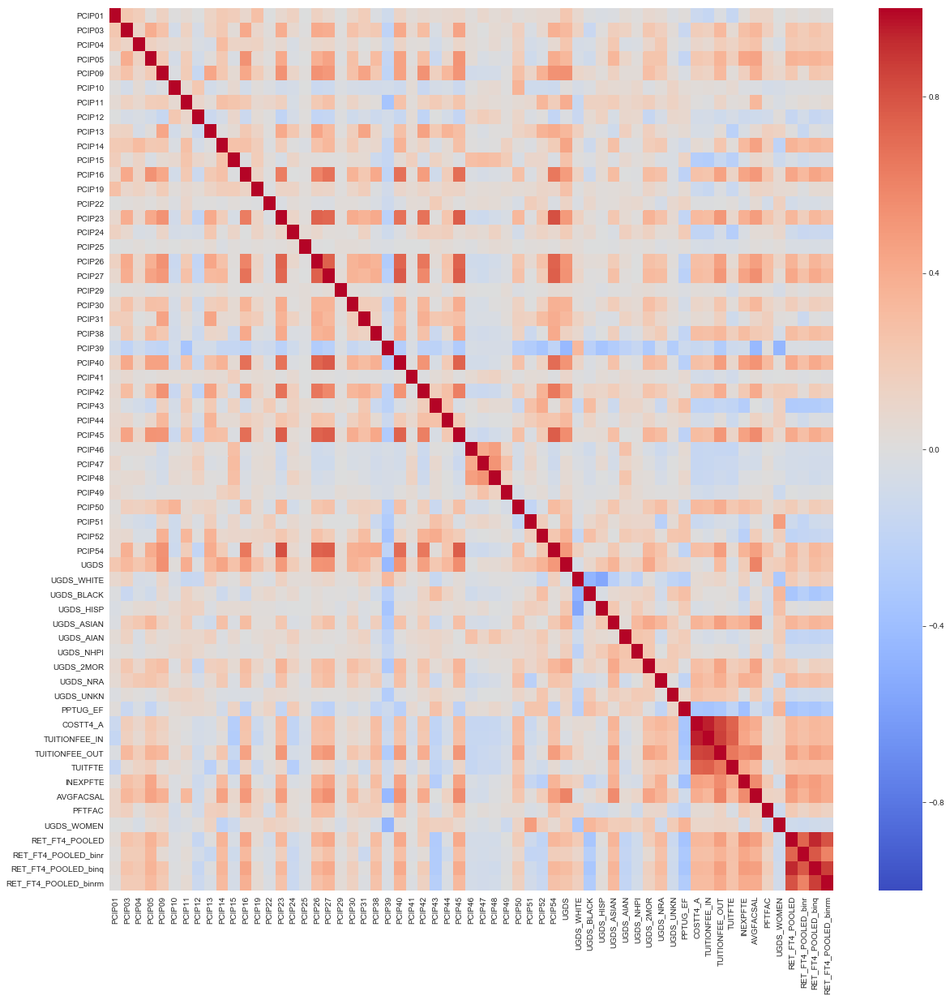

In [372]:
# explore correlation between numerical output and numerical input
plt.figure(figsize=(20,20))
sns.heatmap(df_ret_ft_4_num_transform.corr(), annot=False, vmax=1, vmin=-1, center=0, cmap='coolwarm');

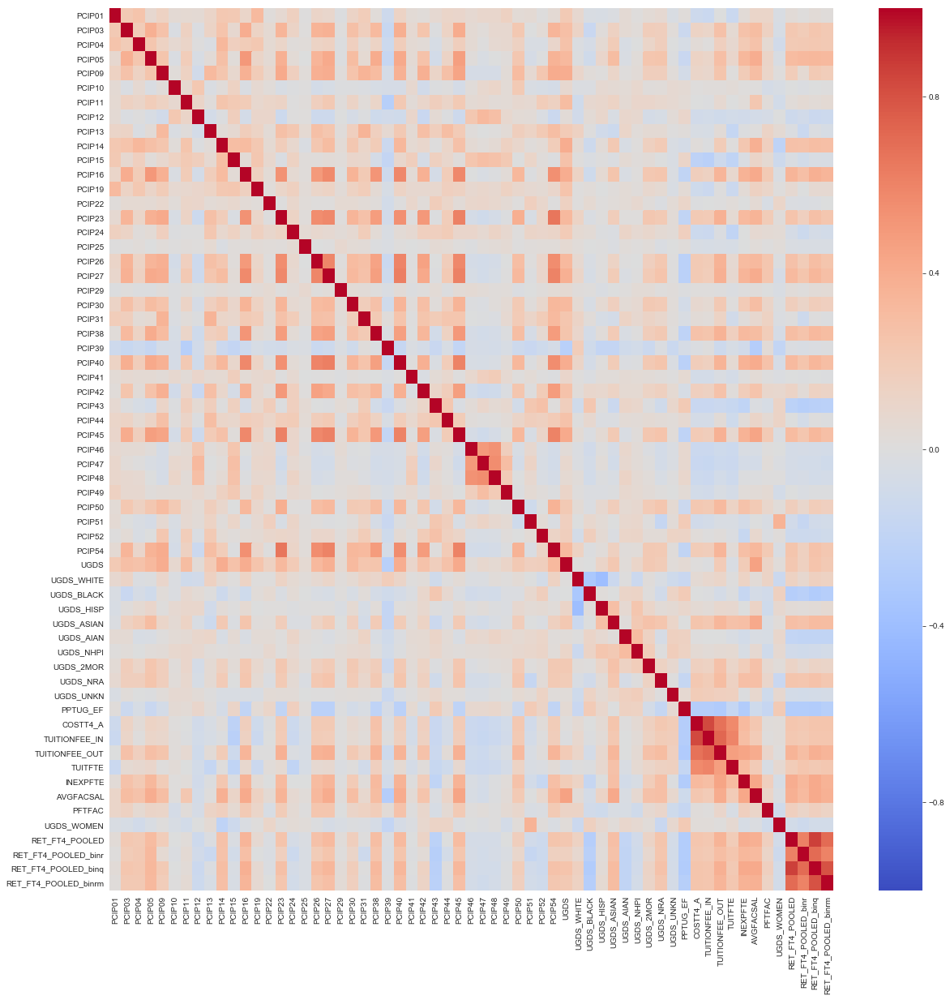

In [373]:
# explore correlation between categorical output and numerical input
plt.figure(figsize=(20,20))
sns.heatmap(df_ret_ft_4_num_transform.corr(method='kendall'), annot=False, vmax=1, vmin=-1, center=0, cmap='coolwarm');

In [374]:
# create subset for scatterplott
df_subset = df_ret_ft_4_num_transform[df_ret_ft_4_num_transform.columns.drop(list(df_ret_ft_4_num.filter(regex='PCIP')))] 

In [375]:
# create subset for scatterplott
df_subset = df_subset.drop(['RET_FT4_POOLED_binr', 'RET_FT4_POOLED_binq', 'RET_FT4_POOLED_binrm'], axis=1)

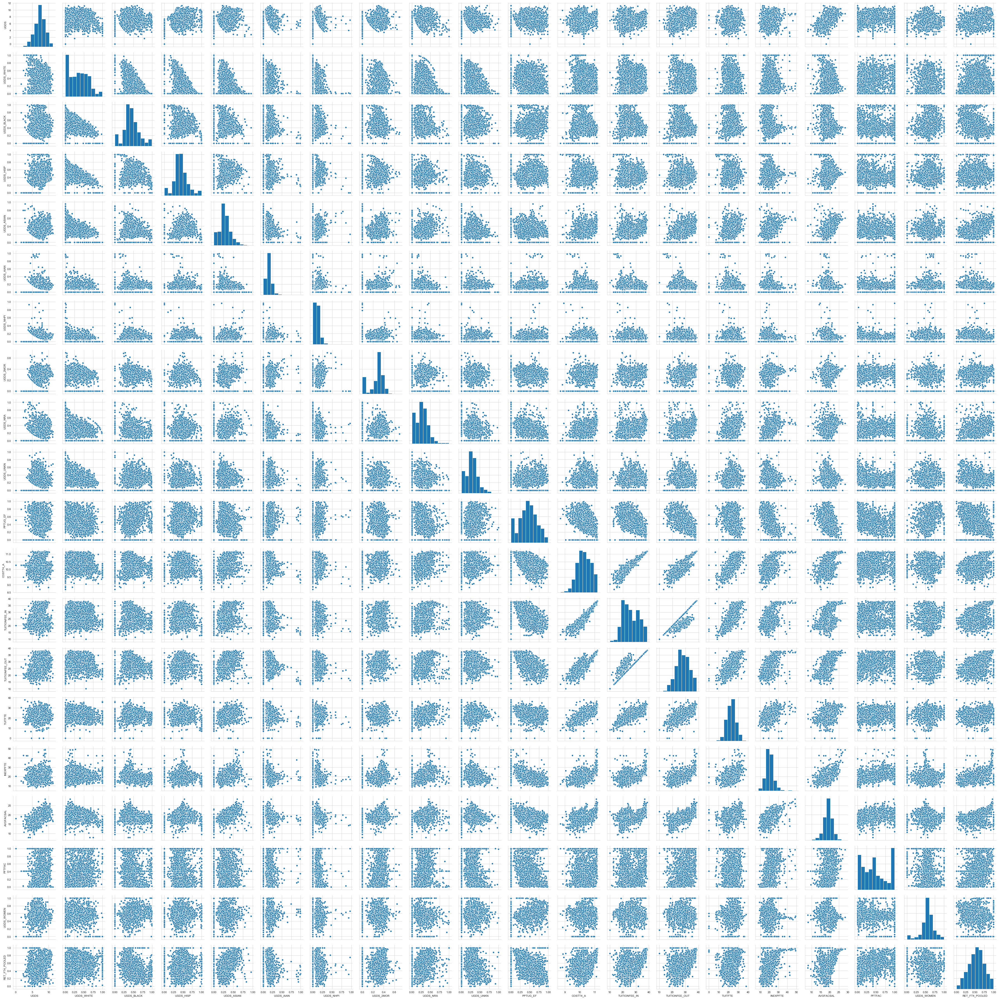

In [376]:
# check for nonlinear relationships
sns.pairplot(df_subset);

**Comment: No nonlinear relationship**

In [377]:
# print correlations between num variables
corr_columns = []
corr_target = []
col_names = df_ret_ft_4_num_transform.corr().columns.values
for col, row in (df_ret_ft_4_num_transform.corr().abs() > 0.5).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PCIP01 ['PCIP01']
PCIP03 ['PCIP03']
PCIP04 ['PCIP04']
PCIP05 ['PCIP05' 'PCIP16' 'PCIP45']
PCIP09 ['PCIP09' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP42' 'PCIP45' 'PCIP54' 'UGDS']
PCIP10 ['PCIP10']
PCIP11 ['PCIP11']
PCIP12 ['PCIP12']
PCIP13 ['PCIP13']
PCIP14 ['PCIP14']
PCIP15 ['PCIP15']
PCIP16 ['PCIP05' 'PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP45' 'PCIP54'
 'AVGFACSAL']
PCIP19 ['PCIP19']
PCIP22 ['PCIP22']
PCIP23 ['PCIP09' 'PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45'
 'PCIP54' 'TUITIONFEE_OUT']
PCIP24 ['PCIP24']
PCIP25 ['PCIP25']
PCIP26 ['PCIP09' 'PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45'
 'PCIP54' 'UGDS']
PCIP27 ['PCIP09' 'PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45'
 'PCIP54' 'UGDS' 'TUITIONFEE_OUT' 'AVGFACSAL']
PCIP29 ['PCIP29']
PCIP30 ['PCIP30']
PCIP31 ['PCIP31']
PCIP38 ['PCIP38']
PCIP39 ['PCIP39']
PCIP40 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54'
 'UGDS' 'AVGFACSAL']
PCIP41 ['PCIP41']
PCIP42 ['PCIP09

In [38]:
corr_target



NameError: name 'corr_target' is not defined

In [104]:
#flat_list1 = [item for sublist in corr_target for item in sublist]



In [121]:
# flat_list = [item for sublist in corr_columns for item in sublist if item not in ['RET_FT4_POOLED','RET_FT4_POOLED_binr']]



In [92]:
#flat_set1 = set(flat_list)



In [122]:
#flat_set = set(flat_list)



In [125]:
#flat_set



In [126]:
#flat_set1



In [96]:
#df_ret_ft_4_num_transform1 = df_ret_ft_4_num_transform.drop(flat_set1, axis=1)



In [127]:
#df_ret_ft_4_num_transform1.info()



### 4.1.2) Explore categorical variables

In [378]:
# transform numerical output for categorical feature df
df_ret_ft_4_cat['RET_FT4_POOLED'] = np.square(df_ret_ft_4_cat['RET_FT4_POOLED'])

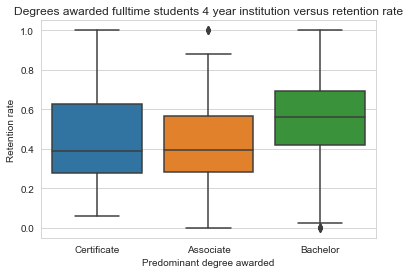

In [379]:
# outcome variable against PREDDEG of college
sns.set_style("whitegrid")

preddeg = df_ret_ft_4_cat.PREDDEG
preddeg = preddeg.astype('category')
preddeg = preddeg.cat.rename_categories([
                                         'Certificate',
                                         'Associate',
                                         'Bachelor'])
retention = df_ret_ft_4_cat.RET_FT4_POOLED

boxp2 = sns.boxplot(x=preddeg, 
                    y=retention);
boxp2.set(xlabel = 'Predominant degree awarded', 
          ylabel = 'Retention rate',
          title = 'Degrees awarded fulltime students 4 year institution versus retention rate');

In [380]:
# saving boxplot in an image
fig = boxp2.get_figure()
fig.savefig("boxp_RTFT4PREDDEG.png", dpi=900)

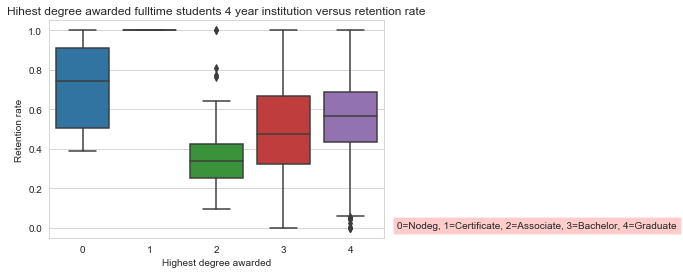

In [381]:
# outcome variables against HIGHDEG of college
sns.set_style("whitegrid")
ax = plt.subplot(111)
highdeg = df_ret_ft_4_cat.HIGHDEG
ax.text(4.7, 0, '0=Nodeg, 1=Certificate, 2=Associate, 3=Bachelor, 4=Graduate', bbox=dict(facecolor='red', alpha=0.2))
retention = df_ret_ft_4_cat.RET_FT4_POOLED

boxp3 = sns.boxplot(x=highdeg, 
                    y=retention);
boxp3.set(xlabel = 'Highest degree awarded', 
          ylabel = 'Retention rate',
          title =  'Hihest degree awarded fulltime students 4 year institution versus retention rate');

In [382]:
# saving plot in an image
fig = boxp3.get_figure()
fig.savefig("boxp_RTFT4HIGHDEG.png", dpi=900)

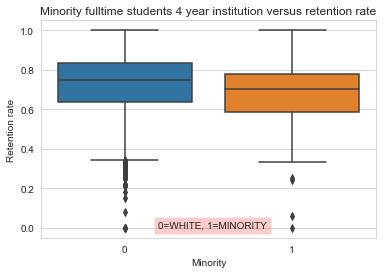

In [164]:
# outcome variable against MINORITY 
sns.set_style("whitegrid")
ax = plt.subplot(111)
minority = df_ret_ft_4_cat.MINORITY

ax.text(0.2, 0, '0=WHITE, 1=MINORITY', bbox=dict(facecolor='red', alpha=0.2))
retention = df_ret_ft_4_cat.RET_FT4_POOLED

boxp3 = sns.boxplot(x=minority, 
                    y=retention);
boxp3.set(xlabel = 'Minority', 
          ylabel = 'Retention rate',
          title = 'Minority fulltime students 4 year institution versus retention rate');

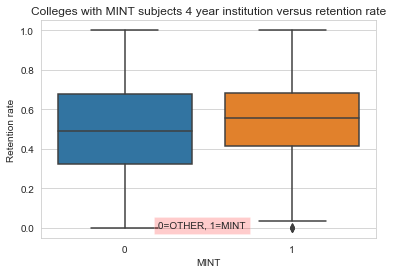

In [383]:
# outcome variable against MINT 
sns.set_style("whitegrid")
ax = plt.subplot(111)
mint = df_ret_ft_4_cat.MINT_binr
ax.text(0.2, 0, '0=OTHER, 1=MINT', bbox=dict(facecolor='red', alpha=0.2))
retention = df_ret_ft_4_cat.RET_FT4_POOLED

boxp4 = sns.boxplot(x=mint, 
                    y=retention);
boxp4.set(xlabel = 'MINT', 
          ylabel = 'Retention rate',
          title = 'Colleges with MINT subjects 4 year institution versus retention rate');

In [384]:
# print correlations between cat variables
corr_columns = []
corr_target = []
col_names = df_ret_ft_4_cat.corr(method='kendall').columns.values
for col, row in (df_ret_ft_4_cat.corr(method='kendall').abs() > 0.5).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PREDDEG_2 ['PREDDEG_2' 'PREDDEG_3' 'PREDDEG']
PREDDEG_3 ['PREDDEG_2' 'PREDDEG_3' 'PREDDEG']
PREDDEG_4 ['PREDDEG_4']
HIGHDEG_1 ['HIGHDEG_1']
HIGHDEG_2 ['HIGHDEG_2']
HIGHDEG_3 ['HIGHDEG_3' 'HIGHDEG_4' 'HIGHDEG']
HIGHDEG_4 ['HIGHDEG_3' 'HIGHDEG_4' 'HIGHDEG']
CONTROL_2 ['CONTROL_2' 'COSTT4_A_binq' 'TUITIONFEE_IN_binq']
CONTROL_3 ['CONTROL_3' 'CONTROL']
PREDDEG ['PREDDEG_2' 'PREDDEG_3' 'PREDDEG']
HIGHDEG ['HIGHDEG_3' 'HIGHDEG_4' 'HIGHDEG']
CONTROL ['CONTROL_3' 'CONTROL']
CIP01CERT1 ['CIP01CERT1']
CIP01CERT2 ['CIP01CERT2']
CIP01ASSOC ['CIP01ASSOC']
CIP01CERT4 ['CIP01CERT4' 'CIP27CERT4' 'CIP42CERT4']
CIP01BACHL ['CIP01BACHL' 'PCIP01_binr' 'CIP01_ord1']
CIP03CERT1 ['CIP03CERT1']
CIP03CERT2 ['CIP03CERT2']
CIP03ASSOC ['CIP03ASSOC']
CIP03CERT4 ['CIP03CERT4']
CIP03BACHL ['CIP03BACHL' 'PCIP03_binr' 'PCIP45_binr' 'CIP03_ord1']
CIP04CERT1 ['CIP04CERT1']
CIP04CERT2 ['CIP04CERT2']
CIP04ASSOC ['CIP04ASSOC']
CIP04CERT4 ['CIP04CERT4']
CIP04BACHL ['CIP04BACHL' 'PCIP04_binr' 'CIP04_ord1']
CIP05CERT1 ['CIP05

In [385]:
# print correlations between cat variables
corr_columns = []
corr_target = []
col_names = df_ret_ft_4_cat.corr().columns.values
for col, row in (df_ret_ft_4_cat.corr().abs() > 0.5).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PREDDEG_2 ['PREDDEG_2' 'PREDDEG_3' 'PREDDEG']
PREDDEG_3 ['PREDDEG_2' 'PREDDEG_3' 'PREDDEG']
PREDDEG_4 []
HIGHDEG_1 ['HIGHDEG_1']
HIGHDEG_2 ['HIGHDEG_2']
HIGHDEG_3 ['HIGHDEG_3' 'HIGHDEG_4' 'HIGHDEG']
HIGHDEG_4 ['HIGHDEG_3' 'HIGHDEG_4' 'HIGHDEG']
CONTROL_2 ['CONTROL_2' 'COSTT4_A_binq' 'TUITIONFEE_IN_binq']
CONTROL_3 ['CONTROL_3' 'CONTROL']
PREDDEG ['PREDDEG_2' 'PREDDEG_3' 'PREDDEG']
HIGHDEG ['HIGHDEG_3' 'HIGHDEG_4' 'HIGHDEG']
CONTROL ['CONTROL_3' 'CONTROL']
CIP01CERT1 ['CIP01CERT1']
CIP01CERT2 ['CIP01CERT2']
CIP01ASSOC ['CIP01ASSOC']
CIP01CERT4 ['CIP01CERT4' 'CIP27CERT4' 'CIP42CERT4']
CIP01BACHL ['CIP01BACHL' 'PCIP01_binr' 'CIP01_ord1']
CIP03CERT1 ['CIP03CERT1']
CIP03CERT2 ['CIP03CERT2']
CIP03ASSOC ['CIP03ASSOC']
CIP03CERT4 []
CIP03BACHL ['CIP03BACHL' 'PCIP03_binr' 'PCIP45_binr' 'CIP03_ord1']
CIP04CERT1 ['CIP04CERT1']
CIP04CERT2 ['CIP04CERT2']
CIP04ASSOC ['CIP04ASSOC']
CIP04CERT4 ['CIP04CERT4']
CIP04BACHL ['CIP04BACHL' 'PCIP04_binr' 'CIP04_ord1']
CIP05CERT1 ['CIP05CERT1']
CIP05CERT2 ['CI

In [386]:
# print correlations between cat variables
corr_columns = []
corr_target = []
col_names = df_ret_ft_4_cat.corr(method='spearman').columns.values
for col, row in (df_ret_ft_4_cat.corr(method='spearman').abs() > 0.5).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PREDDEG_2 ['PREDDEG_2' 'PREDDEG_3' 'PREDDEG']
PREDDEG_3 ['PREDDEG_2' 'PREDDEG_3' 'PREDDEG']
PREDDEG_4 []
HIGHDEG_1 ['HIGHDEG_1']
HIGHDEG_2 ['HIGHDEG_2']
HIGHDEG_3 ['HIGHDEG_3' 'HIGHDEG_4' 'HIGHDEG']
HIGHDEG_4 ['HIGHDEG_3' 'HIGHDEG_4' 'HIGHDEG']
CONTROL_2 ['CONTROL_2' 'COSTT4_A_binq' 'TUITIONFEE_IN_binq']
CONTROL_3 ['CONTROL_3' 'CONTROL']
PREDDEG ['PREDDEG_2' 'PREDDEG_3' 'PREDDEG']
HIGHDEG ['HIGHDEG_3' 'HIGHDEG_4' 'HIGHDEG']
CONTROL ['CONTROL_3' 'CONTROL']
CIP01CERT1 ['CIP01CERT1']
CIP01CERT2 ['CIP01CERT2']
CIP01ASSOC ['CIP01ASSOC']
CIP01CERT4 ['CIP01CERT4' 'CIP27CERT4' 'CIP42CERT4']
CIP01BACHL ['CIP01BACHL' 'PCIP01_binr' 'CIP01_ord1']
CIP03CERT1 ['CIP03CERT1']
CIP03CERT2 ['CIP03CERT2']
CIP03ASSOC ['CIP03ASSOC']
CIP03CERT4 []
CIP03BACHL ['CIP03BACHL' 'PCIP03_binr' 'PCIP45_binr' 'CIP03_ord1']
CIP04CERT1 ['CIP04CERT1']
CIP04CERT2 ['CIP04CERT2']
CIP04ASSOC ['CIP04ASSOC']
CIP04CERT4 ['CIP04CERT4']
CIP04BACHL ['CIP04BACHL' 'PCIP04_binr' 'CIP04_ord1']
CIP05CERT1 ['CIP05CERT1']
CIP05CERT2 ['CI

**Comment: None of the cat variables seem to have correlation to the target variables but lots of correlations between themselves.**

In [387]:
# delete not needed columns
df_ret_ft_4_cat = df_ret_ft_4_cat.drop(['PREDDEG', 'HIGHDEG', 'CONTROL', ], axis=1)

In [388]:
# save categorical df
df_ret_ft_4_cat.to_csv('df_ret_ft_4_cat_1.csv', index=False)

In [7]:
# read categorical df
df_ret_ft_4_cat = pd.read_csv('df_ret_ft_4_cat_1.csv')

## 4.2) Explore OMAWDP6_FTFT_POOLED df

### 4.2.1) Explore numerical variables

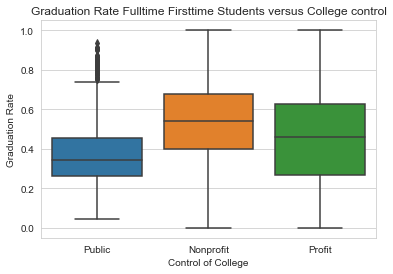

In [390]:
# outcome variable against CONTROL of college
sns.set_style("whitegrid")

control = df_oma_ftft_num.CONTROL
control = control.astype('category')
control = control.cat.rename_categories(['Public',
                                         'Nonprofit',
                                         'Profit'])
award = df_oma_ftft_num.OMAWDP6_FTFT_POOLED

boxp = sns.boxplot(x=control, 
                   y=award);
boxp.set(xlabel = 'Control of College', 
       ylabel = 'Graduation Rate',
       title = 'Graduation Rate Fulltime Firsttime Students versus College control');

In [391]:
# saving boxplot in an image
fig = boxp.get_figure()
fig.savefig("boxp_OMAFTFTCONTROL.png", dpi=900)

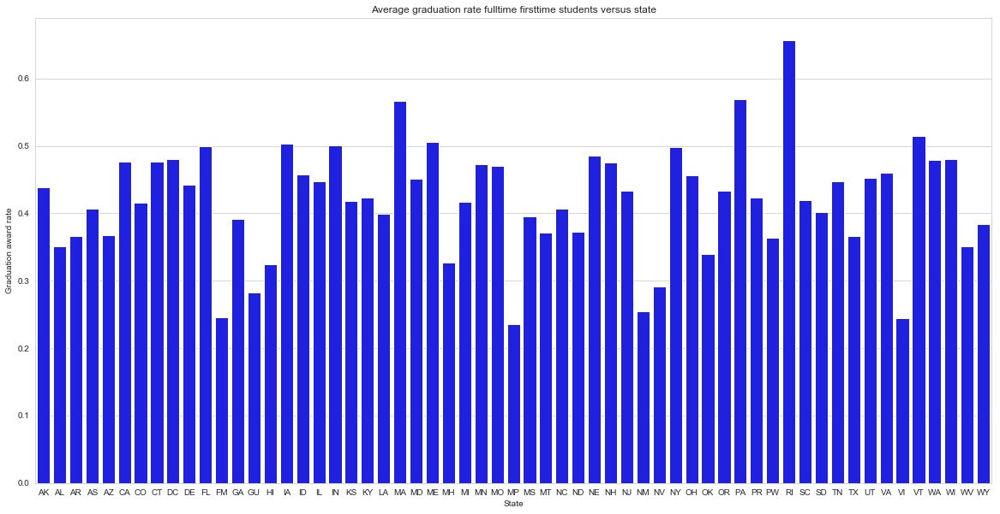

In [392]:
# outcome variable against state
sns.set_style("whitegrid")
plt.figure(figsize=(20,10))

grouped = df_oma_ftft_num.groupby('STABBR')['OMAWDP6_FTFT_POOLED'].mean()
state = grouped.index
barp = sns.barplot(x=state, y=grouped, color='blue');
barp.set(xlabel = 'State', 
         ylabel = 'Graduation award rate',
         title = 'Average graduation rate fulltime firsttime students versus state');

In [393]:
# saving barplot in an image
fig = barp.get_figure()
fig.savefig("barp_OMASTATE.png", dpi=900)

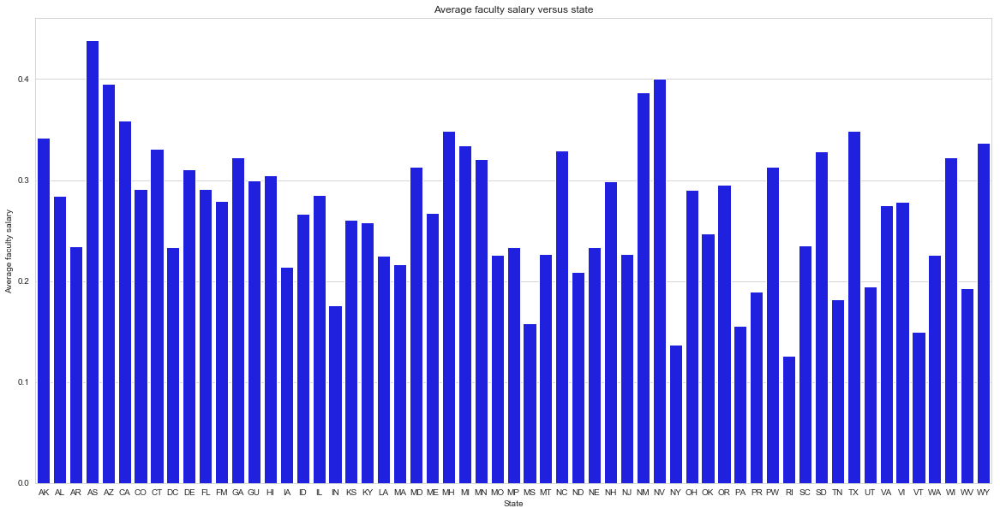

In [394]:
# average faculty salary against state
sns.set_style("whitegrid")
plt.figure(figsize=(20,10))

grouped = df_oma_ftft_num.groupby('STABBR')['PPTUG_EF'].mean()
state = grouped.index
barp = sns.barplot(x=state, y=grouped, color='blue');
barp.set(xlabel = 'State', 
         ylabel = 'Average faculty salary',
         title = 'Average faculty salary versus state');

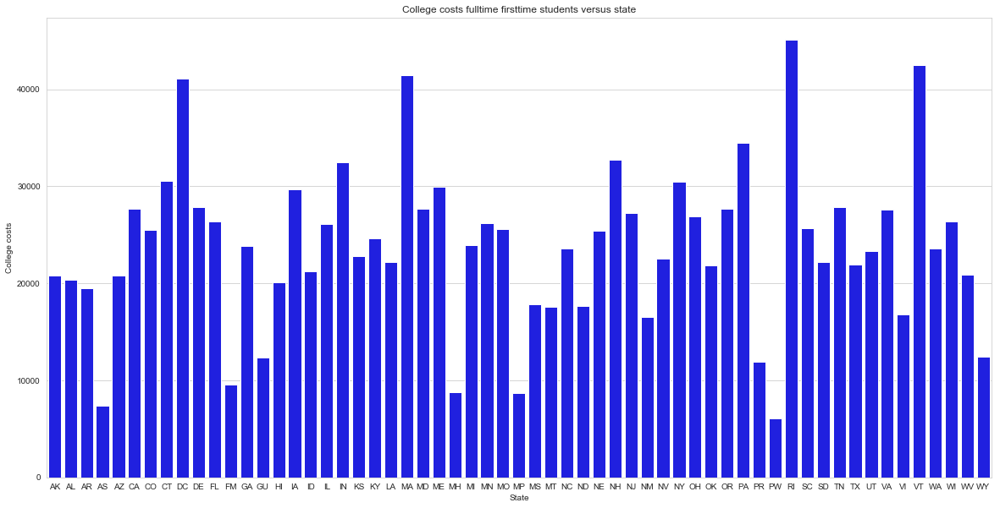

In [395]:
# costs for students against state
sns.set_style("whitegrid")
plt.figure(figsize=(20,10))

grouped = df_oma_ftft_num.groupby('STABBR')['COSTT4_A'].mean()
state = grouped.index
barp = sns.barplot(x=state, y=grouped, color='blue');
barp.set(xlabel = 'State', 
         ylabel = 'College costs',
         title = 'College costs fulltime firsttime students versus state');

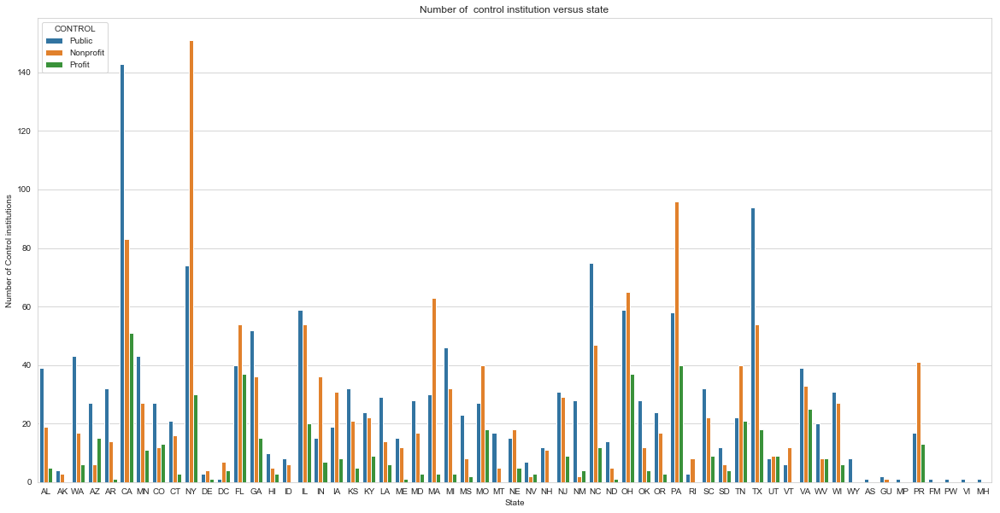

In [396]:
# CONTROL against state
sns.set_style("whitegrid")
plt.figure(figsize=(20,10))

count = df_oma_ftft_num['CONTROL']
count = count.astype('category')
count = count.cat.rename_categories(['Public',
                                     'Nonprofit',
                                     'Profit'])
state = df_oma_ftft_num['STABBR']
countp = sns.countplot(x=state, hue=count);
countp.set(xlabel = 'State', 
         ylabel = 'Number of Control institutions',
         title = 'Number of  control institution versus state');

**Comment: In general higher award rates for public and nonprofit colleges**

In [397]:
# saving countplot in an image
fig = countp.get_figure()
fig.savefig("countp_OMASTATECONTROL.png", dpi=900)

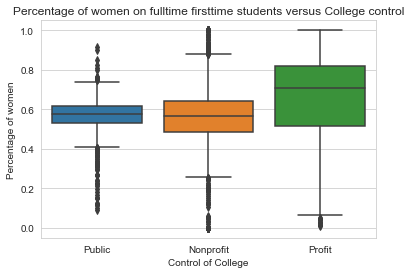

In [398]:
# percentage of women against CONTROL of college
sns.set_style("whitegrid")

control = df_oma_ftft_num.CONTROL
control = control.astype('category')
control = control.cat.rename_categories(['Public',
                                         'Nonprofit',
                                         'Profit'])
women = df_oma_ftft_num.UGDS_WOMEN

boxp1 = sns.boxplot(x=control, 
                    y=women);
boxp1.set(xlabel = 'Control of College', 
       ylabel = 'Percentage of women',
       title = 'Percentage of women on fulltime firsttime students versus College control');

In [399]:
# saving boxplot in an image
fig = boxp1.get_figure()
fig.savefig("boxp_UGDSWOMENCONTROLOMA.png", dpi=900)

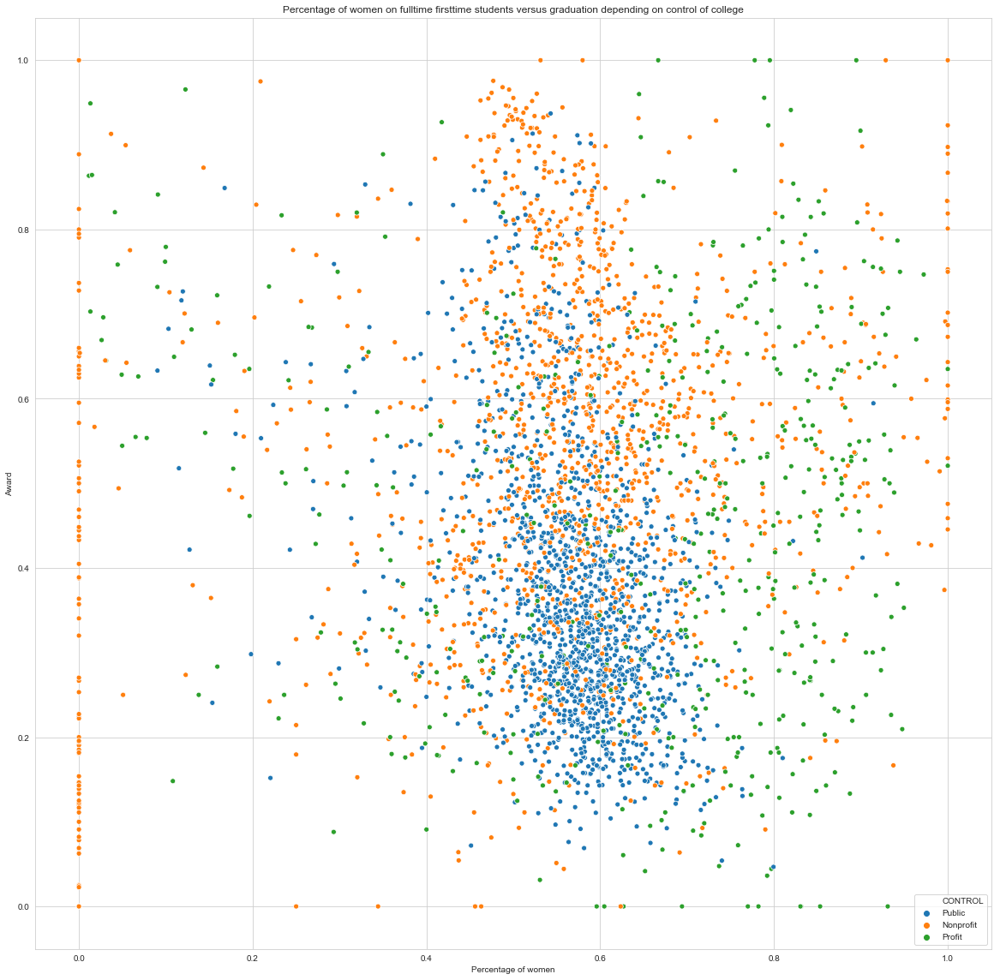

In [400]:
# percentage of women against award depending on CONTROL of college
sns.set_style("whitegrid")
plt.figure(figsize=(20,20))
control = df_oma_ftft_num.CONTROL
control = control.astype('category')
control = control.cat.rename_categories(['Public',
                                        'Nonprofit',
                                         'Profit'])
award = df_oma_ftft_num.OMAWDP6_FTFT_POOLED
women = df_oma_ftft_num.UGDS_WOMEN

scrpl = sns.scatterplot(x=women, y=award, hue=control);
scrpl.set(ylabel = 'Award', 
          xlabel = 'Percentage of women',
         title = 'Percentage of women on fulltime firsttime students versus graduation depending on control of college');

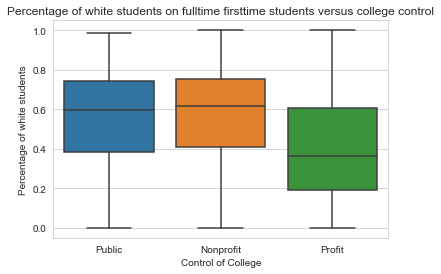

In [401]:
# percentage of white students against CONTROL of college
sns.set_style("whitegrid")

control = df_oma_ftft_num.CONTROL
control = control.astype('category')
control = control.cat.rename_categories(['Public',
                                         'Nonprofit',
                                         'Profit'])
color = df_oma_ftft_num.UGDS_WHITE

boxp1 = sns.boxplot(x=control, 
                    y=color);
boxp1.set(xlabel = 'Control of College', 
       ylabel = 'Percentage of white students',
       title = 'Percentage of white students on fulltime firsttime students versus college control');

In [402]:
# saving boxplot in an image
fig = boxp1.get_figure()
fig.savefig("boxp_UGDSWHITECONTROLOMA.png", dpi=900)

**Explore numerical variables**

In [403]:
# delete not needed columns
df_oma_ftft_num = df_oma_ftft_num.drop(['LATITUDE', 'LONGITUDE', 'CONTROL', 'STABBR'], axis=1)

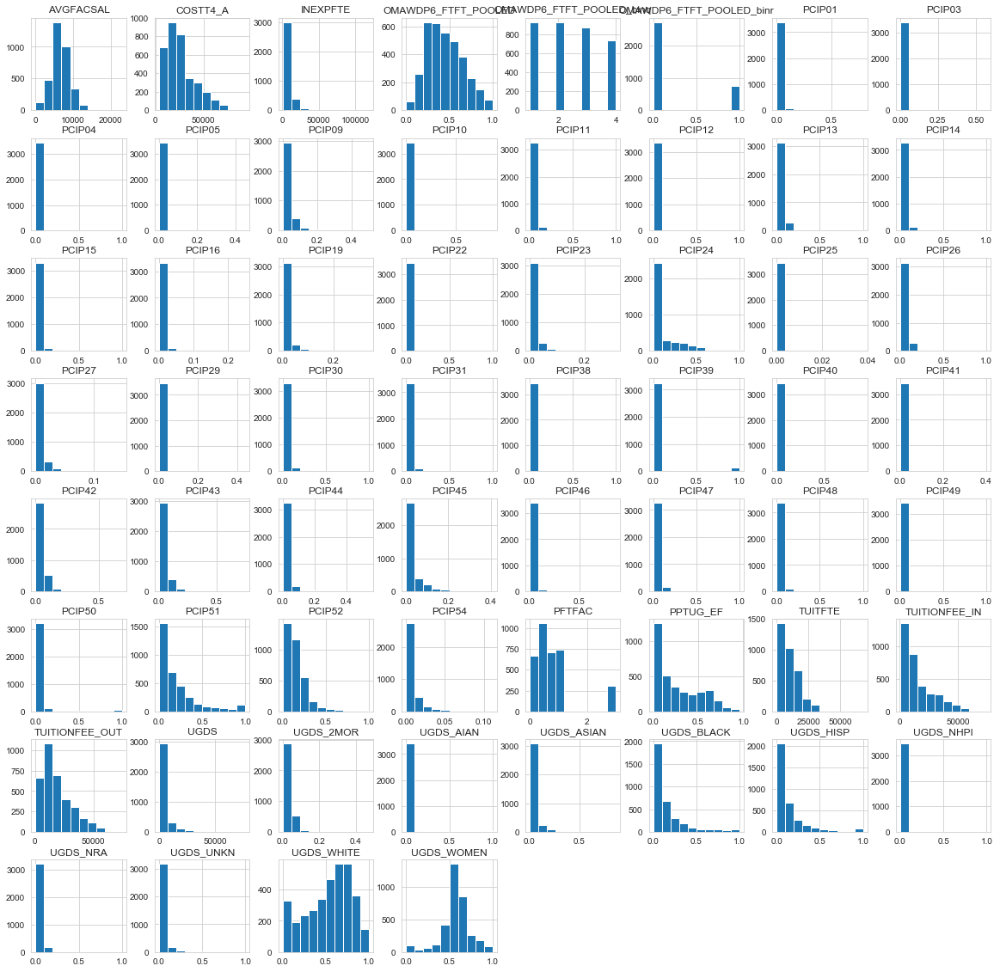

In [404]:
# check numerical data 
df_oma_ftft_num.hist(figsize=(20,20));

**Comment:
Most of the numerical data are right skewed. The numerical outcome variable is left skewed. Therefore transform data to normal distribution.**

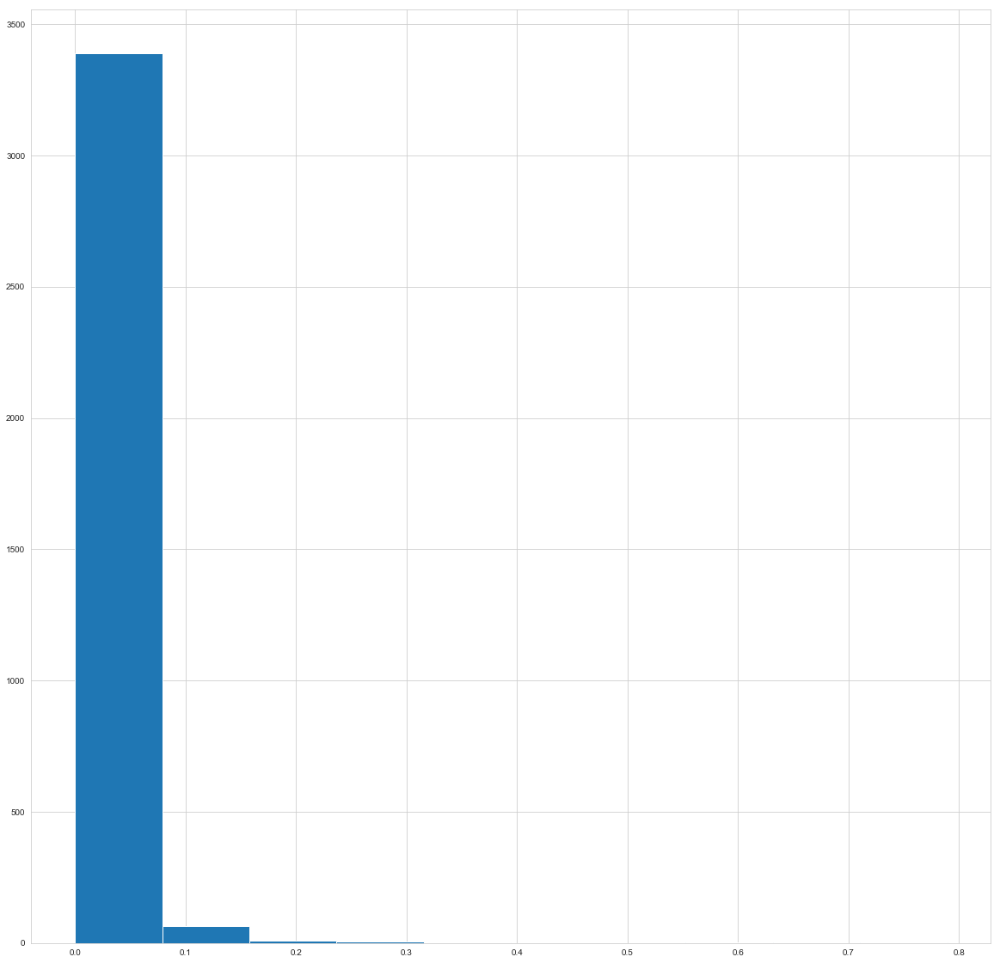

In [405]:
# check one PCIP variable in detail
df_oma_ftft_num['PCIP01'].hist(figsize=(20,20));

In [406]:
# log transform data
df_oma_ftft_num_log = np.log(1+df_oma_ftft_num)

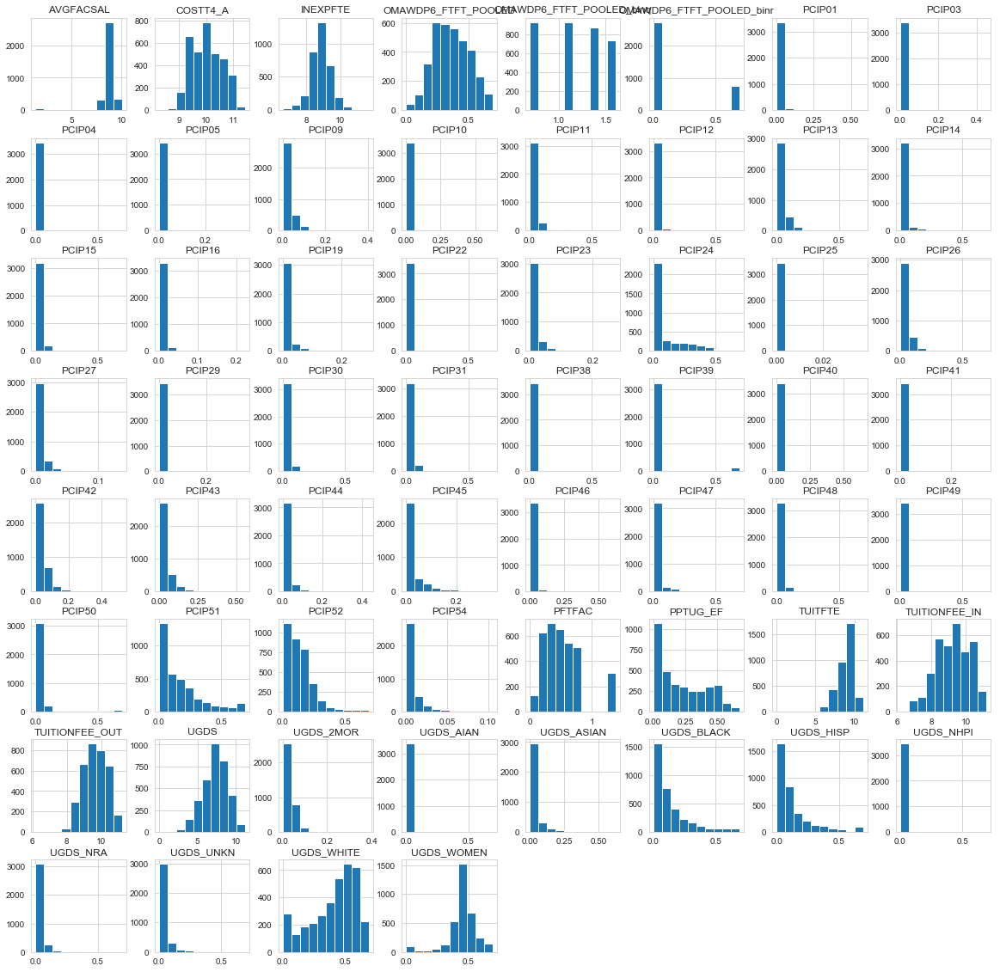

In [407]:
# check transformed data
df_oma_ftft_num_log.hist(figsize=(20,20));

In [408]:
# transform data with cubic root
df_oma_ftft_num_cbr = np.cbrt(df_oma_ftft_num)

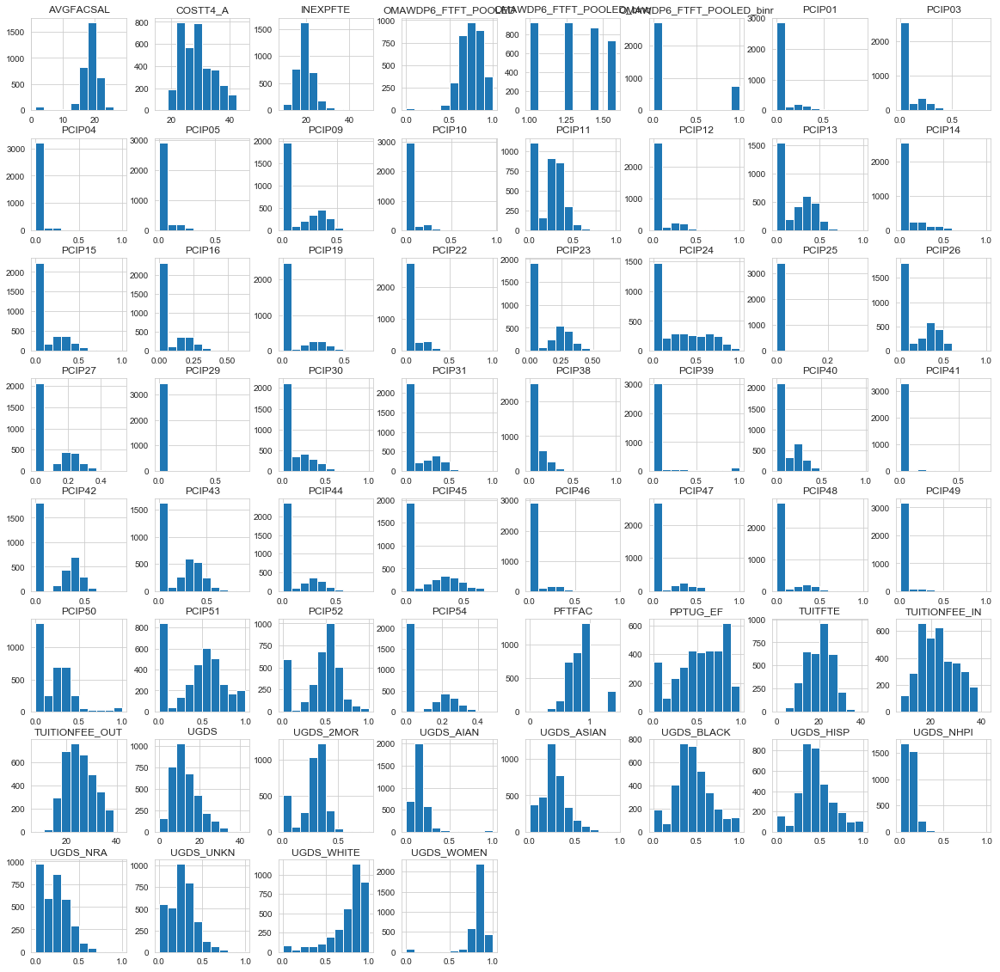

In [409]:
# check transformed data
df_oma_ftft_num_cbr.hist(figsize=(20,20));

In [410]:
# transform data with square root
df_oma_ftft_num_sqr = np.sqrt(df_oma_ftft_num)

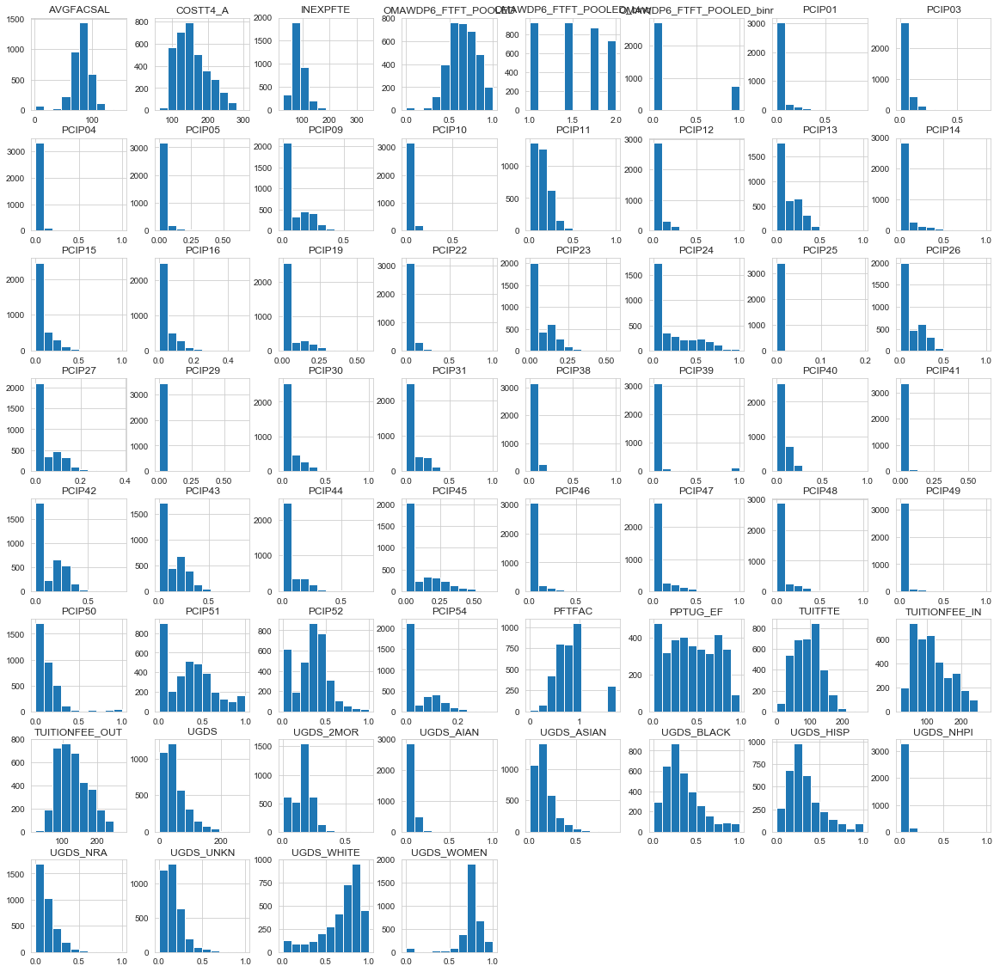

In [411]:
# check transformed data
df_oma_ftft_num_sqr.hist(figsize=(20,20));

In [412]:
# square transform data
df_oma_ftft_num_square = np.square(df_oma_ftft_num)

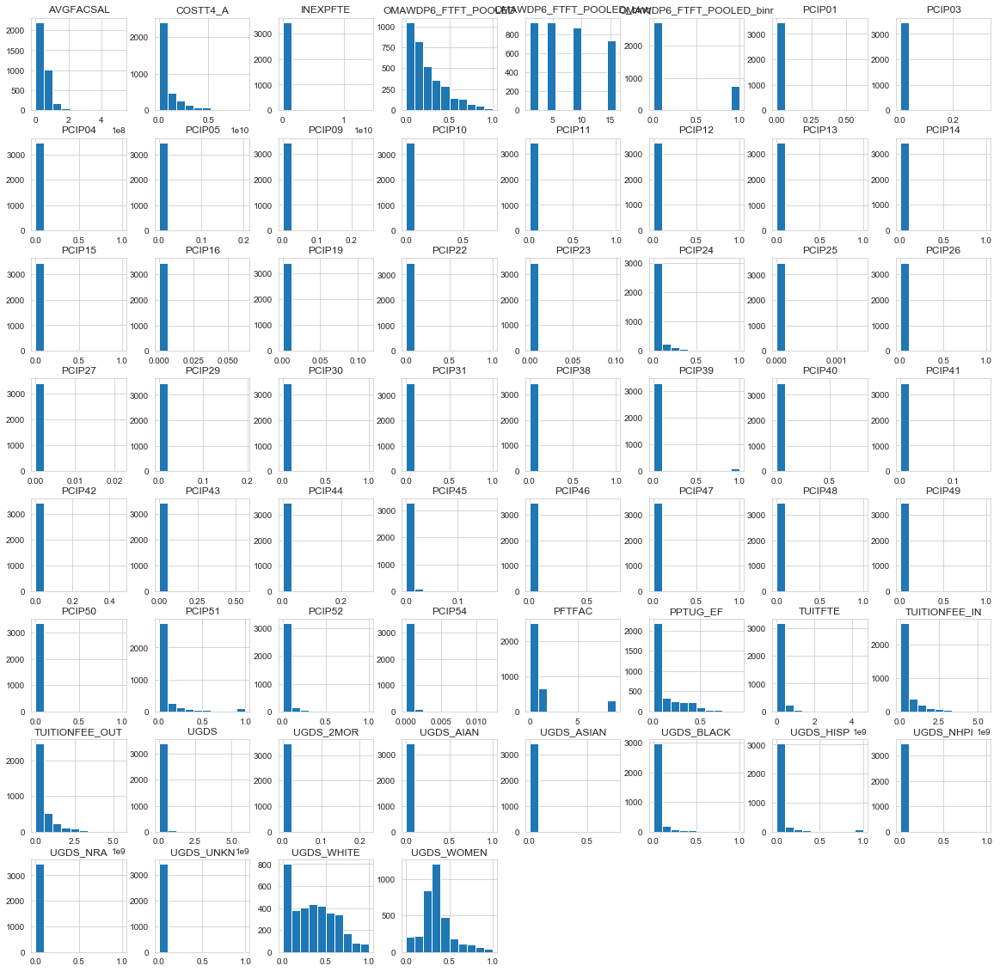

In [413]:
# check transformed data
df_oma_ftft_num_square.hist(figsize=(20,20));

* cbr: AVGFACSAL, PCIP all, TUITFTE, UGDS_X all except White&WOMEN, OMAWDP6
* square: UGDS_WHITE, 
* sqrt: PFTFAC, PPTUG_EF
* log: COST4_A, UGDS, INEXPFTE,  TUITIONFEE_IN, TUITIONFEE_OUT,
* no transformation: categorical variables, UGDS_WOMEN

In [414]:
# check column index
pd.Series(df_oma_ftft_num.columns.values)

0                       PCIP01
1                       PCIP03
2                       PCIP04
3                       PCIP05
4                       PCIP09
5                       PCIP10
6                       PCIP11
7                       PCIP12
8                       PCIP13
9                       PCIP14
10                      PCIP15
11                      PCIP16
12                      PCIP19
13                      PCIP22
14                      PCIP23
15                      PCIP24
16                      PCIP25
17                      PCIP26
18                      PCIP27
19                      PCIP29
20                      PCIP30
21                      PCIP31
22                      PCIP38
23                      PCIP39
24                      PCIP40
25                      PCIP41
26                      PCIP42
27                      PCIP43
28                      PCIP44
29                      PCIP45
30                      PCIP46
31                      PCIP47
32      

In [415]:
# create df for transformations
df_oma_ftft_num_transform = df_oma_ftft_num.copy()

In [416]:
# cbrt transformation
df_oma_ftft_num_transform.iloc[:, np.r_[:38, 52, 54, 57, 40:48]] = np.cbrt(df_oma_ftft_num_transform.iloc[:, np.r_[:38, 52, 54, 57, 40:48 ]])

In [417]:
# square transformation
df_oma_ftft_num_transform.iloc[:, np.r_[39, ]] = np.square(df_oma_ftft_num_transform.iloc[:, np.r_[39 ]])

In [418]:
# sqrt transformation
df_oma_ftft_num_transform.iloc[:, np.r_[48, 55 ]] = np.sqrt(df_oma_ftft_num_transform.iloc[:, np.r_[48, 55 ]])

In [419]:
# log transformation
df_oma_ftft_num_transform.iloc[:, np.r_[38, 49, 50:52, 53]] = np.log(1+df_oma_ftft_num_transform.iloc[:, np.r_[38, 49, 50:52, 53]])

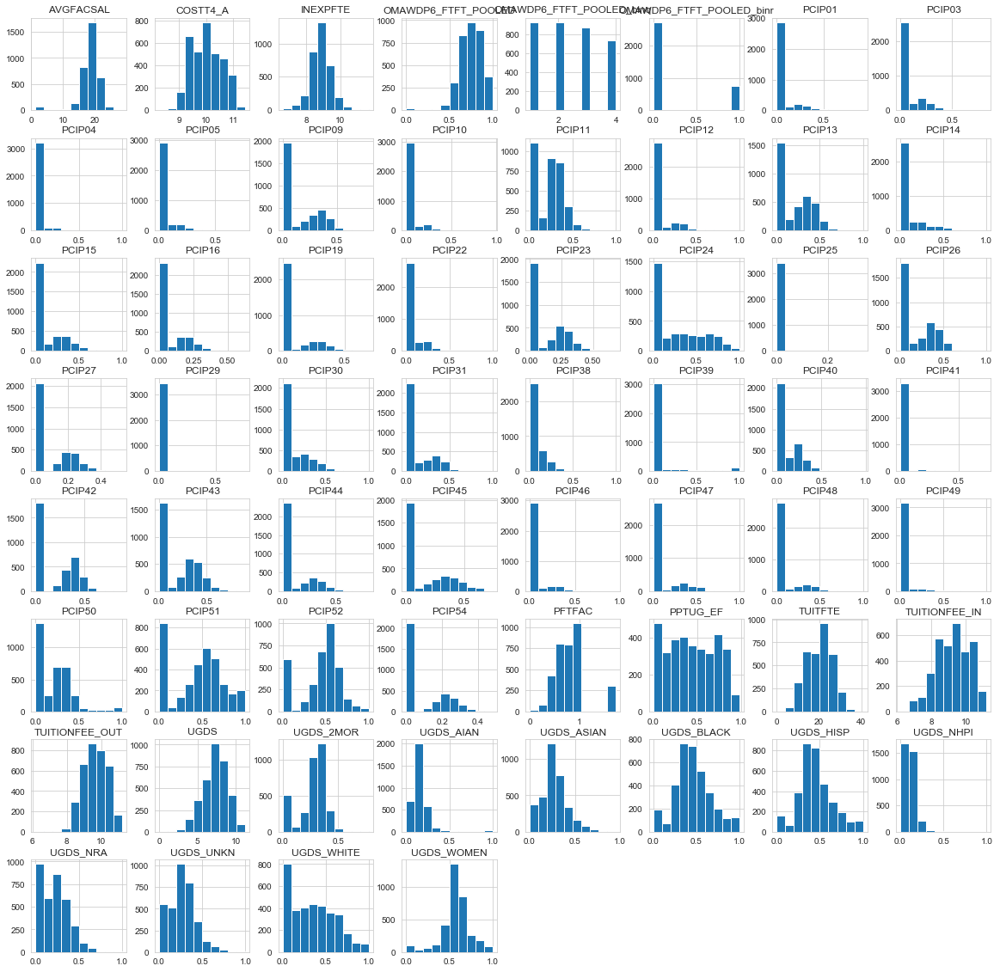

In [420]:
# check transformed df
df_oma_ftft_num_transform.hist(figsize=(20,20));

In [421]:
# save transformed df
df_oma_ftft_num_transform.to_csv('df_oma_ftft_num_transform.csv', index=False)

In [8]:
# read transformed df
df_oma_ftft_num_transform = pd.read_csv('df_oma_ftft_num_transform.csv')

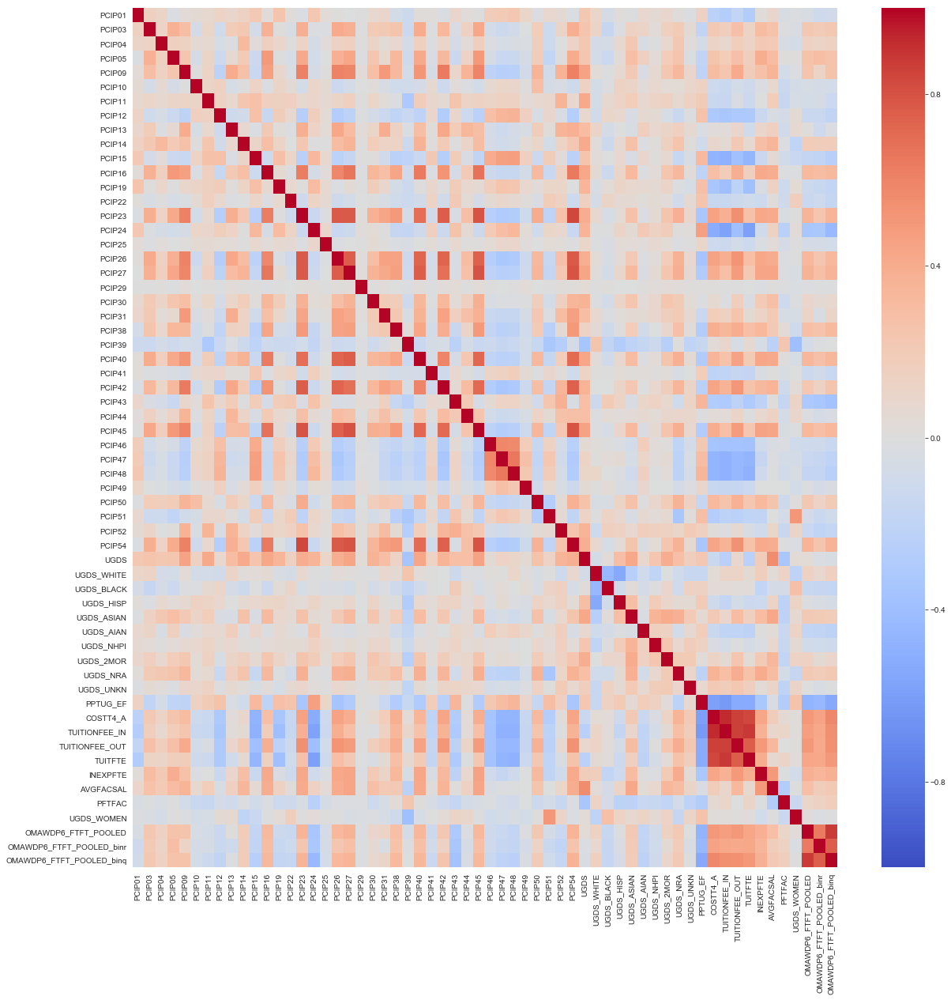

In [423]:
# explore correlation between numerical output and numerical input
plt.figure(figsize=(20,20))
sns.heatmap(df_oma_ftft_num_transform.corr(), annot=False, vmax=1, vmin=-1, center=0, cmap='coolwarm');

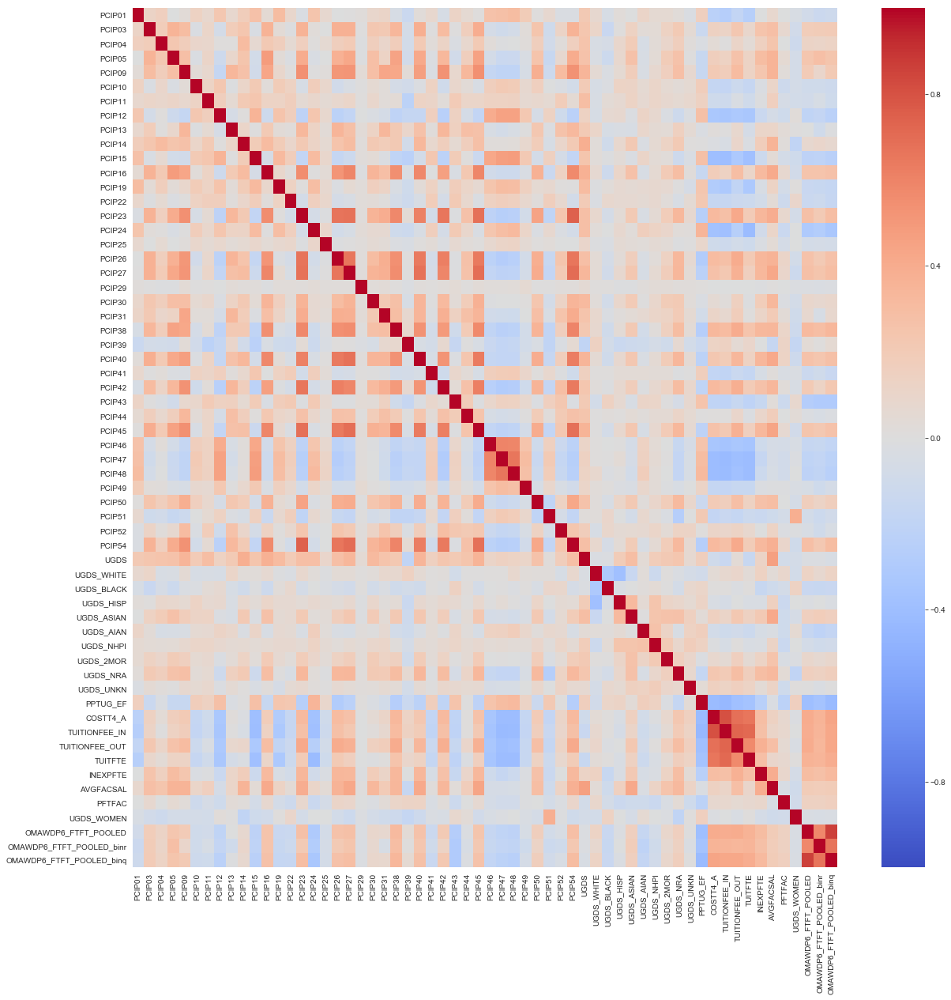

In [424]:
# explore correlation between categorical output and numerical input
plt.figure(figsize=(20,20))
sns.heatmap(df_oma_ftft_num_transform.corr(method='kendall'), annot=False, vmax=1, vmin=-1, center=0, cmap='coolwarm');

In [425]:
# create subset for scatterplott
df_subset = df_oma_ftft_num_transform[df_oma_ftft_num_transform.columns.drop(list(df_oma_ftft_num_transform.filter(regex='PCIP')))] 

In [426]:
# create subset for scatterplott
df_subset = df_subset.drop(['OMAWDP6_FTFT_POOLED_binr', 'OMAWDP6_FTFT_POOLED_binq'], axis=1)

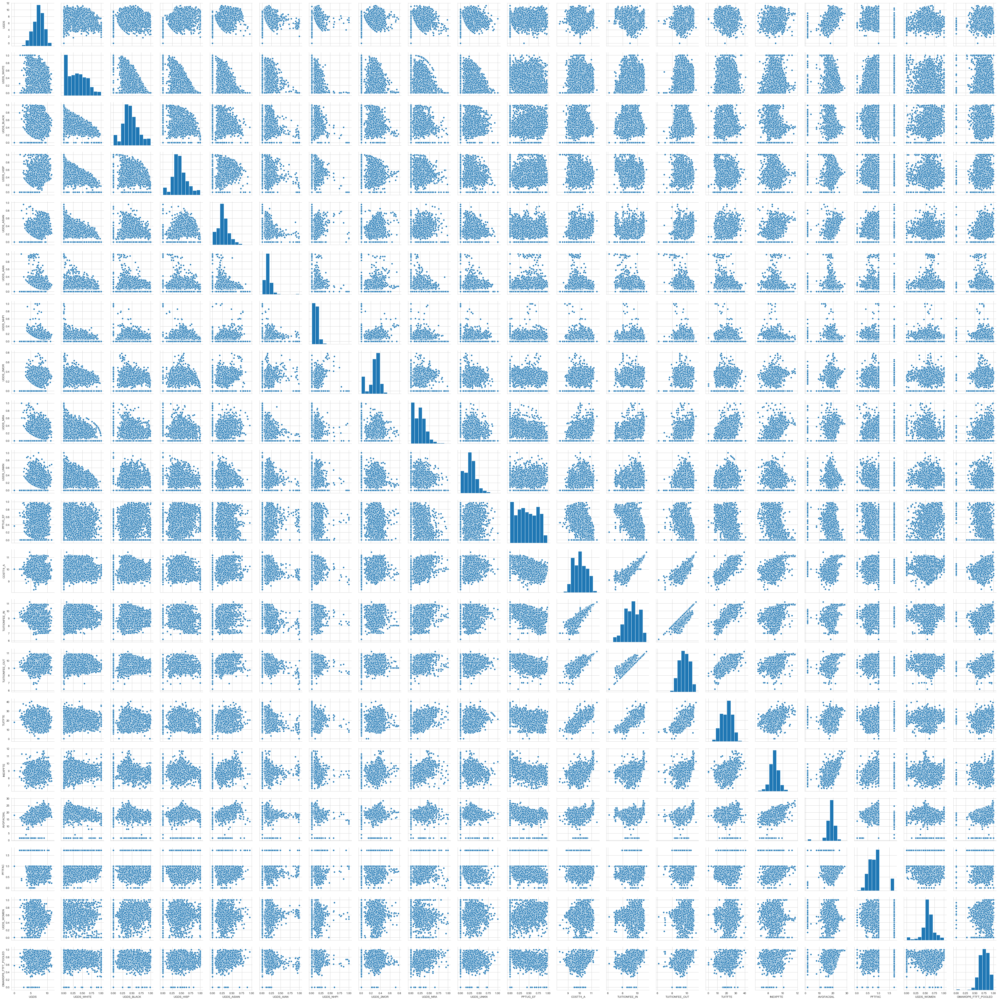

In [427]:
# check for nonlinear relationships
sns.pairplot(df_subset);

**Comment: No nonlinear relationship**

In [428]:
# get rid of 0 values
mask = df_oma_ftft_num_transform['OMAWDP6_FTFT_POOLED'] == 0

In [429]:
# get rid of 0 values
df_oma_ftft_num_transform = df_oma_ftft_num_transform[~mask]

In [430]:
# check values
df_oma_ftft_num_transform['OMAWDP6_FTFT_POOLED'].value_counts()

0.793701    17
0.629961    14
1.000000    10
0.522810     8
0.763117     7
0.873595     7
0.908560     7
0.550358     7
0.768855     6
0.584804     6
0.721125     6
0.736806     5
0.699387     5
0.722915     5
0.753964     5
0.817081     5
0.526924     5
0.480734     5
0.772782     4
0.854988     4
0.566497     4
0.784601     4
0.744162     4
0.742352     4
0.689082     4
0.761971     4
0.771552     4
0.651083     4
0.742654     4
0.876381     4
            ..
0.788427     1
0.800625     1
0.686899     1
0.748709     1
0.828309     1
0.689924     1
0.891148     1
0.732669     1
0.779149     1
0.981839     1
0.935914     1
0.591167     1
0.834195     1
0.955736     1
0.718164     1
0.732731     1
0.962224     1
0.410157     1
0.804248     1
0.621533     1
0.683491     1
0.904626     1
0.681990     1
0.858666     1
0.740837     1
0.578797     1
0.724506     1
0.846560     1
0.729489     1
0.762086     1
Name: OMAWDP6_FTFT_POOLED, Length: 2643, dtype: int64

In [431]:
# create subset for scatterplott
df_subset = df_oma_ftft_num_transform[df_oma_ftft_num_transform.columns.drop(list(df_oma_ftft_num_transform.filter(regex='PCIP')))]

In [432]:
# create subset for scatterplott
df_subset = df_subset.drop(['OMAWDP6_FTFT_POOLED_binr', 'OMAWDP6_FTFT_POOLED_binq'], axis=1)

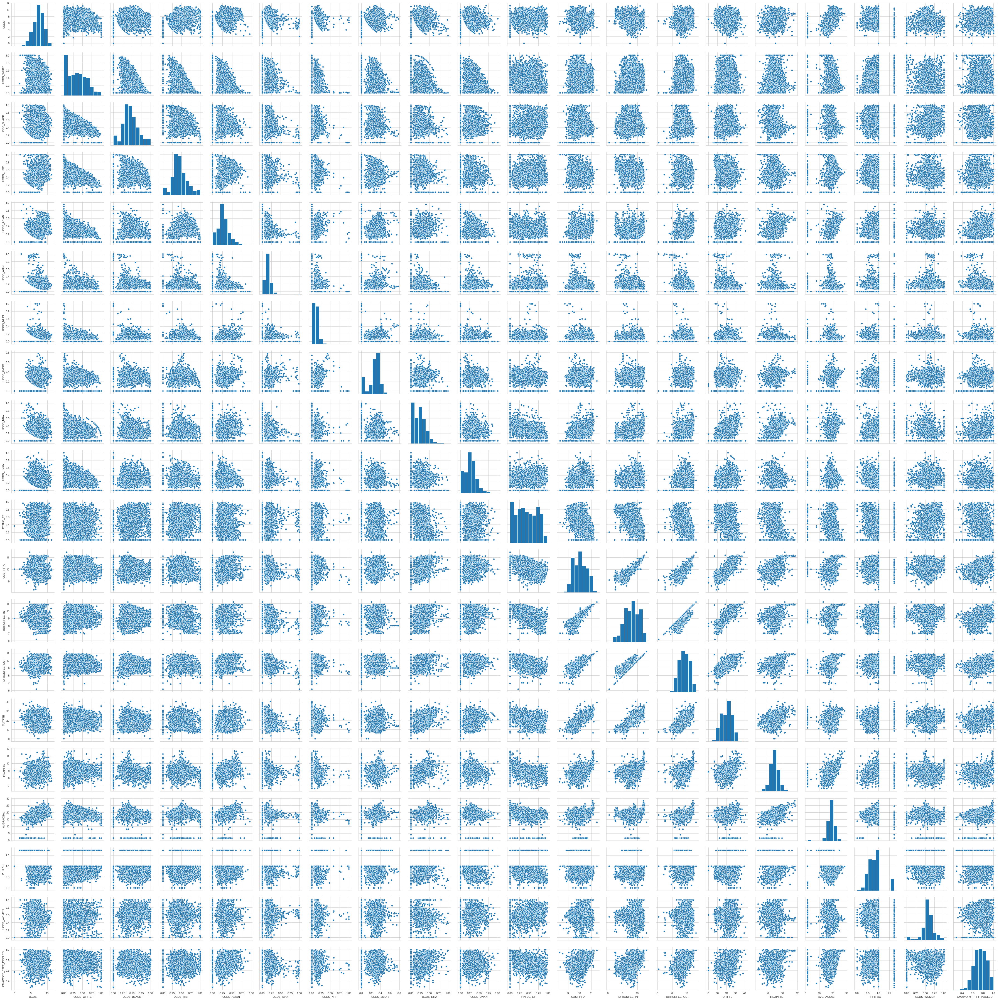

In [433]:
# check for nonlinear relationships
sns.pairplot(df_subset);

In [434]:
# save transformed numerical df graduation
df_oma_ftft_num_transform.to_csv('df_oma_ftft_num_transform1.csv', index=False)

In [9]:
# read transformed numerical df graduation
df_oma_ftft_num_transform = pd.read_csv('df_oma_ftft_num_transform1.csv')

In [436]:
# print correlations between num variables
corr_columns = []
corr_target = []
col_names = df_oma_ftft_num_transform.corr().columns.values
for col, row in (df_oma_ftft_num_transform.corr().abs() > 0.5).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PCIP01 ['PCIP01']
PCIP03 ['PCIP03']
PCIP04 ['PCIP04']
PCIP05 ['PCIP05']
PCIP09 ['PCIP09' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP10 ['PCIP10']
PCIP11 ['PCIP11']
PCIP12 ['PCIP12']
PCIP13 ['PCIP13']
PCIP14 ['PCIP14']
PCIP15 ['PCIP15']
PCIP16 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP19 ['PCIP19']
PCIP22 ['PCIP22']
PCIP23 ['PCIP09' 'PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45'
 'PCIP54' 'TUITIONFEE_OUT']
PCIP24 ['PCIP24' 'COSTT4_A' 'TUITIONFEE_IN' 'TUITFTE']
PCIP25 ['PCIP25']
PCIP26 ['PCIP09' 'PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45'
 'PCIP54' 'TUITIONFEE_OUT']
PCIP27 ['PCIP09' 'PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45'
 'PCIP54']
PCIP29 ['PCIP29']
PCIP30 ['PCIP30']
PCIP31 ['PCIP31']
PCIP38 ['PCIP38']
PCIP39 ['PCIP39']
PCIP40 ['PCIP09' 'PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45'
 'PCIP54']
PCIP41 ['PCIP41']
PCIP42 ['PCIP09' 'PCIP16' 'PCIP23' 'PCIP26'

### 4.2.2) Explore categorical variables

In [437]:
# transform numerical outcome variable for df with categorical features
df_oma_ftft_cat['OMAWDP6_FTFT_POOLED'] = np.cbrt(df_oma_ftft_cat['OMAWDP6_FTFT_POOLED'])

In [438]:
# get rid of 0 values
mask = df_oma_ftft_cat['OMAWDP6_FTFT_POOLED'] == 0

In [439]:
# get rid of 0 values
df_oma_ftft_cat = df_oma_ftft_cat[~mask]

In [440]:
len(df_oma_ftft_cat['PREDDEG'])

3452

In [441]:
# check numerical outcome column
df_oma_ftft_cat['OMAWDP6_FTFT_POOLED'].value_counts()

0.793701    17
0.629961    14
1.000000    10
0.522810     8
0.873595     7
0.908560     7
0.763117     7
0.550358     7
0.768855     6
0.584804     6
0.721125     6
0.480734     5
0.699387     5
0.526924     5
0.753964     5
0.817081     5
0.736806     5
0.722915     5
0.566497     4
0.675112     4
0.651083     4
0.876381     4
0.784601     4
0.742654     4
0.771552     4
0.689082     4
0.643686     4
0.894285     4
0.624196     4
0.653512     4
            ..
0.686899     1
0.790086     1
0.748709     1
0.732669     1
0.591167     1
0.779149     1
0.854623     1
0.712759     1
0.882416     1
0.931901     1
0.953798     1
0.632970     1
0.834195     1
0.879581     1
0.621533     1
0.725647     1
0.843807     1
0.955736     1
0.732731     1
0.797806     1
0.804248     1
0.588388     1
0.681990     1
0.718164     1
0.526684     1
0.740837     1
0.578797     1
0.846560     1
0.729489     1
0.788963     1
Name: OMAWDP6_FTFT_POOLED, Length: 2643, dtype: int64

In [442]:
# save categorical df graduation
df_oma_ftft_cat.to_csv('df_oma_ftft_cat1.csv', index=False)

In [443]:
# read categorical df graduation
df_oma_ftft_cat = pd.read_csv('df_oma_ftft_cat1.csv')

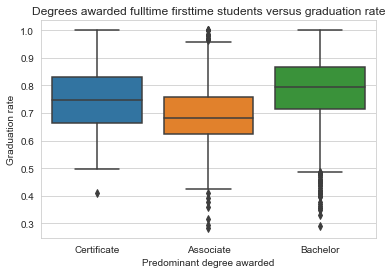

In [444]:
# outcome variable against PREDDEG 
sns.set_style("whitegrid")

preddeg = df_oma_ftft_cat.PREDDEG
preddeg = preddeg.astype('category')
preddeg = preddeg.cat.rename_categories([
                                         'Certificate',
                                         'Associate',
                                         'Bachelor'])
graduation = df_oma_ftft_cat.OMAWDP6_FTFT_POOLED

boxp2 = sns.boxplot(x=preddeg, 
                    y=graduation);
boxp2.set(xlabel = 'Predominant degree awarded', 
          ylabel = 'Graduation rate',
          title = 'Degrees awarded fulltime firsttime students versus graduation rate');

In [445]:
# saving boxplot in an image
fig = boxp2.get_figure()
fig.savefig("boxp_OMAPREDDEG.png", dpi=900)

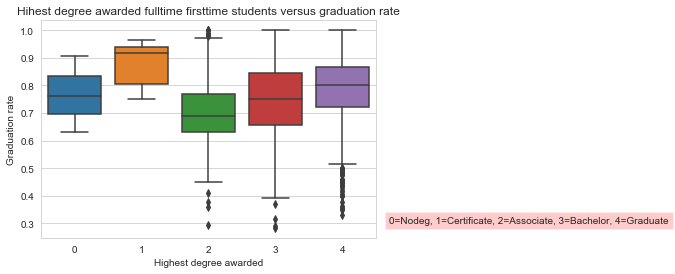

In [446]:
# outcome variables against HIGHDEG 
sns.set_style("whitegrid")
ax = plt.subplot(111)
highdeg = df_oma_ftft_cat.HIGHDEG
ax.text(4.7, 0.3, '0=Nodeg, 1=Certificate, 2=Associate, 3=Bachelor, 4=Graduate', bbox=dict(facecolor='red', alpha=0.2))
graduation = df_oma_ftft_cat.OMAWDP6_FTFT_POOLED

boxp2 = sns.boxplot(x=highdeg, 
                    y=graduation);
boxp2.set(xlabel = 'Highest degree awarded', 
          ylabel = 'Graduation rate',
          title =  'Hihest degree awarded fulltime firsttime students versus graduation rate');

In [447]:
# saving boxplot in an image
fig = boxp2.get_figure()
fig.savefig("boxp_OMAHIGHDEG.png", dpi=900)

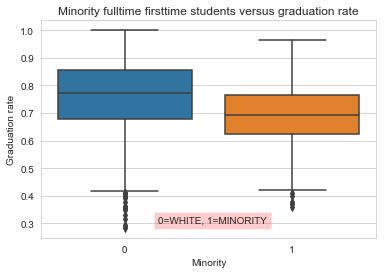

In [448]:
# outcome variable against MINORITY
sns.set_style("whitegrid")
ax = plt.subplot(111)
minority = df_oma_ftft_cat.MINORITY

ax.text(0.2, 0.3, '0=WHITE, 1=MINORITY', bbox=dict(facecolor='red', alpha=0.2))
graduation = df_oma_ftft_cat.OMAWDP6_FTFT_POOLED

boxp3 = sns.boxplot(x=minority, 
                    y=graduation);
boxp3.set(xlabel = 'Minority', 
          ylabel = 'Graduation rate',
          title = 'Minority fulltime firsttime students versus graduation rate');

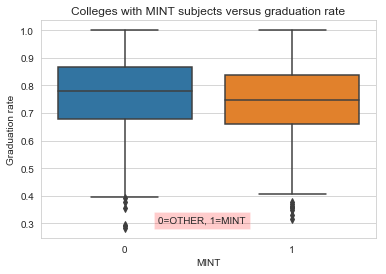

In [449]:
# outcome variable against MINT 
sns.set_style("whitegrid")
ax = plt.subplot(111)
mint = df_oma_ftft_cat.MINT_binr
ax.text(0.2, 0.3, '0=OTHER, 1=MINT', bbox=dict(facecolor='red', alpha=0.2))
graduation = df_oma_ftft_cat.OMAWDP6_FTFT_POOLED

boxp4 = sns.boxplot(x=mint, 
                    y=graduation);
boxp4.set(xlabel = 'MINT', 
          ylabel = 'Graduation rate',
          title = 'Colleges with MINT subjects versus graduation rate');

In [450]:
# print correlations between cat variables
corr_columns = []
corr_target = []
col_names = df_oma_ftft_cat.corr(method='kendall').columns.values
for col, row in (df_oma_ftft_cat.corr(method='kendall').abs() > 0.5).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PREDDEG_2 ['PREDDEG_2' 'PREDDEG_3' 'HIGHDEG_2' 'HIGHDEG_4' 'PREDDEG' 'HIGHDEG'
 'CIP23BACHL' 'CIP26BACHL' 'CIP27BACHL' 'CIP42BACHL' 'CIP45BACHL'
 'CIP50BACHL' 'CIP51ASSOC' 'CIP54BACHL']
PREDDEG_3 ['PREDDEG_2' 'PREDDEG_3' 'HIGHDEG_2' 'HIGHDEG_4' 'PREDDEG' 'HIGHDEG'
 'CIP09BACHL' 'CIP11ASSOC' 'CIP11BACHL' 'CIP13BACHL' 'CIP15ASSOC'
 'CIP16BACHL' 'CIP23BACHL' 'CIP24BACHL' 'CIP26BACHL' 'CIP27BACHL'
 'CIP30BACHL' 'CIP31BACHL' 'CIP38BACHL' 'CIP40BACHL' 'CIP42BACHL'
 'CIP43ASSOC' 'CIP45BACHL' 'CIP47CERT2' 'CIP47ASSOC' 'CIP50BACHL'
 'CIP51CERT1' 'CIP51CERT2' 'CIP51ASSOC' 'CIP51BACHL' 'CIP52CERT2'
 'CIP52ASSOC' 'CIP52BACHL' 'CIP54BACHL' 'PCIP23_binr' 'PCIP26_binr'
 'PCIP42_binr' 'PCIP47_binr' 'PCIP48_binr' 'PCIP54_binr' 'CIP09_ord1'
 'CIP23_ord1' 'CIP26_ord1' 'CIP27_ord1' 'CIP38_ord1' 'CIP40_ord1'
 'CIP42_ord1' 'CIP45_ord1' 'CIP47_ord1' 'CIP48_ord1' 'CIP50_ord1'
 'CIP52_ord1' 'CIP54_ord1' 'COSTT4_A_binq' 'TUITIONFEE_IN_binq'
 'TUITIONFEE_OUT_binq']
PREDDEG_4 ['PREDDEG_4']
HIGHDEG_1 ['HIGHDEG_1']

In [451]:
# print correlations between cat variables
corr_columns = []
corr_target = []
col_names = df_oma_ftft_cat.corr().columns.values
for col, row in (df_oma_ftft_cat.corr().abs() > 0.5).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PREDDEG_2 ['PREDDEG_2' 'PREDDEG_3' 'HIGHDEG_2' 'HIGHDEG_4' 'HIGHDEG' 'CIP23BACHL'
 'CIP26BACHL' 'CIP27BACHL' 'CIP42BACHL' 'CIP45BACHL' 'CIP50BACHL'
 'CIP51ASSOC' 'CIP54BACHL']
PREDDEG_3 ['PREDDEG_2' 'PREDDEG_3' 'HIGHDEG_2' 'HIGHDEG_4' 'PREDDEG' 'HIGHDEG'
 'CIP09BACHL' 'CIP11ASSOC' 'CIP11BACHL' 'CIP13BACHL' 'CIP15ASSOC'
 'CIP16BACHL' 'CIP23BACHL' 'CIP24BACHL' 'CIP26BACHL' 'CIP27BACHL'
 'CIP30BACHL' 'CIP31BACHL' 'CIP38BACHL' 'CIP40BACHL' 'CIP42BACHL'
 'CIP43ASSOC' 'CIP45BACHL' 'CIP47CERT2' 'CIP47ASSOC' 'CIP50BACHL'
 'CIP51CERT1' 'CIP51CERT2' 'CIP51ASSOC' 'CIP51BACHL' 'CIP52CERT2'
 'CIP52ASSOC' 'CIP52BACHL' 'CIP54BACHL' 'PCIP23_binr' 'PCIP26_binr'
 'PCIP42_binr' 'PCIP47_binr' 'PCIP48_binr' 'PCIP54_binr' 'CIP09_ord1'
 'CIP23_ord1' 'CIP26_ord1' 'CIP27_ord1' 'CIP38_ord1' 'CIP40_ord1'
 'CIP42_ord1' 'CIP45_ord1' 'CIP47_ord1' 'CIP54_ord1' 'COSTT4_A_binq'
 'TUITIONFEE_IN_binq' 'TUITIONFEE_OUT_binq' 'TUITFTE_binq']
PREDDEG_4 []
HIGHDEG_1 ['HIGHDEG_1']
HIGHDEG_2 ['PREDDEG_2' 'PREDDEG_3' 'HIGHDEG_2

In [452]:
# print correlations between cat variables
corr_columns = []
corr_target = []
col_names = df_oma_ftft_cat.corr(method='spearman').columns.values
for col, row in (df_oma_ftft_cat.corr(method='spearman').abs() > 0.5).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PREDDEG_2 ['PREDDEG_2' 'PREDDEG_3' 'HIGHDEG_2' 'HIGHDEG_4' 'PREDDEG' 'HIGHDEG'
 'CIP23BACHL' 'CIP26BACHL' 'CIP27BACHL' 'CIP42BACHL' 'CIP45BACHL'
 'CIP50BACHL' 'CIP51ASSOC' 'CIP54BACHL']
PREDDEG_3 ['PREDDEG_2' 'PREDDEG_3' 'HIGHDEG_2' 'HIGHDEG_4' 'PREDDEG' 'HIGHDEG'
 'CIP09BACHL' 'CIP11ASSOC' 'CIP11BACHL' 'CIP13BACHL' 'CIP15ASSOC'
 'CIP16BACHL' 'CIP23BACHL' 'CIP24BACHL' 'CIP26BACHL' 'CIP27BACHL'
 'CIP30BACHL' 'CIP31BACHL' 'CIP38BACHL' 'CIP40BACHL' 'CIP42BACHL'
 'CIP43ASSOC' 'CIP45BACHL' 'CIP47CERT2' 'CIP47ASSOC' 'CIP50BACHL'
 'CIP51CERT1' 'CIP51CERT2' 'CIP51ASSOC' 'CIP51BACHL' 'CIP52CERT2'
 'CIP52ASSOC' 'CIP52BACHL' 'CIP54BACHL' 'PCIP23_binr' 'PCIP26_binr'
 'PCIP42_binr' 'PCIP47_binr' 'PCIP48_binr' 'PCIP54_binr' 'CIP09_ord1'
 'CIP23_ord1' 'CIP26_ord1' 'CIP27_ord1' 'CIP38_ord1' 'CIP40_ord1'
 'CIP42_ord1' 'CIP45_ord1' 'CIP47_ord1' 'CIP48_ord1' 'CIP50_ord1'
 'CIP52_ord1' 'CIP54_ord1' 'COSTT4_A_binq' 'TUITIONFEE_IN_binq'
 'TUITIONFEE_OUT_binq' 'TUITFTE_binq']
PREDDEG_4 []
HIGHDEG_1 ['HIGHDEG

**Comment: None of the cat variables seem to have correlation to the target variables but lots of correlations between themselves.**

In [453]:
# delete not needed columns
df_oma_ftft_cat = df_oma_ftft_cat.drop(['PREDDEG', 'HIGHDEG', 'CONTROL', ], axis=1)

In [454]:
# save categorical df graduation
df_oma_ftft_cat.to_csv('df_oma_ftft_cat_2.csv', index=False)

In [10]:
# read categorical df graduation
df_oma_ftft_cat = pd.read_csv('df_oma_ftft_cat_2.csv')

## 4.3) Correlation between Retention and Graduation variables

In [456]:
# clean data
df_out = df_data[['RET_FT4_POOLED', 'OMAWDP6_FTFT_POOLED']]

In [457]:
# drop NaN
df_out = df_out.dropna(axis=0, subset=['RET_FT4_POOLED'])

In [458]:
# drop NaN
df_out = df_out.dropna(axis=0, subset=['OMAWDP6_FTFT_POOLED'])

In [459]:
# check df
df_out.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2153 entries, 0 to 6652
Data columns (total 2 columns):
RET_FT4_POOLED         2153 non-null float64
OMAWDP6_FTFT_POOLED    2153 non-null float64
dtypes: float64(2)
memory usage: 50.5 KB


In [460]:
# correlate df
df_out.corr()

,RET_FT4_POOLED,OMAWDP6_FTFT_POOLED
RET_FT4_POOLED,1.000000,0.678173
OMAWDP6_FTFT_POOLED,0.678173,1.000000


#  5) Feature Engineering

* Create dummy variables for nominal data columns
* Create binary variable for minority flag columns
* Create binary variables for PCIP columns
* Create binary variables for CIP variables
* Create ordinal variables for CIP variables (Cert1=1, Cert2 = 2 ASSOC= 3.....)
* Create ordinal variables for UGS variables( quartiles 1 = 0-25%, 2= 25 - median.....)
* Create binary variable for UGS_ White versus non white
* Create ordinal variables for COSTT4 variables( quartiles 1 = 0-25%, 2= 25 - median.....)
* Create ordinal variables for TUITIONFEE variables( quartiles 1 = 0-25%, 2= 25 - median.....)
* Create ordinal variable for TUITFTE variable( quartiles 1 = 0-25%, 2= 25 - median.....)
* Create ordinal variable for INEXPFTE variable( quartiles 1 = 0-25%, 2= 25 - median.....)
* Create ordinal variable for AVGFACSAL variable( quartiles 1 = 0-25%, 2= 25 - median.....)
* Create ordinal variable for PFTFAC variable( quartiles 1 = 0-25%, 2= 25 - median.....)
* Create binary variables for outcome variables (low outcome = quartile 1-3, high outcome = quartile 4)
* Create ordinal variables for outcome variables( quartiles 1 = 0-25%, 2= 25 - median.....)
* Create MINT variable from PCIP variables (MINT = 1, other subjects= 0)

## 5.1) Create dummy variables for nominal data columns

In [166]:
# copy partially cleaned df
df_copy_feat = df_copy.copy()

In [167]:
# check df
df_copy_feat.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 276 columns):
STABBR                  6283 non-null object
PREDDEG                 6283 non-null int64
HIGHDEG                 6283 non-null int64
CONTROL                 6283 non-null int64
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
HBCU                    6283 non-null int64
PBI                     6283 non-null int64
ANNHI                   6283 non-null int64
TRIBAL                  6283 non-null int64
AANAPII                 6283 non-null int64
HSI                     6283 non-null int64
NANTI                   6283 non-null int64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null float64
PCIP01                  6283 non-null float64
PCIP03                  6283 non-null f

In [168]:
# get dummy variables for nominal data columns
df_copy_feat[['PREDDEG', 'HIGHDEG', 'CONTROL']] = df_copy_feat[['PREDDEG', 'HIGHDEG', 'CONTROL']].astype('str')

In [169]:
# get dummy variables for nominal data columns
dummy = pd.get_dummies(df_copy_feat[['PREDDEG', 'HIGHDEG', 'CONTROL']], drop_first=True)

In [170]:
# check dummies
dummy.head()

,PREDDEG_2,PREDDEG_3,PREDDEG_4,HIGHDEG_1,HIGHDEG_2,HIGHDEG_3,HIGHDEG_4,CONTROL_2,CONTROL_3
0,0,1,0,0,0,0,1,0,0
1,0,1,0,0,0,0,1,0,0
2,0,1,0,0,0,0,1,1,0
3,0,1,0,0,0,0,1,0,0
4,0,1,0,0,0,0,1,0,0


In [171]:
# merge dummies with working df 
df_copy_feat = pd.concat([dummy, df_copy_feat], axis=1)

In [172]:
# check df
df_copy_feat.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 285 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
HBCU                    6283 non-null int64
PBI                     6283 non-null int64
ANNHI                   6283 non-null int64
TRIBAL                  6283 non-null int64
AANAPII                 6283 non-null int64
HSI 

## 5.2) Create binary variable column for minority flag columns

In [173]:
# create feature column of whether a college has a flag as a minority college (1) or not (0)
df_copy_feat['MINORITY'] = df_copy_feat['HBCU'] + df_copy_feat['PBI'] + df_copy_feat['ANNHI'] + df_copy_feat['TRIBAL'] + df_copy_feat['AANAPII'] + df_copy_feat['HSI'] +df_copy_feat['NANTI'] 

In [174]:
# check values
df_copy_feat['MINORITY'].value_counts()

0    5508
1     685
2      90
Name: MINORITY, dtype: int64

In [175]:
# function to create binary variable in df in existing column
def map_col(df, x, map_dict, y=0):
    if y == 0:
        df[x] = df[x].map(map_dict)
    else:
        list_col = df.columns[x:y]
        for col in list_col:
            df[col] = df[col].map(map_dict).astype('int64')
    return df

In [176]:
# create binary variable
map_dict1 = {0:0, 1:1, 2:1}
df_copy_feat = map_col(df_copy_feat, 'MINORITY', map_dict1)

In [177]:
# check minority column
df_copy_feat['MINORITY'].value_counts()

0    5508
1     775
Name: MINORITY, dtype: int64

In [178]:
# delete original minority flag columns
df_copy_feat = df_copy_feat.drop(['HBCU', 'PBI', 'ANNHI', 'AANAPII', 'TRIBAL', 'HSI', 'NANTI'], axis=1)

In [179]:
# check df
df_copy_feat.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 279 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

## 5.3) Create binary variables for PCIP columns

In [180]:
# function to create binary variable in df in new column
def map_col_n(df, x, val_1, val_2, y=0, col_name='_binr'):
    if y == 0:
        x_new = x + col_name
        df[x_new] = [val_1 if x==val_1 else val_2 for x in df[x]]
    else:
        list_col = df.columns[x:y]
        list_col_new = [i + col_name for i in list_col]
        for i, col in enumerate(list_col):
            df[list_col_new[i]] = [val_1 if x==val_1 else val_2 for x in df[col]]
            df[list_col_new[i]] = df[list_col_new[i]].astype('int64')
    return df

In [181]:
# check column index
pd.Series(df_copy_feat.columns.values)[10:60]

10       PREDDEG
11       HIGHDEG
12       CONTROL
13      LATITUDE
14     LONGITUDE
15      SATVRMID
16      SATMTMID
17      ACTCMMID
18      ACTENMID
19      ACTMTMID
20        PCIP01
21        PCIP03
22        PCIP04
23        PCIP05
24        PCIP09
25        PCIP10
26        PCIP11
27        PCIP12
28        PCIP13
29        PCIP14
30        PCIP15
31        PCIP16
32        PCIP19
33        PCIP22
34        PCIP23
35        PCIP24
36        PCIP25
37        PCIP26
38        PCIP27
39        PCIP29
40        PCIP30
41        PCIP31
42        PCIP38
43        PCIP39
44        PCIP40
45        PCIP41
46        PCIP42
47        PCIP43
48        PCIP44
49        PCIP45
50        PCIP46
51        PCIP47
52        PCIP48
53        PCIP49
54        PCIP50
55        PCIP51
56        PCIP52
57        PCIP54
58    CIP01CERT1
59    CIP01CERT2
dtype: object

In [182]:
# create new columns
df_copy_feat = map_col_n(df_copy_feat, 20, 0.0000, 1.0000, 58)

In [183]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 317 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

In [184]:
# check new column
df_copy_feat['PCIP01_binr'].value_counts(dropna=False)

0    5637
1     646
Name: PCIP01_binr, dtype: int64

In [185]:
# compare old columns
df_copy_feat['PCIP01'].value_counts(dropna=False)

0.0000    5637
0.0020       6
1.0000       5
0.0331       5
0.0022       5
0.0018       5
0.0082       5
0.0074       4
0.0120       4
0.0127       4
0.0049       4
0.0026       4
0.0006       4
0.0030       4
0.0039       4
0.0028       4
0.0037       4
0.0019       4
0.0072       4
0.0036       4
0.0106       4
0.0060       4
0.0038       4
0.0033       4
0.0009       4
0.0157       4
0.0224       4
0.0031       4
0.0005       4
0.0090       3
          ... 
0.0260       1
0.0083       1
0.0128       1
0.1097       1
0.0816       1
0.0223       1
0.1032       1
0.0242       1
0.1565       1
0.0692       1
0.0177       1
0.0167       1
0.1245       1
0.0743       1
0.0170       1
0.0150       1
0.0660       1
0.0267       1
0.0305       1
0.0435       1
0.1887       1
0.0101       1
0.0375       1
0.0249       1
0.0326       1
0.0225       1
0.1910       1
0.1297       1
0.1373       1
0.0338       1
Name: PCIP01, Length: 404, dtype: int64

## 5.4) Create binary variable for CIP columns

In [186]:
# check column index
pd.Series(df_copy_feat.columns.values)[30:80]

30        PCIP15
31        PCIP16
32        PCIP19
33        PCIP22
34        PCIP23
35        PCIP24
36        PCIP25
37        PCIP26
38        PCIP27
39        PCIP29
40        PCIP30
41        PCIP31
42        PCIP38
43        PCIP39
44        PCIP40
45        PCIP41
46        PCIP42
47        PCIP43
48        PCIP44
49        PCIP45
50        PCIP46
51        PCIP47
52        PCIP48
53        PCIP49
54        PCIP50
55        PCIP51
56        PCIP52
57        PCIP54
58    CIP01CERT1
59    CIP01CERT2
60    CIP01ASSOC
61    CIP01CERT4
62    CIP01BACHL
63    CIP03CERT1
64    CIP03CERT2
65    CIP03ASSOC
66    CIP03CERT4
67    CIP03BACHL
68    CIP04CERT1
69    CIP04CERT2
70    CIP04ASSOC
71    CIP04CERT4
72    CIP04BACHL
73    CIP05CERT1
74    CIP05CERT2
75    CIP05ASSOC
76    CIP05CERT4
77    CIP05BACHL
78    CIP09CERT1
79    CIP09CERT2
dtype: object

In [187]:
# transform CIP variables into binary
map_dict2 = {0.0:0.0, 1.0:1.0, 2.0:1.0}
df_copy_feat = map_col(df_copy_feat, 58, map_dict2, 248)

In [188]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 317 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

In [189]:
# check new columns also for ordinal transformation
df_copy_feat['CIP01CERT1'].value_counts(dropna=False)

0    5974
1     309
Name: CIP01CERT1, dtype: int64

In [190]:
# check new columns also for ordinal transformation
df_copy_feat['CIP01CERT2'].value_counts(dropna=False)

0    5992
1     291
Name: CIP01CERT2, dtype: int64

In [191]:
# check new columns also for ordinal transformation
df_copy_feat['CIP01ASSOC'].value_counts(dropna=False)

0    5836
1     447
Name: CIP01ASSOC, dtype: int64

In [192]:
# check new columns also for ordinal transformation
df_copy_feat['CIP01CERT4'].value_counts(dropna=False)

0    6263
1      20
Name: CIP01CERT4, dtype: int64

In [193]:
# check new columns also for ordinal transformation
df_copy_feat['CIP01BACHL'].value_counts(dropna=False)

0    6074
1     209
Name: CIP01BACHL, dtype: int64

## 5.5) Create ordinal variables from CIP features

In [194]:
# check overlap
sum(df_copy_feat['CIP01CERT1'].eq(df_copy_feat['CIP01CERT2']))

6001

**Comment:
There is some overlap between awarded certificates for agriculture in this case**

In [195]:
# check if all agriculture degrees overlapp
df_col_list = df_copy_feat.iloc[:, 58:63]

In [196]:
# sum rows of agriculture degrees
df_col_list['SUM'] = df_col_list.sum(axis=1)

In [197]:
# if no overlap only 0 and 1 values
df_col_list['SUM'].value_counts(dropna=False)

0    5562
1     330
2     236
3     146
4       9
Name: SUM, dtype: int64

In [198]:
# function to create ordinal variable
def create_ordinal(df, x, y, bin_size, val_1, val_2, cut_off, col_name='_ord'):
    col_list = df.columns[x:y].values
    a = 0
    b = a+bin_size
    for i in range(int((y-x)/bin_size)):
        col_list1 = col_list[a:b]
        list_col_new = [i[:cut_off] + col_name for i in col_list1]
        df[list_col_new[0]+'1'] = np.zeros(len(df), dtype = int)
        for i, col in enumerate(col_list1,1):
            print(i)
            df[list_col_new[0]] = [val_2 if z==val_2 else i for z in df[col]]
            df[list_col_new[0]+'1'] = [max(j,k) for j,k in zip(df[list_col_new[0]],df[list_col_new[0]+'1'])]
            print(df[list_col_new[0]+'1'].value_counts(dropna=False))
            print('\n\n\n')    
            i += 1
            df.drop(list_col_new[0], axis=1, inplace=True)    
        a = b
        b = b+bin_size
    return df

In [199]:
# create ordinal variables and check success
df_copy_feat = create_ordinal(df_copy_feat, 58, 248, 5, 1, 0, -5 )

1
0    5974
1     309
Name: CIP01_ord1, dtype: int64




2
0    5842
2     291
1     150
Name: CIP01_ord1, dtype: int64




3
0    5715
3     447
2      62
1      59
Name: CIP01_ord1, dtype: int64




4
0    5711
3     436
2      58
1      58
4      20
Name: CIP01_ord1, dtype: int64




5
0    5562
3     392
5     209
2      52
1      49
4      19
Name: CIP01_ord1, dtype: int64




1
0    6172
1     111
Name: CIP03_ord1, dtype: int64




2
0    6139
1      82
2      62
Name: CIP03_ord1, dtype: int64




3
0    5945
3     275
1      49
2      14
Name: CIP03_ord1, dtype: int64




4
0    5945
3     274
1      49
2      14
4       1
Name: CIP03_ord1, dtype: int64




5
0    5197
5     806
3     241
1      28
2      10
4       1
Name: CIP03_ord1, dtype: int64




1
0    6249
1      34
Name: CIP04_ord1, dtype: int64




2
0    6226
2      38
1      19
Name: CIP04_ord1, dtype: int64




3
0    6170
3      96
1       9
2       8
Name: CIP04_ord1, dtype: int64




4
0    6170
3      96
1      

1
0    6230
1      53
Name: CIP39_ord1, dtype: int64




2
0    6163
2      84
1      36
Name: CIP39_ord1, dtype: int64




3
0    6065
3     173
2      27
1      18
Name: CIP39_ord1, dtype: int64




4
0    6063
3     165
2      24
1      16
4      15
Name: CIP39_ord1, dtype: int64




5
0    5758
5     495
3      10
2       8
1       8
4       4
Name: CIP39_ord1, dtype: int64




1
0    6258
1      25
Name: CIP40_ord1, dtype: int64




2
0    6247
1      24
2      12
Name: CIP40_ord1, dtype: int64




3
0    5933
3     326
1      20
2       4
Name: CIP40_ord1, dtype: int64




4
0    5933
3     325
1      20
2       4
4       1
Name: CIP40_ord1, dtype: int64




5
0    4777
5    1198
3     302
1       5
4       1
Name: CIP40_ord1, dtype: int64




1
0    6212
1      71
Name: CIP41_ord1, dtype: int64




2
0    6163
2      66
1      54
Name: CIP41_ord1, dtype: int64




3
0    6051
3     201
1      20
2      11
Name: CIP41_ord1, dtype: int64




4
0    6050
3     198
1      20
2      

In [200]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 355 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

## 5.6) Create ordinal variables for UGDS variables

In [201]:
# check column index
pd.Series(df_copy_feat.columns.values)[210:260]

210      CIP46ASSOC
211      CIP46CERT4
212      CIP46BACHL
213      CIP47CERT1
214      CIP47CERT2
215      CIP47ASSOC
216      CIP47CERT4
217      CIP47BACHL
218      CIP48CERT1
219      CIP48CERT2
220      CIP48ASSOC
221      CIP48CERT4
222      CIP48BACHL
223      CIP49CERT1
224      CIP49CERT2
225      CIP49ASSOC
226      CIP49CERT4
227      CIP49BACHL
228      CIP50CERT1
229      CIP50CERT2
230      CIP50ASSOC
231      CIP50CERT4
232      CIP50BACHL
233      CIP51CERT1
234      CIP51CERT2
235      CIP51ASSOC
236      CIP51CERT4
237      CIP51BACHL
238      CIP52CERT1
239      CIP52CERT2
240      CIP52ASSOC
241      CIP52CERT4
242      CIP52BACHL
243      CIP54CERT1
244      CIP54CERT2
245      CIP54ASSOC
246      CIP54CERT4
247      CIP54BACHL
248    DISTANCEONLY
249            UGDS
250      UGDS_WHITE
251      UGDS_BLACK
252       UGDS_HISP
253      UGDS_ASIAN
254       UGDS_AIAN
255       UGDS_NHPI
256       UGDS_2MOR
257        UGDS_NRA
258       UGDS_UNKN
259        PPTUG_EF


In [202]:
# function to create ordinal variables bins = quartiles
def make_qcut(df, x, q, y=0, col_name='_binq'):
    if y == 0:
        x_new = x + col_name
        df[x_new] = pd.qcut(df[x].rank(method='first'),q=q, labels=[1, 2, 3, 4])
    else:
        col_list = df.columns[x:y].values
        col_list_new = col_list+col_name
        for i,col in enumerate(col_list):
            df[col_list_new[i]] = pd.qcut(df[col].rank(method='first'), q=q, labels=[1, 2, 3,4] )
    return df
        

In [203]:
# create variables
df_copy_feat1 = make_qcut(df_copy_feat, 249, 4, 259)

In [204]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 365 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

In [205]:
# check new variables
df_copy_feat['UGDS_binq'].value_counts()

4    1571
2    1571
1    1571
3    1570
Name: UGDS_binq, dtype: int64

In [206]:
# check new variables
df_copy_feat['UGDS_AIAN_binq'].value_counts()

4    1571
2    1571
1    1571
3    1570
Name: UGDS_AIAN_binq, dtype: int64

In [207]:
# check new variables
df_copy_feat[['UGDS_binq', 'UGDS_AIAN_binq']].head()

,UGDS_binq,UGDS_AIAN_binq
0,4,2
1,4,3
2,2,1
3,4,4
4,4,2


## 5.7) Create binary variable for UGDS_ variables (white versus not white)

In [208]:
# create new column binary for predominantly white undergraduate students versus non white undergraduate
df_copy_feat['UGDS_WHITE_binr'] = [1 if x >= 0.51 else 0 for x in df_copy_feat['UGDS_WHITE']]

In [209]:
# check new column
df_copy_feat['UGDS_WHITE_binr'].value_counts()

1    3334
0    2949
Name: UGDS_WHITE_binr, dtype: int64

In [210]:
# check_df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 366 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

## 5.8) Create ordinal variables for COSTT4 variables

In [211]:
# check column index
pd.Series(df_copy_feat.columns.values)[250:300]

250              UGDS_WHITE
251              UGDS_BLACK
252               UGDS_HISP
253              UGDS_ASIAN
254               UGDS_AIAN
255               UGDS_NHPI
256               UGDS_2MOR
257                UGDS_NRA
258               UGDS_UNKN
259                PPTUG_EF
260                COSTT4_A
261                COSTT4_P
262           TUITIONFEE_IN
263          TUITIONFEE_OUT
264         TUITIONFEE_PROG
265                 TUITFTE
266                INEXPFTE
267               AVGFACSAL
268                  PFTFAC
269              UGDS_WOMEN
270          RET_FT4_POOLED
271         RET_FTL4_POOLED
272          RET_PT4_POOLED
273         RET_PTL4_POOLED
274     OMAWDP6_FTFT_POOLED
275     OMAWDP6_PTFT_POOLED
276    OMAWDP6_FTNFT_POOLED
277    OMAWDP6_PTNFT_POOLED
278                MINORITY
279             PCIP01_binr
280             PCIP03_binr
281             PCIP04_binr
282             PCIP05_binr
283             PCIP09_binr
284             PCIP10_binr
285             PCIP

In [212]:
# check variable
df_copy_feat['COSTT4_A'].isna().sum()

2709

In [213]:
# create ordinal variables
df_copy_feat = make_qcut(df_copy_feat, 260, 4, 262)

In [214]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 368 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

In [215]:
# check new variable
df_copy_feat['COSTT4_A_binq'].value_counts(dropna=False)

NaN     2709
 4.0     894
 1.0     894
 3.0     893
 2.0     893
Name: COSTT4_A_binq, dtype: int64

## 5.9) Create ordinal variables for TUITIONFEE variables

In [216]:
# check variable
df_copy_feat['TUITIONFEE_IN'].isna().sum()

2564

In [217]:
# create ordinal variables
df_copy_feat = make_qcut(df_copy_feat, 262, 4, 265)

In [218]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 371 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

In [219]:
# check new variable
df_copy_feat['TUITIONFEE_IN_binq'].value_counts(dropna=False)

NaN     2564
 4.0     930
 2.0     930
 1.0     930
 3.0     929
Name: TUITIONFEE_IN_binq, dtype: int64

## 5.10) Create ordinal variable for TUITFTE variable

In [220]:
# check variable
df_copy_feat['TUITFTE'].isna().sum()

0

In [221]:
# create ordinal variables
df_copy_feat = make_qcut(df_copy_feat, 'TUITFTE', 4)

In [222]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 372 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

In [223]:
# check new variable
df_copy_feat['TUITFTE_binq'].value_counts(dropna=False)

4    1571
2    1571
1    1571
3    1570
Name: TUITFTE_binq, dtype: int64

## 5.11) Create ordinal variable for INEXPFTE variable

In [224]:
# check variable
df_copy_feat['INEXPFTE'].isna().sum()

0

In [225]:
# create ordinal variables
df_copy_feat = make_qcut(df_copy_feat, 'INEXPFTE', 4)

In [226]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 373 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

In [227]:
# check new variable
df_copy_feat['INEXPFTE_binq'].value_counts(dropna=False)

4    1571
2    1571
1    1571
3    1570
Name: INEXPFTE_binq, dtype: int64

## 5.12) Create ordinal variable for AVGFACSAL variable

In [228]:
# check variable
df_copy_feat['AVGFACSAL'].isna().sum()

2323

In [229]:
# create ordinal variables
df_copy_feat = make_qcut(df_copy_feat, 'AVGFACSAL', 4)

In [230]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 374 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

In [231]:
# check new variable
df_copy_feat['AVGFACSAL_binq'].value_counts(dropna=False)

NaN     2323
 4.0     990
 3.0     990
 2.0     990
 1.0     990
Name: AVGFACSAL_binq, dtype: int64

## 5.13) Create ordinal variable for PFTFAC variable

In [232]:
# check variable
df_copy_feat['PFTFAC'].isna().sum()

2776

In [233]:
# create ordinal variables
df_copy_feat = make_qcut(df_copy_feat, 'PFTFAC', 4)

In [234]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 375 columns):
PREDDEG_2               6283 non-null uint8
PREDDEG_3               6283 non-null uint8
PREDDEG_4               6283 non-null uint8
HIGHDEG_1               6283 non-null uint8
HIGHDEG_2               6283 non-null uint8
HIGHDEG_3               6283 non-null uint8
HIGHDEG_4               6283 non-null uint8
CONTROL_2               6283 non-null uint8
CONTROL_3               6283 non-null uint8
STABBR                  6283 non-null object
PREDDEG                 6283 non-null object
HIGHDEG                 6283 non-null object
CONTROL                 6283 non-null object
LATITUDE                6283 non-null float64
LONGITUDE               6283 non-null float64
SATVRMID                1237 non-null float64
SATMTMID                1237 non-null float64
ACTCMMID                1291 non-null float64
ACTENMID                1211 non-null float64
ACTMTMID                1211 non-null fl

In [235]:
# check new variable
df_copy_feat['PFTFAC_binq'].value_counts(dropna=False)

NaN     2776
 4.0     877
 2.0     877
 1.0     877
 3.0     876
Name: PFTFAC_binq, dtype: int64

## 5.14) Create binary variables for outcome variables

In [236]:
# get quartiles for outcome variables
df_copy_feat.iloc[:, 270:278].describe()

,RET_FT4_POOLED,RET_FTL4_POOLED,RET_PT4_POOLED,RET_PTL4_POOLED,OMAWDP6_FTFT_POOLED,OMAWDP6_PTFT_POOLED,OMAWDP6_FTNFT_POOLED,OMAWDP6_PTNFT_POOLED
count,2216.000000,3444.000000,1555.000000,1998.000000,3823.000000,3051.000000,3839.000000,3224.000000
mean,0.716318,0.693512,0.465092,0.555963,0.468534,0.224322,0.547586,0.366493
std,0.159655,0.158584,0.238060,0.217515,0.214615,0.211577,0.210208,0.210510
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.628475,0.594100,0.313900,0.405400,0.295400,0.096400,0.392150,0.213375
50%,0.741900,0.701550,0.454500,0.502850,0.445600,0.163600,0.558100,0.345650
75%,0.825875,0.806550,0.604200,0.736625,0.627200,0.284850,0.701650,0.500000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [237]:
# create binary for RET_FT4_POOLED
df_copy_feat['RET_FT4_POOLED_binr'] = [1 if x>=0.825875 else 0 for x in df_copy_feat['RET_FT4_POOLED']]

In [238]:
# create binary for RET_FT4_POOLED median
df_copy_feat['RET_FT4_POOLED_binrm'] = [1 if x>=0.75 else 0 for x in df_copy_feat['RET_FT4_POOLED']]

In [239]:
# create binary for RET_FTL4_POOLED
df_copy_feat['RET_FTL4_POOLED_binr'] = [1 if x>=0.806550 else 0 for x in df_copy_feat['RET_FTL4_POOLED']]

In [240]:
# create binary for RET_PT4_POOLED
df_copy_feat['RET_PT4_POOLED_binr'] = [1 if x>=0.604200 else 0 for x in df_copy_feat['RET_PT4_POOLED']]

In [241]:
# create binary for RET_PTL4_POOLED
df_copy_feat['RET_PTL4_POOLED_binr'] = [1 if x>=0.736625 else 0 for x in df_copy_feat['RET_PTL4_POOLED']]

In [242]:
# create binary for OMAWDP6_PTFT_POOLED
df_copy_feat['OMAWDP6_PTFT_POOLED_binr'] = [1 if x>=0.284850 else 0 for x in df_copy_feat['OMAWDP6_PTFT_POOLED']]

In [243]:
# create binary for OMAWDP6_FTFT_POOLED
df_copy_feat['OMAWDP6_FTFT_POOLED_binr'] = [1 if x>=0.627200 else 0 for x in df_copy_feat['OMAWDP6_FTFT_POOLED']]

In [244]:
# create binary for OMAWDP6_FTNFT_POOLED
df_copy_feat['OMAWDP6_FTNFT_POOLED_binr'] = [1 if x>=0.701650 else 0 for x in df_copy_feat['OMAWDP6_FTNFT_POOLED']]

In [245]:
# create binary for OMAWDP6_PTNFT_POOLED
df_copy_feat['OMAWDP6_PTNFT_POOLED_binr'] = [1 if x>=0.50000 else 0 for x in df_copy_feat['OMAWDP6_PTNFT_POOLED']]

In [246]:
# convert columns to int64
df_copy_feat['RET_FT4_POOLED_binr'] = df_copy_feat['RET_FT4_POOLED_binr'].astype('int64')
df_copy_feat['RET_FTL4_POOLED_binr'] = df_copy_feat['RET_FTL4_POOLED_binr'].astype('int64') 
df_copy_feat['RET_PT4_POOLED_binr'] = df_copy_feat['RET_PT4_POOLED_binr'].astype('int64')
df_copy_feat['RET_PTL4_POOLED_binr'] = df_copy_feat['RET_PTL4_POOLED_binr'].astype('int64')
df_copy_feat['OMAWDP6_PTFT_POOLED_binr'] = df_copy_feat['OMAWDP6_PTFT_POOLED_binr'].astype('int64')
df_copy_feat['OMAWDP6_FTFT_POOLED_binr'] = df_copy_feat['OMAWDP6_FTFT_POOLED_binr'].astype('int64')
df_copy_feat['OMAWDP6_FTNFT_POOLED_binr'] = df_copy_feat['OMAWDP6_FTNFT_POOLED_binr'].astype('int64')
df_copy_feat['OMAWDP6_PTNFT_POOLED_binr'] = df_copy_feat['OMAWDP6_PTNFT_POOLED_binr'].astype('int64')
df_copy_feat['RET_FT4_POOLED_binrm'] = df_copy_feat['RET_FT4_POOLED_binrm'].astype('int64')

In [247]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 384 columns):
PREDDEG_2                    6283 non-null uint8
PREDDEG_3                    6283 non-null uint8
PREDDEG_4                    6283 non-null uint8
HIGHDEG_1                    6283 non-null uint8
HIGHDEG_2                    6283 non-null uint8
HIGHDEG_3                    6283 non-null uint8
HIGHDEG_4                    6283 non-null uint8
CONTROL_2                    6283 non-null uint8
CONTROL_3                    6283 non-null uint8
STABBR                       6283 non-null object
PREDDEG                      6283 non-null object
HIGHDEG                      6283 non-null object
CONTROL                      6283 non-null object
LATITUDE                     6283 non-null float64
LONGITUDE                    6283 non-null float64
SATVRMID                     1237 non-null float64
SATMTMID                     1237 non-null float64
ACTCMMID                     1291 non-null floa

In [248]:
# check column index
pd.Series(df_copy_feat.columns.values)[350:]

350                   CIP49_ord1
351                   CIP50_ord1
352                   CIP51_ord1
353                   CIP52_ord1
354                   CIP54_ord1
355                    UGDS_binq
356              UGDS_WHITE_binq
357              UGDS_BLACK_binq
358               UGDS_HISP_binq
359              UGDS_ASIAN_binq
360               UGDS_AIAN_binq
361               UGDS_NHPI_binq
362               UGDS_2MOR_binq
363                UGDS_NRA_binq
364               UGDS_UNKN_binq
365              UGDS_WHITE_binr
366                COSTT4_A_binq
367                COSTT4_P_binq
368           TUITIONFEE_IN_binq
369          TUITIONFEE_OUT_binq
370         TUITIONFEE_PROG_binq
371                 TUITFTE_binq
372                INEXPFTE_binq
373               AVGFACSAL_binq
374                  PFTFAC_binq
375          RET_FT4_POOLED_binr
376         RET_FT4_POOLED_binrm
377         RET_FTL4_POOLED_binr
378          RET_PT4_POOLED_binr
379         RET_PTL4_POOLED_binr
380     OM

In [249]:
# check variable
df_copy_feat['AVGFACSAL_binq'].value_counts(dropna=False)

NaN     2323
 4.0     990
 3.0     990
 2.0     990
 1.0     990
Name: AVGFACSAL_binq, dtype: int64

## 5.15) Create ordinal variables for outcome variables

In [250]:
# check column index
pd.Series(df_copy_feat.columns.values)[250:280]

250              UGDS_WHITE
251              UGDS_BLACK
252               UGDS_HISP
253              UGDS_ASIAN
254               UGDS_AIAN
255               UGDS_NHPI
256               UGDS_2MOR
257                UGDS_NRA
258               UGDS_UNKN
259                PPTUG_EF
260                COSTT4_A
261                COSTT4_P
262           TUITIONFEE_IN
263          TUITIONFEE_OUT
264         TUITIONFEE_PROG
265                 TUITFTE
266                INEXPFTE
267               AVGFACSAL
268                  PFTFAC
269              UGDS_WOMEN
270          RET_FT4_POOLED
271         RET_FTL4_POOLED
272          RET_PT4_POOLED
273         RET_PTL4_POOLED
274     OMAWDP6_FTFT_POOLED
275     OMAWDP6_PTFT_POOLED
276    OMAWDP6_FTNFT_POOLED
277    OMAWDP6_PTNFT_POOLED
278                MINORITY
279             PCIP01_binr
dtype: object

In [251]:
# create ordinal variables
df_copy_feat = make_qcut(df_copy_feat, 270, 4, 278, col_name='_binq')

In [252]:
# check df
df_copy_feat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6283 entries, 0 to 6282
Data columns (total 392 columns):
PREDDEG_2                    6283 non-null uint8
PREDDEG_3                    6283 non-null uint8
PREDDEG_4                    6283 non-null uint8
HIGHDEG_1                    6283 non-null uint8
HIGHDEG_2                    6283 non-null uint8
HIGHDEG_3                    6283 non-null uint8
HIGHDEG_4                    6283 non-null uint8
CONTROL_2                    6283 non-null uint8
CONTROL_3                    6283 non-null uint8
STABBR                       6283 non-null object
PREDDEG                      6283 non-null object
HIGHDEG                      6283 non-null object
CONTROL                      6283 non-null object
LATITUDE                     6283 non-null float64
LONGITUDE                    6283 non-null float64
SATVRMID                     1237 non-null float64
SATMTMID                     1237 non-null float64
ACTCMMID                     1291 non-null floa

In [253]:
# check new outcome variable
df_copy_feat['RET_FT4_POOLED_binq'].value_counts(dropna=False)

NaN     4067
 4.0     554
 3.0     554
 2.0     554
 1.0     554
Name: RET_FT4_POOLED_binq, dtype: int64

In [254]:
# check variables
df_copy_feat.iloc[:, 377:]

,RET_FTL4_POOLED_binr,RET_PT4_POOLED_binr,RET_PTL4_POOLED_binr,OMAWDP6_PTFT_POOLED_binr,OMAWDP6_FTFT_POOLED_binr,OMAWDP6_FTNFT_POOLED_binr,OMAWDP6_PTNFT_POOLED_binr,RET_FT4_POOLED_binq,RET_FTL4_POOLED_binq,RET_PT4_POOLED_binq,RET_PTL4_POOLED_binq,OMAWDP6_FTFT_POOLED_binq,OMAWDP6_PTFT_POOLED_binq,OMAWDP6_FTNFT_POOLED_binq,OMAWDP6_PTNFT_POOLED_binq
0,0,0,0,0,0,0,0,1.0,NaN,1.0,NaN,2.0,2.0,2.0,2.0
1,0,0,0,0,0,0,0,4.0,NaN,2.0,NaN,3.0,2.0,3.0,3.0
2,0,0,0,0,0,0,0,1.0,NaN,1.0,NaN,2.0,1.0,2.0,3.0
3,0,0,0,0,0,0,0,3.0,NaN,3.0,NaN,3.0,3.0,2.0,3.0
4,0,0,0,0,0,0,0,1.0,NaN,2.0,NaN,1.0,1.0,2.0,2.0
5,0,0,0,0,1,0,0,4.0,NaN,2.0,NaN,4.0,3.0,3.0,3.0
6,0,0,0,0,0,0,0,NaN,2.0,NaN,1.0,1.0,3.0,1.0,2.0
7,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,3.0,3.0
8,0,0,0,0,0,0,0,2.0,NaN,3.0,NaN,1.0,2.0,2.0,3.0
9,0,1,0,0,1,1,0,4.0,NaN,4.0,NaN,4.0,3.0,4.0,3.0


## 5.16) Create binary variable for MINT column

In [255]:
# create column with positive value where college awards MINT degree
df_copy_feat['MINT_binr'] = df_copy_feat['PCIP01'] + df_copy_feat['PCIP03'] + df_copy_feat['PCIP10'] + df_copy_feat['PCIP11'] +df_copy_feat['PCIP14'] + df_copy_feat['PCIP15'] + df_copy_feat['PCIP26'] + df_copy_feat['PCIP27'] +df_copy_feat['PCIP29'] + df_copy_feat['PCIP41'] + df_copy_feat['PCIP47'] + df_copy_feat['PCIP48']

In [256]:
# check column
df_copy_feat['MINT_binr'].value_counts(dropna=False)

0.0000    2657
1.0000     127
0.1000      11
0.1818       8
0.0455       7
0.0833       7
0.1389       7
0.5000       6
0.0465       5
0.1429       5
0.1600       5
0.0417       5
0.1500       5
0.2935       5
0.0834       5
0.1058       5
0.0714       5
0.0267       5
0.2500       5
0.2000       5
0.1096       4
0.0313       4
0.0671       4
0.2414       4
0.0625       4
0.0576       4
0.0853       4
0.0761       4
0.1071       4
0.1495       4
          ... 
0.2450       1
0.1584       1
0.2096       1
0.0195       1
0.5884       1
0.1018       1
0.0324       1
0.0712       1
0.1585       1
0.1905       1
0.2959       1
0.1819       1
0.5956       1
0.3132       1
0.1162       1
0.4241       1
0.2398       1
0.1789       1
0.0782       1
0.2582       1
0.1305       1
0.0123       1
0.0304       1
0.0520       1
0.2461       1
0.1808       1
0.1588       1
0.1185       1
0.1803       1
0.0929       1
Name: MINT_binr, Length: 2650, dtype: int64

In [257]:
# create binary variable
df_copy_feat['MINT_binr'] = [1 if x>0 else 0 for x in df_copy_feat['MINT_binr']]

In [258]:
# check variable
df_copy_feat['MINT_binr'].value_counts(dropna=False)

1    3626
0    2657
Name: MINT_binr, dtype: int64

In [259]:
# save df with engineered features
df_copy_feat.to_csv('df_copy_feat.csv', index=False)

In [260]:
# read df with engineered feature
df_copy_feat = pd.read_csv('df_copy_feat.csv')

# 6) Feature selection

## 6.1) Select numeric features retention

In [461]:
# read in transformed numerical df
df_ret_ft_4_num_transform = pd.read_csv('df_ret_ft_4_num_transform.csv')

In [462]:
# read in categorical df
df_ret_ft_4_cat = pd.read_csv('df_ret_ft_4_cat_1.csv')

In [463]:
# create feature df num output
X_train = df_ret_ft_4_num_transform.drop('RET_FT4_POOLED', axis=1)

In [11]:
# create target df num output
y_train = df_ret_ft_4_num_transform['RET_FT4_POOLED']

In [465]:
## applying SelectKBest to get 15 best features and retrieving f-scores of all features
selector = SelectKBest(f_regression, k=15).fit(X_train,y_train)
scores = selector.scores_

In [466]:
# construct a data frame of features and f-scores
features_scores_df = pd.DataFrame.from_items([('features', X_train.columns),
                                              ('f_scores', scores.tolist())])
features_scores_df

features_scores_df.sort_values(by = 'f_scores', ascending=False)

,features,f_scores
58,RET_FT4_POOLED_binq,15774.996492
59,RET_FT4_POOLED_binrm,4008.384760
57,RET_FT4_POOLED_binr,2486.720271
53,INEXPFTE,820.648046
51,TUITIONFEE_OUT,618.276668
54,AVGFACSAL,604.790968
11,PCIP16,515.973139
18,PCIP27,481.115780
24,PCIP40,471.589671
29,PCIP45,446.984474


In [467]:
# print correlations between num variables
corr_columns = []
corr_target = []
col_names = df_ret_ft_4_num_transform.corr().columns.values
for col, row in (df_ret_ft_4_num_transform.corr().abs() > 0.6).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PCIP01 ['PCIP01']
PCIP03 ['PCIP03']
PCIP04 ['PCIP04']
PCIP05 ['PCIP05']
PCIP09 ['PCIP09']
PCIP10 ['PCIP10']
PCIP11 ['PCIP11']
PCIP12 ['PCIP12']
PCIP13 ['PCIP13']
PCIP14 ['PCIP14']
PCIP15 ['PCIP15']
PCIP16 ['PCIP16' 'PCIP23' 'PCIP27' 'PCIP40' 'PCIP45' 'PCIP54']
PCIP19 ['PCIP19']
PCIP22 ['PCIP22']
PCIP23 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP24 ['PCIP24']
PCIP25 ['PCIP25']
PCIP26 ['PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP27 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP45' 'PCIP54']
PCIP29 ['PCIP29']
PCIP30 ['PCIP30']
PCIP31 ['PCIP31']
PCIP38 ['PCIP38']
PCIP39 ['PCIP39']
PCIP40 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP45' 'PCIP54']
PCIP41 ['PCIP41']
PCIP42 ['PCIP23' 'PCIP26' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP43 ['PCIP43']
PCIP44 ['PCIP44']
PCIP45 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP46 ['PCIP46']
PCIP47 ['PCIP47']
PCIP48 ['PCIP48']
PCIP49 ['PCIP49']
PCIP50 ['PCIP50']
P

In [468]:
# construct df with noncorrelated relevant features
df_select_num_num = df_ret_ft_4_num_transform.iloc[:, np.r_[53, 51, 11, 3, 17, 9, 48, 42, 40, 46, 22, 38, 27, 1, 4, 2, 55, 39,  ]]

In [469]:
# save df
df_select_num_num.to_csv('df_select_num_num.csv', index=False)

In [12]:
# read df
df_select_num_num = pd.read_csv('df_select_num_num.csv')

In [471]:
# create feature df cat out
A_train = df_ret_ft_4_num_transform.drop('RET_FT4_POOLED_binr', axis=1)

In [13]:
# create target df cat out
b_train = df_ret_ft_4_num_transform['RET_FT4_POOLED_binr']

In [473]:
# create feature df ordinal out
C_train = df_ret_ft_4_num_transform.drop('RET_FT4_POOLED_binq', axis=1)

In [14]:
# create target df ordinal out
d_train = df_ret_ft_4_num_transform['RET_FT4_POOLED_binq']

In [478]:
# apply SelectKBest to get 15 best features and retrieving f-scores of all features for binary outcome
selector1 = SelectKBest(f_classif, k=15).fit(A_train,b_train)
scores1 = selector1.scores_

In [476]:
# apply SelectKBest to get 15 best features and retrieving f-scores of all features for ordinal outcome
selector2 = SelectKBest(f_classif, k=15).fit(C_train,d_train)
scores2 = selector2.scores_

/Applications/anaconda3/lib/python3.6/site-packages/sklearn/feature_selection/_univariate_selection.py:115: RuntimeWarning: divide by zero encountered in true_divide
  f = msb / msw


In [479]:
# construct a data frame of features and scores for binary outcome
features_scores_df1 = pd.DataFrame.from_items([('features', A_train.columns),
                                              ('scores', scores1.tolist())])
features_scores_df1.sort_values(by = 'scores', ascending=0)

,features,scores
58,RET_FT4_POOLED_binq,3321.000000
57,RET_FT4_POOLED,2486.720271
59,RET_FT4_POOLED_binrm,1293.722892
53,INEXPFTE,486.834984
54,AVGFACSAL,342.603073
51,TUITIONFEE_OUT,329.814637
3,PCIP05,294.822310
11,PCIP16,260.611265
48,PPTUG_EF,249.488991
9,PCIP14,227.039702


In [480]:
# construct a data frame of features and scores for ordinal outcome
features_scores_df1 = pd.DataFrame.from_items([('features', C_train.columns),
                                              ('scores', scores2.tolist())])
features_scores_df1.sort_values(by = 'scores', ascending=0)

,features,scores
58,RET_FT4_POOLED_binr,inf
59,RET_FT4_POOLED_binrm,7356.518072
57,RET_FT4_POOLED,5554.383341
53,INEXPFTE,228.493751
51,TUITIONFEE_OUT,203.424700
54,AVGFACSAL,201.576327
11,PCIP16,182.689973
24,PCIP40,157.733730
18,PCIP27,157.292284
29,PCIP45,149.360706


**Comment: Go on with binary outcome variable**

In [481]:
# print correlations between num variables
corr_columns = []
corr_target = []
col_names = df_ret_ft_4_num_transform.corr().columns.values
for col, row in (df_ret_ft_4_num_transform.corr().abs() > 0.6).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PCIP01 ['PCIP01']
PCIP03 ['PCIP03']
PCIP04 ['PCIP04']
PCIP05 ['PCIP05']
PCIP09 ['PCIP09']
PCIP10 ['PCIP10']
PCIP11 ['PCIP11']
PCIP12 ['PCIP12']
PCIP13 ['PCIP13']
PCIP14 ['PCIP14']
PCIP15 ['PCIP15']
PCIP16 ['PCIP16' 'PCIP23' 'PCIP27' 'PCIP40' 'PCIP45' 'PCIP54']
PCIP19 ['PCIP19']
PCIP22 ['PCIP22']
PCIP23 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP24 ['PCIP24']
PCIP25 ['PCIP25']
PCIP26 ['PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP27 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP45' 'PCIP54']
PCIP29 ['PCIP29']
PCIP30 ['PCIP30']
PCIP31 ['PCIP31']
PCIP38 ['PCIP38']
PCIP39 ['PCIP39']
PCIP40 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP45' 'PCIP54']
PCIP41 ['PCIP41']
PCIP42 ['PCIP23' 'PCIP26' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP43 ['PCIP43']
PCIP44 ['PCIP44']
PCIP45 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP46 ['PCIP46']
PCIP47 ['PCIP47']
PCIP48 ['PCIP48']
PCIP49 ['PCIP49']
PCIP50 ['PCIP50']
P

In [482]:
# construct df with noncorrelated relevant features
df_select_cat_num = df_ret_ft_4_num_transform.iloc[:, np.r_[53, 54, 3, 11, 48, 9, 49, 27, 46, 40, 22, 1, 2, 35, 36, 43,8, 15, 21, 56]]

In [483]:
# save df
df_select_cat_num.to_csv('df_select_cat_num.csv', index=False)

In [15]:
# read df
df_select_cat_num = pd.read_csv('df_select_cat_num.csv')

### 6.2) Select categorical features retention

In [485]:
# check df
df_ret_ft_4_cat.info(max_cols=400)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2216 entries, 0 to 2215
Data columns (total 300 columns):
PREDDEG_2               2216 non-null int64
PREDDEG_3               2216 non-null int64
PREDDEG_4               2216 non-null int64
HIGHDEG_1               2216 non-null int64
HIGHDEG_2               2216 non-null int64
HIGHDEG_3               2216 non-null int64
HIGHDEG_4               2216 non-null int64
CONTROL_2               2216 non-null int64
CONTROL_3               2216 non-null int64
CIP01CERT1              2216 non-null int64
CIP01CERT2              2216 non-null int64
CIP01ASSOC              2216 non-null int64
CIP01CERT4              2216 non-null int64
CIP01BACHL              2216 non-null int64
CIP03CERT1              2216 non-null int64
CIP03CERT2              2216 non-null int64
CIP03ASSOC              2216 non-null int64
CIP03CERT4              2216 non-null int64
CIP03BACHL              2216 non-null int64
CIP04CERT1              2216 non-null int64
CIP04CERT2  

In [486]:
# create feature df for cat out
X_train_cat = df_ret_ft_4_cat.drop('RET_FT4_POOLED_binr', axis=1)

In [16]:
# create target cat out
y_train_cat = df_ret_ft_4_cat['RET_FT4_POOLED_binr']

In [488]:
# create feature df for num out
C_train_cat = df_ret_ft_4_cat.drop('RET_FT4_POOLED', axis=1)

In [17]:
#  create target num out
d_train_cat = df_ret_ft_4_cat['RET_FT4_POOLED']

In [490]:
# apply SelectKBest to get 15 best features and retrieve scores of all features for binary outcome
selector_cat = SelectKBest(mutual_info_classif, k=15).fit(X_train_cat,y_train_cat)
scores_cat = selector_cat.scores_

In [491]:
# apply SelectKBest to get 15 best features and retrieve scores of all features for binary outcome
selector_cat1 = SelectKBest(chi2, k=15).fit(X_train_cat,y_train_cat)
scores_cat1 = selector_cat1.scores_

In [492]:
# construct a data frame of features and scores
features_scores_df_cat = pd.DataFrame.from_items([('features', X_train_cat.columns),
                                                  ('scores', scores_cat.tolist())])
features_scores_df_cat.sort_values(by = 'scores', ascending=0)

,features,scores
296,RET_FT4_POOLED_binq,0.562786
298,RET_FT4_POOLED,0.562147
295,RET_FT4_POOLED_binrm,0.246577
293,AVGFACSAL_binq,0.091988
281,UGDS_ASIAN_binq,0.064805
279,UGDS_BLACK_binq,0.061414
292,INEXPFTE_binq,0.058041
266,CIP43_ord1,0.052132
28,CIP05BACHL,0.051561
242,CIP05_ord1,0.051395


In [493]:
# construct a data frame of features and scores
features_scores_df_cat = pd.DataFrame.from_items([('features', X_train_cat.columns),
                                                  ('scores', scores_cat1.tolist())])
features_scores_df_cat.sort_values(by = 'scores', ascending=0)

,features,scores
242,CIP05_ord1,876.928070
296,RET_FT4_POOLED_binq,664.800000
241,CIP04_ord1,513.322620
248,CIP14_ord1,433.158112
295,RET_FT4_POOLED_binrm,429.307985
266,CIP43_ord1,418.583749
261,CIP38_ord1,322.182169
250,CIP16_ord1,291.310345
240,CIP03_ord1,265.949308
204,PCIP05_binr,183.862348


In [494]:
# select categorical features 
df_select_cat_cat = df_ret_ft_4_cat.iloc[:, np.r_[242,241,248,266,261,250,240,263,257]]

In [495]:
# save df
df_select_cat_cat.to_csv('df_select_cat_cat.csv', index=False)

In [18]:
# read df
df_select_cat_cat = pd.read_csv('df_select_cat_cat.csv')

In [497]:
# print correlations between cat variables
corr_columns = []
corr_target = []
col_names = df_ret_ft_4_cat.corr().columns.values
for col, row in (df_ret_ft_4_cat.corr().abs() > 0.6).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PREDDEG_2 ['PREDDEG_2' 'PREDDEG_3']
PREDDEG_3 ['PREDDEG_2' 'PREDDEG_3']
PREDDEG_4 []
HIGHDEG_1 ['HIGHDEG_1']
HIGHDEG_2 ['HIGHDEG_2']
HIGHDEG_3 ['HIGHDEG_3' 'HIGHDEG_4']
HIGHDEG_4 ['HIGHDEG_3' 'HIGHDEG_4']
CONTROL_2 ['CONTROL_2' 'TUITIONFEE_IN_binq']
CONTROL_3 ['CONTROL_3']
CIP01CERT1 ['CIP01CERT1']
CIP01CERT2 ['CIP01CERT2']
CIP01ASSOC ['CIP01ASSOC']
CIP01CERT4 ['CIP01CERT4' 'CIP27CERT4']
CIP01BACHL ['CIP01BACHL' 'PCIP01_binr' 'CIP01_ord1']
CIP03CERT1 ['CIP03CERT1']
CIP03CERT2 ['CIP03CERT2']
CIP03ASSOC ['CIP03ASSOC']
CIP03CERT4 []
CIP03BACHL ['CIP03BACHL' 'PCIP03_binr' 'CIP03_ord1']
CIP04CERT1 ['CIP04CERT1']
CIP04CERT2 ['CIP04CERT2']
CIP04ASSOC ['CIP04ASSOC']
CIP04CERT4 ['CIP04CERT4']
CIP04BACHL ['CIP04BACHL' 'PCIP04_binr' 'CIP04_ord1']
CIP05CERT1 ['CIP05CERT1']
CIP05CERT2 ['CIP05CERT2']
CIP05ASSOC ['CIP05ASSOC']
CIP05CERT4 ['CIP05CERT4' 'CIP16CERT4' 'CIP45CERT4']
CIP05BACHL ['CIP05BACHL' 'PCIP05_binr' 'CIP05_ord1']
CIP09CERT1 ['CIP09CERT1']
CIP09CERT2 ['CIP09CERT2']
CIP09ASSOC ['CIP09A

In [498]:
# apply SelectKBest to get 15 best features and retrie scores of all features for numeric outcome
selector_cat2 = SelectKBest(f_classif, k=15).fit(C_train_cat,d_train_cat)
scores_cat2 = selector_cat2.scores_

/Applications/anaconda3/lib/python3.6/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning: Features [  2  12  17  22  82  87  89  92  97 102 104 105 106 107 117 130 132 135
 137 177 197 295 296] are constant.
  UserWarning)
/Applications/anaconda3/lib/python3.6/site-packages/sklearn/feature_selection/_univariate_selection.py:115: RuntimeWarning: divide by zero encountered in true_divide
  f = msb / msw
/Applications/anaconda3/lib/python3.6/site-packages/sklearn/feature_selection/_univariate_selection.py:115: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw


In [499]:
# construct a data frame of features and scores
features_scores_df_cat = pd.DataFrame.from_items([('features', C_train_cat.columns),
                                                  ('scores', scores_cat2.tolist())])
features_scores_df_cat.sort_values(by = 'scores', ascending=0)

,features,scores
22,CIP04CERT4,inf
130,CIP40CERT2,inf
105,CIP29CERT2,inf
104,CIP29CERT1,inf
295,RET_FT4_POOLED_binr,inf
102,CIP27CERT4,inf
12,CIP01CERT4,inf
97,CIP26CERT4,inf
135,CIP41CERT2,inf
106,CIP29ASSOC,inf


In [500]:
# create df for selected features
df_select_num_cat = df_ret_ft_4_cat.iloc[:, np.r_[57,52,147,19,25,258,112,173,108]]

In [501]:
# save df
df_select_num_cat.to_csv('df_select_num_cat.csv', index=False)

In [19]:
# read df
df_select_num_cat = pd.read_csv('df_select_num_cat.csv')

## 6.2) Select numerical features graduation

In [503]:
# read in transformed numerical df
df_oma_ftft_num_transform = pd.read_csv('df_oma_ftft_num_transform1.csv')

In [504]:
# read in categorical df
df_oma_ftft_cat = pd.read_csv('df_oma_ftft_cat_2.csv')

In [505]:
# create feature df num output
X_traing = df_oma_ftft_num_transform.drop('OMAWDP6_FTFT_POOLED', axis=1)

In [20]:
# create target df num output
y_traing = df_oma_ftft_num_transform['OMAWDP6_FTFT_POOLED']

In [507]:
# apply SelectKBest to get 15 best features and retrieving f-scores of all features
selectorg = SelectKBest(f_regression, k=15).fit(X_traing,y_traing)
scoresg = selectorg.scores_

In [508]:
# construct a data frame of features and f-scores
features_scoresg_df = pd.DataFrame.from_items([('features', X_traing.columns),
                                              ('f_scores', scoresg.tolist())])
features_scoresg_df

features_scoresg_df.sort_values(by = 'f_scores', ascending=False)

,features,f_scores
58,OMAWDP6_FTFT_POOLED_binq,24041.114937
57,OMAWDP6_FTFT_POOLED_binr,3102.497678
49,COSTT4_A,1581.670056
51,TUITIONFEE_OUT,1432.475346
50,TUITIONFEE_IN,1362.857521
48,PPTUG_EF,1192.471557
52,TUITFTE,1094.291011
15,PCIP24,680.924187
53,INEXPFTE,601.992416
18,PCIP27,556.325772


In [509]:
# print correlations between num variables
corr_columns = []
corr_target = []
col_names = df_oma_ftft_num_transform.corr().columns.values
for col, row in (df_oma_ftft_num_transform.corr().abs() > 0.6).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PCIP01 ['PCIP01']
PCIP03 ['PCIP03']
PCIP04 ['PCIP04']
PCIP05 ['PCIP05']
PCIP09 ['PCIP09' 'PCIP23' 'PCIP26' 'PCIP42' 'PCIP54']
PCIP10 ['PCIP10']
PCIP11 ['PCIP11']
PCIP12 ['PCIP12']
PCIP13 ['PCIP13']
PCIP14 ['PCIP14']
PCIP15 ['PCIP15']
PCIP16 ['PCIP16' 'PCIP23' 'PCIP27' 'PCIP40' 'PCIP45' 'PCIP54']
PCIP19 ['PCIP19']
PCIP22 ['PCIP22']
PCIP23 ['PCIP09' 'PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45'
 'PCIP54']
PCIP24 ['PCIP24']
PCIP25 ['PCIP25']
PCIP26 ['PCIP09' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP27 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP29 ['PCIP29']
PCIP30 ['PCIP30']
PCIP31 ['PCIP31']
PCIP38 ['PCIP38']
PCIP39 ['PCIP39']
PCIP40 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP41 ['PCIP41']
PCIP42 ['PCIP09' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP43 ['PCIP43']
PCIP44 ['PCIP44']
PCIP45 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' '

In [510]:
# construct df with noncorrelated relevant features
df_selectg_num_num = df_oma_ftft_num_transform.iloc[:, np.r_[49,48,15,53,18,27,22,3,54,1,55,42,43,46 ]]

In [511]:
# save df
df_selectg_num_num.to_csv('df_selectg_num_num.csv', index=False)

In [512]:
# read df
df_selectg_num_num = pd.read_csv('df_selectg_num_num.csv')

In [513]:
# create feature df cat out
A_traing = df_oma_ftft_num_transform.drop('OMAWDP6_FTFT_POOLED_binr', axis=1)

In [21]:
# create target df cat out
b_traing = df_oma_ftft_num_transform['OMAWDP6_FTFT_POOLED_binr']

In [515]:
# create feature df ordinal out
C_traing = df_oma_ftft_num_transform.drop('OMAWDP6_FTFT_POOLED_binq', axis=1)

In [22]:
# create target df ordinal out
d_traing = df_oma_ftft_num_transform['OMAWDP6_FTFT_POOLED_binq']

In [517]:
# apply SelectKBest to get 15 best features and retrieving f-scores of all features for binary outcome
selector2g = SelectKBest(f_classif, k=15).fit(A_traing,b_traing)
scores2g = selector2g.scores_

In [518]:
# apply SelectKBest to get 15 best features and retrieving f-scores of all features for ordinal outcome
selector3g = SelectKBest(f_classif, k=15).fit(C_traing,d_traing)
scores3g = selector3g.scores_

/Applications/anaconda3/lib/python3.6/site-packages/sklearn/feature_selection/_univariate_selection.py:115: RuntimeWarning: divide by zero encountered in true_divide
  f = msb / msw


In [519]:
# construct a data frame of features and scores for binary outcome
features_scores_df1g = pd.DataFrame.from_items([('features', A_traing.columns),
                                              ('scores', scores2g.tolist())])
features_scores_df1g.sort_values(by = 'scores', ascending=0)

,features,scores
58,OMAWDP6_FTFT_POOLED_binq,4574.652742
57,OMAWDP6_FTFT_POOLED,3102.497678
49,COSTT4_A,879.172400
48,PPTUG_EF,827.785709
52,TUITFTE,760.066746
50,TUITIONFEE_IN,752.362334
51,TUITIONFEE_OUT,724.799413
53,INEXPFTE,478.636759
27,PCIP43,435.549129
15,PCIP24,421.222785


In [520]:
# construct a data frame of features and scores for ordinal outcome
features_scores_df2g = pd.DataFrame.from_items([('features', C_traing.columns),
                                              ('scores', scores3g.tolist())])
features_scores_df2g.sort_values(by = 'scores', ascending=0)

,features,scores
58,OMAWDP6_FTFT_POOLED_binr,inf
57,OMAWDP6_FTFT_POOLED,8252.236090
49,COSTT4_A,606.283920
50,TUITIONFEE_IN,534.556766
51,TUITIONFEE_OUT,494.624920
48,PPTUG_EF,487.622199
52,TUITFTE,442.086818
15,PCIP24,287.538255
53,INEXPFTE,204.859480
27,PCIP43,199.891281


**Comment: Go on with binary outcome variable**

In [521]:
# print correlations between num variables
corr_columns = []
corr_target = []
col_names = df_oma_ftft_num_transform.corr().columns.values
for col, row in (df_oma_ftft_num_transform.corr().abs() > 0.6).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PCIP01 ['PCIP01']
PCIP03 ['PCIP03']
PCIP04 ['PCIP04']
PCIP05 ['PCIP05']
PCIP09 ['PCIP09' 'PCIP23' 'PCIP26' 'PCIP42' 'PCIP54']
PCIP10 ['PCIP10']
PCIP11 ['PCIP11']
PCIP12 ['PCIP12']
PCIP13 ['PCIP13']
PCIP14 ['PCIP14']
PCIP15 ['PCIP15']
PCIP16 ['PCIP16' 'PCIP23' 'PCIP27' 'PCIP40' 'PCIP45' 'PCIP54']
PCIP19 ['PCIP19']
PCIP22 ['PCIP22']
PCIP23 ['PCIP09' 'PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45'
 'PCIP54']
PCIP24 ['PCIP24']
PCIP25 ['PCIP25']
PCIP26 ['PCIP09' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP27 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP29 ['PCIP29']
PCIP30 ['PCIP30']
PCIP31 ['PCIP31']
PCIP38 ['PCIP38']
PCIP39 ['PCIP39']
PCIP40 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP41 ['PCIP41']
PCIP42 ['PCIP09' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' 'PCIP54']
PCIP43 ['PCIP43']
PCIP44 ['PCIP44']
PCIP45 ['PCIP16' 'PCIP23' 'PCIP26' 'PCIP27' 'PCIP40' 'PCIP42' 'PCIP45' '

In [522]:
# construct df with noncorrelated relevant features
df_selectg_cat_num = df_oma_ftft_num_transform.iloc[:, np.r_[49,48,53,27,15,11,3,22,54,36,42,43,1,10,46,9]]

In [523]:
# save df
df_selectg_cat_num.to_csv('df_selectg_cat_num.csv', index=False)

In [23]:
# read df
df_selectg_cat_num = pd.read_csv('df_selectg_cat_num.csv')

## 6.2) Select categorical features graduation

In [525]:
# create feature df for cat out
X_traing_cat = df_oma_ftft_cat.drop('OMAWDP6_FTFT_POOLED_binr', axis=1)

In [24]:
# create target cat out
y_traing_cat = df_oma_ftft_cat['OMAWDP6_FTFT_POOLED_binr']

In [527]:
# create feature df for num out
C_traing_cat = df_oma_ftft_cat.drop('OMAWDP6_FTFT_POOLED', axis=1)

In [25]:
#  create target num out
d_traing_cat = df_oma_ftft_cat['OMAWDP6_FTFT_POOLED']

In [529]:
# apply SelectKBest to get 15 best features and retrieve scores of all features for binary outcome
selector_catg = SelectKBest(mutual_info_classif, k=15).fit(X_traing_cat,y_traing_cat)
scores_catg = selector_catg.scores_

In [530]:
# apply SelectKBest to get 15 best features and retrieve scores of all features for binary outcome
selector_cat1g = SelectKBest(chi2, k=15).fit(X_traing_cat,y_traing_cat)
scores_cat1g = selector_cat1g.scores_

In [531]:
# construct a data frame of features and scores
features_scores_df_catg = pd.DataFrame.from_items([('features', X_traing_cat.columns),
                                                  ('scores', scores_catg.tolist())])
features_scores_df_catg.sort_values(by = 'scores', ascending=0)

,features,scores
295,OMAWDP6_FTFT_POOLED_binq,0.520208
297,OMAWDP6_FTFT_POOLED,0.519601
291,TUITFTE_binq,0.095390
289,TUITIONFEE_IN_binq,0.089321
290,TUITIONFEE_OUT_binq,0.082913
288,COSTT4_A_binq,0.079631
266,CIP43_ord1,0.076678
254,CIP24_ord1,0.075881
292,INEXPFTE_binq,0.075552
41,CIP11ASSOC,0.069072


In [532]:
# construct a data frame of features and scores
features_scores_df_cat1g = pd.DataFrame.from_items([('features', X_traing_cat.columns),
                                                  ('scores', scores_cat1g.tolist())])
features_scores_df_cat1g.sort_values(by = 'scores', ascending=0)

,features,scores
242,CIP05_ord1,1369.721148
261,CIP38_ord1,1008.099838
295,OMAWDP6_FTFT_POOLED_binq,974.197314
250,CIP16_ord1,735.616092
266,CIP43_ord1,578.774679
240,CIP03_ord1,491.952832
263,CIP40_ord1,447.011788
276,CIP54_ord1,411.473017
270,CIP47_ord1,404.916583
257,CIP27_ord1,397.748029


In [533]:
# select categorical features 
df_selectg_cat_cat = df_oma_ftft_cat.iloc[:, np.r_[242, 261,250,266,240,263,276,270]]

In [534]:
# save df
df_selectg_cat_cat.to_csv('df_selectg_cat_cat.csv', index=False)

In [535]:
# read df
df_selectg_cat_cat = pd.read_csv('df_selectg_cat_cat.csv')

In [536]:
# print correlations between cat variables
corr_columns = []
corr_target = []
col_names = df_oma_ftft_cat.corr().columns.values
for col, row in (df_oma_ftft_cat.corr().abs() > 0.6).iteritems():
    print(col, col_names[row.values])
    if col in ['RET_FT4_POOLED', 'RET_FT4_POOLED_binr']:
        corr_target.append(list(col_names[row.values]))
    if len(col_names[row.values]) > 1:
        corr_columns.append(list(col_names[row.values]))

PREDDEG_2 ['PREDDEG_2' 'PREDDEG_3']
PREDDEG_3 ['PREDDEG_2' 'PREDDEG_3' 'HIGHDEG_2' 'HIGHDEG_4' 'CIP09BACHL' 'CIP11BACHL'
 'CIP13BACHL' 'CIP23BACHL' 'CIP26BACHL' 'CIP27BACHL' 'CIP40BACHL'
 'CIP42BACHL' 'CIP45BACHL' 'CIP50BACHL' 'CIP51CERT2' 'CIP51ASSOC'
 'CIP52BACHL' 'CIP54BACHL' 'CIP23_ord1' 'CIP26_ord1' 'CIP42_ord1'
 'CIP54_ord1' 'COSTT4_A_binq' 'TUITIONFEE_IN_binq' 'TUITIONFEE_OUT_binq']
PREDDEG_4 []
HIGHDEG_1 ['HIGHDEG_1']
HIGHDEG_2 ['PREDDEG_3' 'HIGHDEG_2' 'HIGHDEG_4' 'CIP11BACHL' 'CIP26BACHL'
 'CIP42BACHL' 'CIP50BACHL' 'CIP51CERT2' 'CIP51ASSOC' 'CIP51BACHL'
 'CIP52BACHL' 'PCIP47_binr' 'TUITIONFEE_IN_binq' 'TUITIONFEE_OUT_binq']
HIGHDEG_3 ['HIGHDEG_3']
HIGHDEG_4 ['PREDDEG_3' 'HIGHDEG_2' 'HIGHDEG_4' 'CIP09BACHL' 'CIP23BACHL'
 'CIP26BACHL' 'CIP27BACHL' 'CIP42BACHL' 'CIP45BACHL' 'CIP50BACHL'
 'CIP52BACHL' 'CIP54BACHL' 'CIP42_ord1']
CONTROL_2 ['CONTROL_2' 'COSTT4_A_binq' 'TUITIONFEE_IN_binq']
CONTROL_3 ['CONTROL_3']
CIP01CERT1 ['CIP01CERT1']
CIP01CERT2 ['CIP01CERT2' 'CIP01ASSOC']
CIP01

In [537]:
# apply SelectKBest to get 15 best features and retrie scores of all features for numeric outcome
selector_cat2g = SelectKBest(f_classif, k=15).fit(C_traing_cat,d_traing_cat)
scores_cat2g = selector_cat2g.scores_

/Applications/anaconda3/lib/python3.6/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning: Features [  2  17  22  82  87  92 100 104 106 107 117 132 197 295] are constant.
  UserWarning)
/Applications/anaconda3/lib/python3.6/site-packages/sklearn/feature_selection/_univariate_selection.py:115: RuntimeWarning: divide by zero encountered in true_divide
  f = msb / msw
/Applications/anaconda3/lib/python3.6/site-packages/sklearn/feature_selection/_univariate_selection.py:115: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw


In [538]:
# construct a data frame of features and scores
features_scores_df_cat2g = pd.DataFrame.from_items([('features', C_traing_cat.columns),
                                                  ('scores', scores_cat2g.tolist())])
features_scores_df_cat2g.sort_values(by = 'scores', ascending=0)

,features,scores
100,CIP27CERT2,inf
104,CIP29CERT1,inf
117,CIP31CERT4,inf
22,CIP04CERT4,inf
82,CIP23CERT4,inf
17,CIP03CERT4,inf
106,CIP29ASSOC,inf
87,CIP24CERT4,inf
295,OMAWDP6_FTFT_POOLED_binr,inf
296,OMAWDP6_FTFT_POOLED_binq,2531.791417


In [539]:
# create df for selected features
df_selectg_num_cat = df_oma_ftft_cat.iloc[:, np.r_[80,155,130,67,195,25,112,220,182,90,28]]

In [540]:
# save df
df_selectg_num_cat.to_csv('df_selectg_num_cat.csv', index=False)

In [26]:
# read df
df_selectg_num_cat = pd.read_csv('df_selectg_num_cat.csv')

# 7) Model building

## 7.1) Retention rate

### 7.1.1) Regression model

**I checked different feature combinations: selected numerical features only, all numerical features, combined selected numerical and categorical features. There was no difference in model performance so I work only with selected numerical features.**

#### 7.1.1.1) Baseline model 

In [542]:
# split features and target variables
X_train1, X_test1, y_train1, y_test1 = train_test_split(df_select_num_num, y_train, test_size=0.2, random_state=42)

In [28]:
# create scaler object
scaler = RobustScaler()

In [544]:
# scale test variable
X_train_sc = scaler.fit_transform(X_train1)

In [545]:
# scale test variable
X_test_sc = scaler.transform(X_test1)

In [546]:
# create dummy regressor and fit to training data
dum_reg = DummyRegressor(strategy='mean')
dum_reg.fit(X_train_sc, y_train1)

DummyRegressor(constant=None, quantile=None, strategy='mean')

In [547]:
# predict target
y_pred_dum = dum_reg.predict(X_test_sc)

In [548]:
# RSME dummy regressor
np.sqrt(mean_squared_error(y_test1, y_pred_dum))

0.21296727708035434

#### 7.1.1.2) RandomForestRegressor

In [549]:
# create RF refressor and fit to data
regressor_rf = RandomForestRegressor(n_estimators=300, random_state=3, n_jobs= -1 )
regressor_rf.fit(X_train_sc, y_train1)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=300, n_jobs=-1, oob_score=False,
                      random_state=3, verbose=0, warm_start=False)

In [550]:
# predict target
y_pred_rf = regressor_rf.predict(X_test_sc)

In [551]:
# RSME RF regressor
np.sqrt(mean_squared_error(y_test1, y_pred_rf))

0.15942612945991252

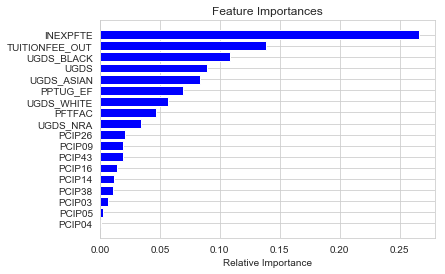

In [552]:
# plot feature importances random forest regressor retention
features = X_train1.columns
importances = regressor_rf.feature_importances_
indices = np.argsort(importances)
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance');

In [553]:
# create RF refressor and fit to data
regressor_ols = LinearRegression()
regressor_ols.fit(X_train_sc, y_train1)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [554]:
# predict target
y_pred_ols = regressor_ols.predict(X_test_sc)

In [555]:
# RSME RF regressor
np.sqrt(mean_squared_error(y_test1, y_pred_ols))

0.1609554870939002

### 7.1.2) Classification model

**I checked different feature combinations: selected numerical features only, selected categorical features only, combined selected numerical and categorical features. There was no difference in model performance so I work only with selected numerical features.**

#### 7.1.2.1) Baseline model

In [556]:
# create training and test sets
X_train2, X_test2, y_train2, y_test2 = train_test_split(df_select_cat_num, b_train, test_size=0.2, random_state=42)

In [557]:
# scale training data
X_train2_sc = scaler.fit_transform(X_train2)

In [558]:
# scale test data
X_test2_sc = scaler.transform(X_test2)

In [559]:
# create dummy classifier
reg_dum_cat = DummyClassifier(strategy='most_frequent', random_state=43)
reg_dum_cat.fit(X_train2_sc, y_train2)

DummyClassifier(constant=None, random_state=43, strategy='most_frequent')

In [560]:
# predict target
y_pred_dum_cat = reg_dum_cat.predict(X_test2_sc)

In [561]:
# evaluate quality of prediction
accuracy_score(y_test2, y_pred_dum_cat)

0.7364864864864865

In [570]:
# evaluate quality of prediction
roc_auc_score(y_test2, y_pred_dum_cat)

0.5

In [562]:
# create confusion matrix
matrix = confusion_matrix(y_test2, y_pred_dum_cat)

In [563]:
# matrix to df
df_cm = pd.DataFrame(matrix, index=['Low retention', 'High retention'], columns=['Low retention', 'High retention'])

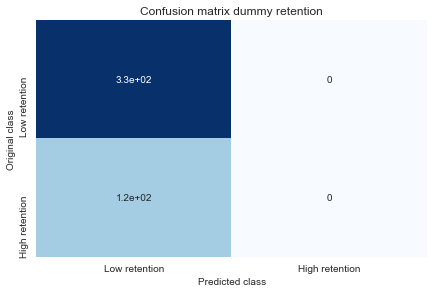

In [564]:
# plot confusion matrix
sns.heatmap(df_cm, annot=True, cbar=None, cmap='Blues')
plt.title('Confusion matrix dummy retention'), plt.tight_layout()
plt.ylabel('Original class')
plt.xlabel('Predicted class');

In [565]:
# print metrics
tar_nam = ['Low retention', 'High retention']
print(classification_report(y_test2, y_pred_dum_cat,target_names=tar_nam))

                precision    recall  f1-score   support

 Low retention       0.74      1.00      0.85       327
High retention       0.00      0.00      0.00       117

      accuracy                           0.74       444
     macro avg       0.37      0.50      0.42       444
  weighted avg       0.54      0.74      0.62       444



/Applications/anaconda3/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [34]:
# bootstrap model performance
model_meansd = []
for _ in range(100):
    # create training and test sets
    X_train2, X_test2, y_train2, y_test2 = train_test_split(df_select_cat_num, b_train, test_size=0.2)
    X_train2_sc = scaler.fit_transform(X_train2)
    X_test2_sc = scaler.transform(X_test2)
    reg_dum_cat = DummyClassifier(strategy='most_frequent', random_state=43)
    reg_dum_cat.fit(X_train2_sc, y_train2)
    y_pred_dum_cat = reg_dum_cat.predict(X_test2_sc)
    score = accuracy_score(y_test2, y_pred_dum_cat)
    model_meansd.append(score)

In [35]:
# calculate 95% CI
np.percentile(model_meansd, 2.5), np.percentile(model_meansd, 97.5)

(0.717286036036036, 0.786036036036036)

#### 7.1.2.2) RandomForestClassifier

In [566]:
# create RFC model and fit to data
reg_rfc = RandomForestClassifier(n_estimators=300, random_state = 42, class_weight='balanced')
reg_rfc.fit(X_train2_sc, y_train2)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=300,
                       n_jobs=None, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)

In [567]:
# predict test data
y_pred_rfc = reg_rfc.predict(X_test2_sc)

In [568]:
# evaluate quality of prediction
accuracy_score(y_test2, y_pred_rfc)

0.8671171171171171

In [571]:
# evaluate quality of prediction
roc_auc_score(y_test2, y_pred_rfc)

0.7698188661491413

In [572]:
# create confusion matric
matrix1 = confusion_matrix(y_test2, y_pred_rfc)

In [573]:
# matrix to df
df_cm1 = pd.DataFrame(matrix1, index=['Low retention', 'High retention'], columns=['Low retention', 'High retention'])

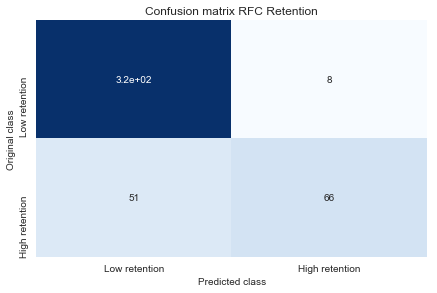

In [574]:
# plot confusion matrix
sns.heatmap(df_cm1, annot=True, cbar=None, cmap='Blues')
plt.title('Confusion matrix RFC Retention'), plt.tight_layout()
plt.ylabel('Original class')
plt.xlabel('Predicted class');

In [105]:
# print metrics
tar_nam = ['Low retention', 'High retention']
print(classification_report(y_test2, y_pred_rfc,target_names=tar_nam))

                precision    recall  f1-score   support

 Low retention       0.86      0.98      0.92       327
High retention       0.89      0.56      0.69       117

      accuracy                           0.87       444
     macro avg       0.88      0.77      0.80       444
  weighted avg       0.87      0.87      0.86       444



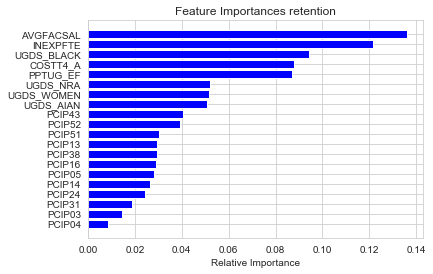

In [576]:
# plot feature importances random forest clasifier retention
features = X_train2.columns
importances = reg_rfc.feature_importances_
indices = np.argsort(importances)
plt.title('Feature Importances retention')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance');

In [32]:
# bootstrap model performance
model_means1 = []
for _ in range(100):
    # create training and test sets
    X_train2, X_test2, y_train2, y_test2 = train_test_split(df_select_cat_num, b_train, test_size=0.2)
    X_train2_sc = scaler.fit_transform(X_train2)
    X_test2_sc = scaler.transform(X_test2)
    reg_rfc = RandomForestClassifier(n_estimators=300, random_state = 42, class_weight='balanced')
    reg_rfc.fit(X_train2_sc, y_train2)
    y_pred_rfc = reg_rfc.predict(X_test2_sc)
    score = accuracy_score(y_test2, y_pred_rfc)
    model_means1.append(score)

In [33]:
# calculate 95% CI
np.percentile(model_means1, 2.5), np.percentile(model_means1, 97.5)

(0.8288288288288288, 0.8851351351351351)

In [577]:
# evaluate logistic regression
logreg = LogisticRegression()
logreg.fit(X_train2_sc, y_train2)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [578]:
# evaluate logistic regression
y_pred_log = logreg.predict(X_test2_sc)

In [579]:
# evaluate quality of model
accuracy_score(y_test2, y_pred_log)

0.8490990990990991

In [580]:
# create XGB model and fit to data
reg_xgb = XGBClassifier(random_state=42, booster='gbtree',n_estimators=1000)
reg_xgb.fit(X_train2_sc, y_train2)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints=None,
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints=None,
              n_estimators=1000, n_jobs=0, num_parallel_tree=1,
              objective='binary:logistic', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method=None,
              validate_parameters=False, verbosity=None)

In [581]:
# evaluate XGB classifier
y_pred_xgb = reg_xgb.predict(X_test2_sc)

In [582]:
# evaluate quality of model
accuracy_score(y_test2, y_pred_xgb)

0.8626126126126126

## 7.2) Graduation rate

### 7.2.1) Regression model

**I checked different feature combinations: selected numerical features only, all numerical features, combined selected numerical and categorical features. There was no difference in model performance so I work only with selected numerical features.**

#### 7.2.1.1) Baseline model 

In [583]:
# create training and test sets
X_train1g, X_test1g, y_train1g, y_test1g = train_test_split(df_selectg_num_num, y_traing, test_size=0.2, random_state=42)

In [584]:
# scale features train
X_train1_scg = scaler.fit_transform(X_train1g)

In [585]:
# scale features test
X_test1_scg = scaler.transform(X_test1g)

In [586]:
# create dummy regressor and fit to training data
dum_regg = DummyRegressor(strategy='mean')
dum_regg.fit(X_train1_scg, y_train1g)

DummyRegressor(constant=None, quantile=None, strategy='mean')

In [587]:
# dummy model predict
y_pred_dumg = dum_regg.predict(X_test1_scg)

In [588]:
# evaluate quality of model
np.sqrt(mean_squared_error(y_test1g, y_pred_dumg))

0.11720445042298425

#### 7.2.1.2) RandomForestRegressor

In [589]:
# create RF regressor and fit to data
regressor_rfg = RandomForestRegressor(n_estimators=300, random_state=3, n_jobs= -1 )
regressor_rfg.fit(X_train1_scg, y_train1g)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=300, n_jobs=-1, oob_score=False,
                      random_state=3, verbose=0, warm_start=False)

In [590]:
# random forest predict
y_pred_rfg = regressor_rfg.predict(X_test1_scg)

In [591]:
# evaluate quality of model
np.sqrt(mean_squared_error(y_test1g, y_pred_rfg))

0.07491846240225186

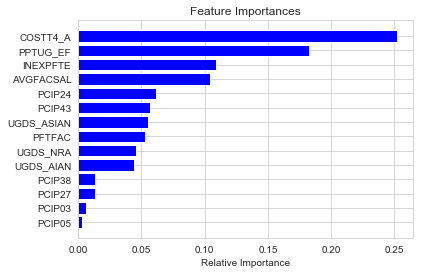

In [592]:
# plot feature importances random forest regressor graduation
featuresg = X_train1g.columns
importancesg = regressor_rfg.feature_importances_
indicesg = np.argsort(importancesg)
plt.title('Feature Importances')
plt.barh(range(len(indicesg)), importancesg[indicesg], color='b', align='center')
plt.yticks(range(len(indicesg)), [featuresg[i] for i in indicesg])
plt.xlabel('Relative Importance');

### 7.2.2) Classification model

**I checked different feature combinations: selected numerical features only, selected categorical features only, combined selected numerical and categorical features. There was no difference in model performance so I work only with selected numerical features.**

#### 7.2.2.1) Baseline model

In [593]:
# create training and test sets
X_train2g, X_test2g, y_train2g, y_test2g = train_test_split(df_selectg_cat_num, b_traing, test_size=0.2, random_state=42)

In [594]:
# scale training data
X_train2_scg = scaler.fit_transform(X_train2g)

In [595]:
# scale test data
X_test2_scg = scaler.transform(X_test2g)

In [596]:
# create dummy classifier
reg_dum_catg = DummyClassifier(strategy='most_frequent', random_state=43)
reg_dum_catg.fit(X_train2_scg, y_train2g)

DummyClassifier(constant=None, random_state=43, strategy='most_frequent')

In [597]:
# predict target
y_pred_dum_catg = reg_dum_catg.predict(X_test2_scg)

In [598]:
# evaluate quality of prediction
accuracy_score(y_test2g, y_pred_dum_catg)

0.8031837916063675

In [599]:
# evaluate quality of prediction
roc_auc_score(y_test2g, y_pred_dum_catg)

0.5

In [600]:
# create confusion matrix
matrix2 = confusion_matrix(y_test2g, y_pred_dum_catg)

In [601]:
# matrix to df
df_cm2 = pd.DataFrame(matrix2, index=['Low retention', 'High retention'], columns=['Low retention', 'High retention'])

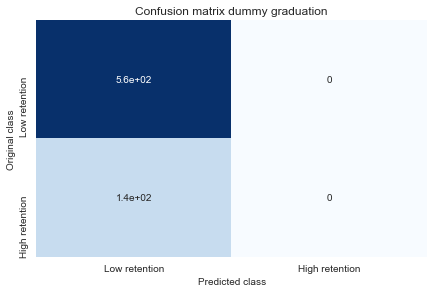

In [602]:
# plot confusion matrix
sns.heatmap(df_cm2, annot=True, cbar=None, cmap='Blues')
plt.title('Confusion matrix dummy graduation'), plt.tight_layout()
plt.ylabel('Original class')
plt.xlabel('Predicted class');

In [603]:
# plot metrics
tar_nam = ['Low retention', 'High retention']
print(classification_report(y_test2g, y_pred_dum_catg,target_names=tar_nam))

                precision    recall  f1-score   support

 Low retention       0.80      1.00      0.89       555
High retention       0.00      0.00      0.00       136

      accuracy                           0.80       691
     macro avg       0.40      0.50      0.45       691
  weighted avg       0.65      0.80      0.72       691



/Applications/anaconda3/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [36]:
# bootstrap model performance
model_meansdg = []
for _ in range(100):
    X_train2g, X_test2g, y_train2g, y_test2g = train_test_split(df_selectg_cat_num, b_traing, test_size=0.2)
    X_train2_scg = scaler.fit_transform(X_train2g)
    X_test2_scg = scaler.transform(X_test2g)
    reg_dum_catg = DummyClassifier(strategy='most_frequent', random_state=43)
    reg_dum_catg.fit(X_train2_scg, y_train2g)
    y_pred_dum_catg = reg_dum_catg.predict(X_test2_scg)
    score = accuracy_score(y_test2g, y_pred_dum_catg)
    model_meansdg.append(score)

In [37]:
# calculate 95% CI
np.percentile(model_meansdg, 2.5), np.percentile(model_meansdg, 97.5)

(0.7589363241678726, 0.8104196816208393)

#### 7.1.2.2) RandomForestClassifier

In [604]:
# create RFC model and fit to data
reg_rfcg = RandomForestClassifier(n_estimators=300, random_state = 42, class_weight='balanced')
reg_rfcg.fit(X_train2_scg, y_train2g)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=300,
                       n_jobs=None, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)

In [605]:
# predict test data
y_pred_rfcg = reg_rfcg.predict(X_test2_scg)

In [606]:
# evaluate quality of prediction
accuracy_score(y_test2g, y_pred_rfcg)

0.8842257597684515

In [607]:
# evaluate quality of prediction
roc_auc_score(y_test2g, y_pred_rfcg)

0.7697204557498676

In [608]:
# create confusion matrix
matrix3 = confusion_matrix(y_test2g, y_pred_rfcg)

In [609]:
# matrix to df
df_cm3 = pd.DataFrame(matrix3, index=['Low retention', 'High retention'], columns=['Low retention', 'High retention'])

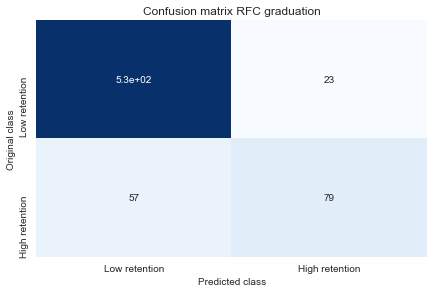

In [610]:
# plot confusion matrix
sns.heatmap(df_cm3, annot=True, cbar=None, cmap='Blues')
plt.title('Confusion matrix RFC graduation'), plt.tight_layout()
plt.ylabel('Original class')
plt.xlabel('Predicted class');

In [611]:
# print metrics
tar_nam = ['Low retention', 'High retention']
print(classification_report(y_test2g, y_pred_rfcg,target_names=tar_nam))

                precision    recall  f1-score   support

 Low retention       0.90      0.96      0.93       555
High retention       0.77      0.58      0.66       136

      accuracy                           0.88       691
     macro avg       0.84      0.77      0.80       691
  weighted avg       0.88      0.88      0.88       691



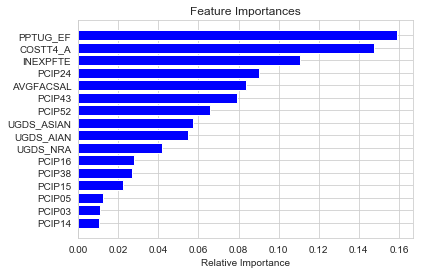

In [612]:
# plot feature importances random forest clasifier graduation
featuresg = X_train2g.columns
importancesg = reg_rfcg.feature_importances_
indicesg = np.argsort(importancesg)
plt.title('Feature Importances')
plt.barh(range(len(indicesg)), importancesg[indicesg], color='b', align='center')
plt.yticks(range(len(indicesg)), [featuresg[i] for i in indicesg])
plt.xlabel('Relative Importance');

In [29]:
# bootstrap model performance
model_means = []
for _ in range(10000):
    X_train2g, X_test2g, y_train2g, y_test2g = train_test_split(df_selectg_cat_num, b_traing, test_size=0.2)
    X_train2_scg = scaler.fit_transform(X_train2g)
    X_test2_scg = scaler.transform(X_test2g)
    reg_rfcg = RandomForestClassifier(n_estimators=300, random_state = 42, class_weight='balanced')
    reg_rfcg.fit(X_train2_scg, y_train2g)
    y_pred_rfcg = reg_rfcg.predict(X_test2_scg)
    score = accuracy_score(y_test2g, y_pred_rfcg)
    model_means.append(score)

In [31]:
# calculate 95% CI
np.percentile(model_means, 2.5), np.percentile(model_means, 97.5)

(0.8509406657018813, 0.8958031837916064)

In [613]:
# create hyperparameter choices

n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(10, 100, num = 10)]
max_depth.append(None)
min_samples_split = [2, 3, 6, 10]
min_samples_leaf = [1, 2, 4]
bootstrap = [True, False]

In [614]:
# create dic
choice = {'n_estimators': n_estimators,
          'max_features': max_features,
          'max_depth': max_depth,
          'min_samples_split': min_samples_split,
          'min_samples_leaf': min_samples_leaf,
          'bootstrap': bootstrap}

In [615]:
# check dic
print(choice)

{'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000], 'max_features': ['auto', 'sqrt'], 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, None], 'min_samples_split': [2, 3, 6, 10], 'min_samples_leaf': [1, 2, 4], 'bootstrap': [True, False]}


In [133]:
# create classifier for model tuning
rfc = RandomForestClassifier()

In [134]:
# create random search model
rsearch = RandomizedSearchCV(rfc, choice, random_state=43, n_iter=100, cv=5, n_jobs=-1)

In [148]:
# create grid search model
gsearch = GridSearchCV(rfc, choice, cv=5, n_jobs=-1)

In [ ]:
# create best model grid search
best_model_grid = gsearch.fit(X_train2_scg, y_train2g)

/Applications/anaconda3/lib/python3.6/site-packages/joblib/externals/loky/process_executor.py:706: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  "timeout or by a memory leak.", UserWarning


In [135]:
# create best model random search
best_model = rsearch.fit(X_train2_scg, y_train2g)

/Applications/anaconda3/lib/python3.6/site-packages/joblib/externals/loky/process_executor.py:706: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  "timeout or by a memory leak.", UserWarning


In [137]:
# predict target random search
y_pred_bm = best_model.predict(X_test2_scg)

In [143]:
# predict target grid search
y_pred_bmg = best_model_grid.predict(X_test2_scg)

In [138]:
# evaluate quality of prediction random search
accuracy_score(y_test2g, y_pred_bm)

0.8900144717800289

In [144]:
# evaluate quality of prediction grid search
accuracy_score(y_test2g, y_pred_bmg)

0.8871201157742402

In [616]:
# evaluate logistic regression
logregg = LogisticRegression()
#logregg.fit(X_train2_scg, y_train2g)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [617]:
# predict target
y_pred_logg = logregg.predict(X_test2_scg)

In [618]:
# evaluate quality of model
accuracy_score(y_test2g, y_pred_logg)

0.8726483357452967

In [619]:
# create XGB model and fit to data
reg_xgbg = XGBClassifier(random_state=42,n_estimators=1000)
reg_xgbg.fit(X_train2_scg, y_train2g)

XGBClassifier(base_score=0.5, booster=None, colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints=None,
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints=None,
              n_estimators=1000, n_jobs=0, num_parallel_tree=1,
              objective='binary:logistic', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method=None,
              validate_parameters=False, verbosity=None)

In [620]:
# predict target
y_pred_xgbg = reg_xgbg.predict(X_test2_scg)

In [621]:
# evaluate accuracy of model
accuracy_score(y_test2g, y_pred_xgbg)

0.8668596237337193

**Compare important features between retention and graduation**

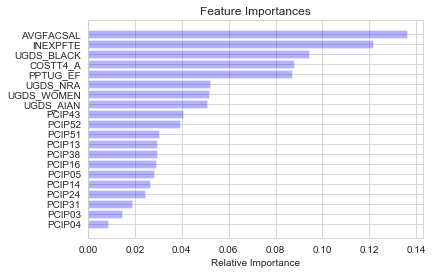

In [628]:
# plot feature importances random forest clasifier retention

features = X_train2.columns
importances = reg_rfc.feature_importances_
indices = np.argsort(importances)
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b',alpha=0.3, align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance');

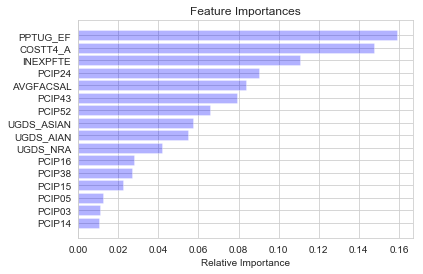

In [629]:
# plot feature importances random forest clasifier graduation

featuresg = X_train2g.columns
importancesg = reg_rfcg.feature_importances_
indicesg = np.argsort(importancesg)
plt.title('Feature Importances')
plt.barh(range(len(indicesg)), importancesg[indicesg], color='b',alpha=0.3, align='center')
plt.yticks(range(len(indicesg)), [featuresg[i] for i in indicesg])
plt.xlabel('Relative Importance');


# 8) Statistical evaluation

## 8.1) Retention rate

### 8.1.1) Average Faculty Salary

In [30]:
# create df with low retention rate
df_low = df_ret_ft_4_num[df_ret_ft_4_num['RET_FT4_POOLED_binr']==0]

In [631]:
# create df with high retention rate
df_high = df_ret_ft_4_num[df_ret_ft_4_num['RET_FT4_POOLED_binr']==1]

In [632]:
# create variable of interest
df_avg_low = df_low['AVGFACSAL']

In [633]:
# create variable of interest
df_avg_high = df_high['AVGFACSAL']

In [634]:
# bootstrap variable mean
boot_means_low = [] 
for _ in range(20000):
    bootsample = df_avg_low.sample(1662, replace=True)
    boot_means_low.append(bootsample.mean())

In [635]:
# calculate 95% CI
np.percentile(boot_means_low, 2.5), np.percentile(boot_means_low, 97.5)

(6443.133115222624, 6626.5908844765345)

In [636]:
# bootstrap variable mean
boot_means_high = [] 
for _ in range(10000):
    bootsample = df_avg_high.sample(554, replace=True)
    boot_means_high.append(bootsample.mean())

In [637]:
# calculate 95% CI
np.percentile(boot_means_high, 2.5), np.percentile(boot_means_high, 97.5)

(8778.41331227437, 9318.456994584836)

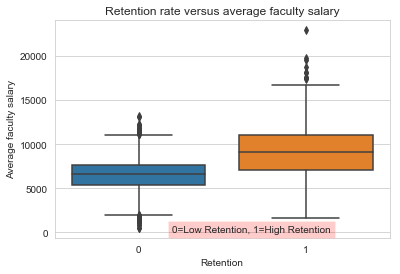

In [638]:
# boxplot retention rate faculty salary
sns.set_style("whitegrid")
ax = plt.subplot(111)
labels = df_ret_ft_4_num.RET_FT4_POOLED_binr

ax.text(0.2, 0.3, '0=Low Retention, 1=High Retention', bbox=dict(facecolor='red', alpha=0.2))
retention = df_ret_ft_4_num.AVGFACSAL

boxp3 = sns.boxplot(x=labels, 
                    y=retention);
boxp3.set(xlabel = 'Retention', 
          ylabel = 'Average faculty salary',
          title = 'Retention rate versus average faculty salary');

### 8.1.2) Instructional Expenditures per full time student

In [639]:
# create variable of interest
df_exp_low = df_low['INEXPFTE']

In [640]:
# create variable of interest
df_exp_high = df_high['INEXPFTE']

In [641]:
# number of low data points
len(df_exp_low)

1662

In [642]:
# bootstrap variable mean
boot_means_low1 = []
for _ in range(10000):
    bootsample = df_exp_low.sample(1662, replace=True)
    boot_means_low1.append(bootsample.mean())

In [643]:
# calculate 95% CI
np.percentile(boot_means_low1, 2.5), np.percentile(boot_means_low1, 97.5)

(7685.471419975933, 8190.423555956679)

In [644]:
# bootstrap variable mean
boot_means_high1 = []
for _ in range(10000):
    bootsample = df_exp_high.sample(554, replace=True)
    boot_means_high1.append(bootsample.mean())

In [645]:
# calculate 95% CI
np.percentile(boot_means_high1, 2.5), np.percentile(boot_means_high1, 97.5)

(14765.550947653428, 17015.860604693138)

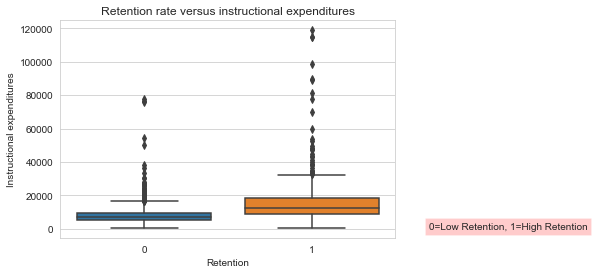

In [646]:
# boxplot retention rate instructional expenditures
sns.set_style("whitegrid")
ax = plt.subplot(111)
labels = df_ret_ft_4_num.RET_FT4_POOLED_binr

ax.text(1.7, 0.3, '0=Low Retention, 1=High Retention', bbox=dict(facecolor='red', alpha=0.2))
retention = df_ret_ft_4_num.INEXPFTE

boxp3 = sns.boxplot(x=labels, 
                    y=retention);
boxp3.set(xlabel = 'Retention', 
          ylabel = 'Instructional expenditures',
          title =  'Retention rate versus instructional expenditures');

### 8.1.3) Share of undergraduate black students

In [647]:
# create variable of interest
df_black_low = df_low['UGDS_BLACK']

In [648]:
# create variable of interest
df_black_high = df_high['UGDS_BLACK']

In [649]:
# bootstrap variable mean
boot_means_low2 = []
for _ in range(10000):
    bootsample = df_black_low.sample(1662, replace=True)
    boot_means_low2.append(bootsample.mean())

In [650]:
# calculate 95% CI
np.percentile(boot_means_low2, 2.5), np.percentile(boot_means_low2, 97.5)

(0.16366537605294812, 0.184081086040915)

In [651]:
# bootstrap variable mean
boot_means_high2 = []
for _ in range(10000):
    bootsample = df_black_high.sample(554, replace=True)
    boot_means_high2.append(bootsample.mean())

In [652]:
# calculate 95% CI
np.percentile(boot_means_high2, 2.5), np.percentile(boot_means_high2, 97.5)

(0.06244434566787002, 0.08086825361010833)

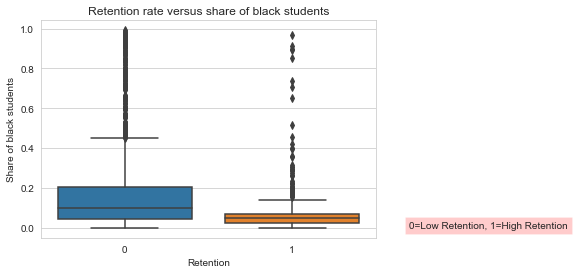

In [653]:
# boxplot retention rate share of black students
sns.set_style("whitegrid")
ax = plt.subplot(111)
labels = df_ret_ft_4_num.RET_FT4_POOLED_binr

ax.text(1.7, 0, '0=Low Retention, 1=High Retention', bbox=dict(facecolor='red', alpha=0.2))
retention = df_ret_ft_4_num.UGDS_BLACK

boxp3 = sns.boxplot(x=labels, 
                    y=retention);
boxp3.set(xlabel = 'Retention', 
          ylabel = 'Share of black students',
          title = 'Retention rate versus share of black students');

### 8.1.4) Average cost of attendance

In [654]:
# create variable of interest
df_cost_low = df_low['COSTT4_A']

In [655]:
# create variable of interest
df_cost_high = df_high['COSTT4_A']

In [656]:
# bootstrap variable mean
boot_means_low3 = []
for _ in range(10000):
    bootsample = df_cost_low.sample(1662, replace=True)
    boot_means_low3.append(bootsample.mean())

In [657]:
# calculate 95% CI
np.percentile(boot_means_low3, 2.5), np.percentile(boot_means_low3, 97.5)

(29282.879362214197, 30403.268772563177)

In [658]:
# bootstrap variable mean
boot_means_high3 = []
for _ in range(10000):
    bootsample = df_cost_high.sample(554, replace=True)
    boot_means_high3.append(bootsample.mean())

In [659]:
# calculate 95% CI
np.percentile(boot_means_high3, 2.5), np.percentile(boot_means_high3, 97.5)

(40246.79129061372, 43335.57545126354)

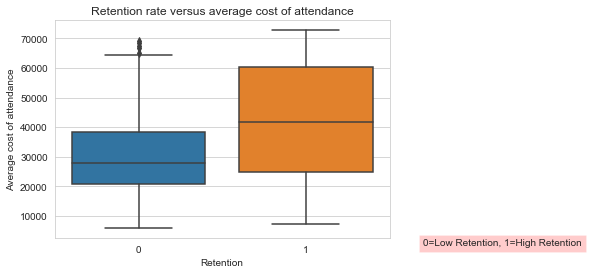

In [660]:
# boxplot retention rate cost of attendance
sns.set_style("whitegrid")
ax = plt.subplot(111)
labels = df_ret_ft_4_num.RET_FT4_POOLED_binr

ax.text(1.7, 0, '0=Low Retention, 1=High Retention', bbox=dict(facecolor='red', alpha=0.2))
retention = df_ret_ft_4_num.COSTT4_A

boxp3 = sns.boxplot(x=labels, 
                    y=retention);
boxp3.set(xlabel = 'Retention', 
          ylabel = 'Average cost of attendance',
          title = 'Retention rate versus average cost of attendance');

### 8.1.5) Share of part time undergraduate students

In [661]:
# create variable of interest
df_time_low = df_low['PPTUG_EF']

In [662]:
# create variable of interest
df_time_high = df_high['PPTUG_EF']

In [663]:
# bootstrap variable mean
boot_means_low4 = []
for _ in range(10000):
    bootsample = df_time_low.sample(1662, replace=True)
    boot_means_low4.append(bootsample.mean())

In [664]:
# calculate 95% CI
np.percentile(boot_means_low4, 2.5), np.percentile(boot_means_low4, 97.5)

(0.1850821043922985, 0.2042932521058966)

In [665]:
# bootstrap variable mean
boot_means_high4 = []
for _ in range(10000):
    bootsample = df_time_high.sample(554, replace=True)
    boot_means_high4.append(bootsample.mean())

In [666]:
# calculate 95% CI
np.percentile(boot_means_high4, 2.5), np.percentile(boot_means_high4, 97.5)

(0.07205644855595664, 0.09606615974729239)

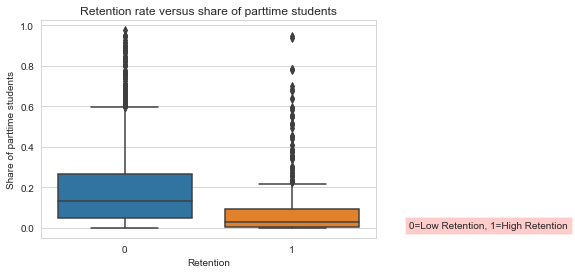

In [667]:
# boxplot retention rate part time students
sns.set_style("whitegrid")
ax = plt.subplot(111)
labels = df_ret_ft_4_num.RET_FT4_POOLED_binr

ax.text(1.7, 0, '0=Low Retention, 1=High Retention', bbox=dict(facecolor='red', alpha=0.2))
retention = df_ret_ft_4_num.PPTUG_EF

boxp3 = sns.boxplot(x=labels, 
                    y=retention);
boxp3.set(xlabel = 'Retention', 
          ylabel = 'Share of parttime students',
          title = 'Retention rate versus share of parttime students');

## 8.2) Graduation rate

### 8.2.1) Share of part time undergraduate students

In [668]:
# create low graduation df
df_lowg = df_oma_ftft_num[df_oma_ftft_num['OMAWDP6_FTFT_POOLED_binr']==0]

In [669]:
# create high graduation df
df_highg = df_oma_ftft_num[df_oma_ftft_num['OMAWDP6_FTFT_POOLED_binr']==1]

In [670]:
# number of low datapoints
df_lowg.shape

(2732, 60)

In [671]:
# number of high datapoints
df_highg.shape

(741, 60)

In [672]:
# create variable of interest
df_time_lowg = df_lowg['PPTUG_EF']

In [673]:
# create variable of interest
df_time_highg = df_highg['PPTUG_EF']

In [674]:
# bootstrap variable mean
boot_means_lowg = []
for _ in range(10000):
    bootsample = df_time_lowg.sample(2732, replace=True)
    boot_means_lowg.append(bootsample.mean())

In [675]:
# calculate 95% CI
np.percentile(boot_means_lowg, 2.5), np.percentile(boot_means_lowg, 97.5)

(0.30352446467789174, 0.3217178262262083)

In [676]:
# bootstrap variable mean
boot_means_highg = []
for _ in range(10000):
    bootsample = df_time_highg.sample(741, replace=True)
    boot_means_highg.append(bootsample.mean())

In [677]:
# calculate 95% CI
np.percentile(boot_means_highg, 2.5), np.percentile(boot_means_highg, 97.5)

(0.07331142712550609, 0.09539876855600539)

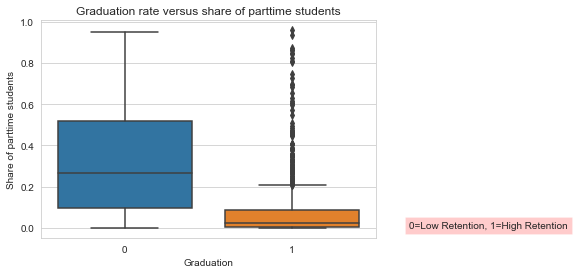

In [678]:
# boxplot graduation rate parttime students
sns.set_style("whitegrid")
ax = plt.subplot(111)
labels = df_oma_ftft_num.OMAWDP6_FTFT_POOLED_binr

ax.text(1.7, 0, '0=Low Retention, 1=High Retention', bbox=dict(facecolor='red', alpha=0.2))
graduation = df_oma_ftft_num.PPTUG_EF

boxp3 = sns.boxplot(x=labels, 
                    y=graduation);
boxp3.set(xlabel = 'Graduation', 
          ylabel = 'Share of parttime students',
          title = 'Graduation rate versus share of parttime students');

### 8.2.2) Average cost of attendance

In [679]:
# create variable of interest
df_alien_lowg = df_lowg['COSTT4_A']

In [680]:
# create variable of interest
df_alien_highg = df_highg['COSTT4_A']

In [681]:
# bootstrap variable mean
boot_means_lowg1 = []
for _ in range(10000):
    bootsample = df_alien_lowg.sample(2732, replace=True)
    boot_means_lowg1.append(bootsample.mean())

In [682]:
# calculate 95% CI
np.percentile(boot_means_lowg1, 2.5), np.percentile(boot_means_lowg1, 97.5)

(22089.6630215959, 22971.002251098096)

In [683]:
# bootstrap variable mean
boot_means_highg1 = []
for _ in range(10000):
    bootsample = df_alien_highg.sample(741, replace=True)
    boot_means_highg1.append(bootsample.mean())

In [684]:
# calculate 95% CI
np.percentile(boot_means_highg1, 2.5), np.percentile(boot_means_highg1, 97.5)

(39361.897402159244, 41869.05006747638)

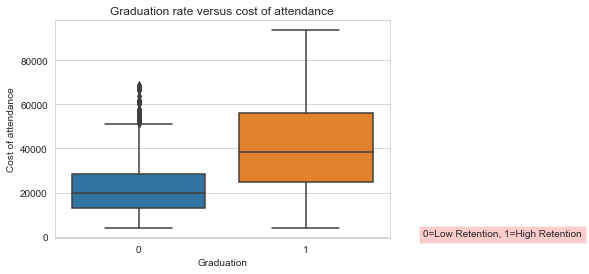

In [685]:
# boxplot graduation rate cost of attendance
sns.set_style("whitegrid")
ax = plt.subplot(111)
labels = df_oma_ftft_num.OMAWDP6_FTFT_POOLED_binr

ax.text(1.7, 0, '0=Low Retention, 1=High Retention', bbox=dict(facecolor='red', alpha=0.2))
graduation = df_oma_ftft_num.COSTT4_A

boxp3 = sns.boxplot(x=labels, 
                    y=graduation);
boxp3.set(xlabel = 'Graduation', 
          ylabel = 'Cost of attendance',
          title = 'Graduation rate versus cost of attendance');

### 8.2.3) Instructional expenditure per full time student

In [686]:
# create variable of interest
df_women_lowg = df_lowg['INEXPFTE']

In [687]:
# create variable of interest
df_women_highg = df_highg['INEXPFTE']

In [688]:
# bootstrap variable mean
boot_means_lowg2 = []
for _ in range(10000):
    bootsample = df_women_lowg.sample(2732, replace=True)
    boot_means_lowg2.append(bootsample.mean())

In [689]:
# calculate 95% CI
np.percentile(boot_means_lowg2, 2.5), np.percentile(boot_means_lowg2, 97.5)

(6930.940217789165, 7247.358244875549)

In [690]:
# bootstrap variable mean
boot_means_highg2 = []
for _ in range(10000):
    bootsample = df_women_highg.sample(741, replace=True)
    boot_means_highg2.append(bootsample.mean())

In [691]:
# calculate 95% CI
np.percentile(boot_means_highg2, 2.5), np.percentile(boot_means_highg2, 97.5)

(12742.104183535763, 14494.080229419704)

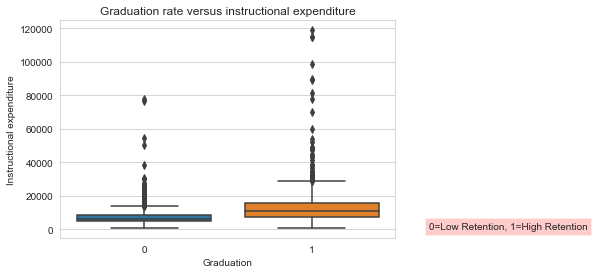

In [692]:
# boxplot graduation instructional expenditure
sns.set_style("whitegrid")
ax = plt.subplot(111)
labels = df_oma_ftft_num.OMAWDP6_FTFT_POOLED_binr

ax.text(1.7, 0, '0=Low Retention, 1=High Retention', bbox=dict(facecolor='red', alpha=0.2))
graduation = df_oma_ftft_num.INEXPFTE

boxp3 = sns.boxplot(x=labels, 
                    y=graduation);
boxp3.set(xlabel = 'Graduation', 
          ylabel = 'Instructional expenditure',
          title = 'Graduation rate versus instructional expenditure');

### 8.2.4)Percentage of degrees in liberal arts etc.

In [693]:
# create variable of interest
df_aian_lowg = df_lowg['PCIP24']

In [694]:
# create variable of interest
df_aian_highg = df_highg['PCIP24']

In [695]:
# bootstrap variable mean
boot_means_lowg3 = []
for _ in range(10000):
    bootsample = df_aian_lowg.sample(2732, replace=True)
    boot_means_lowg3.append(bootsample.mean())

In [696]:
# calculate 95% CI
np.percentile(boot_means_lowg3, 2.5), np.percentile(boot_means_lowg3, 97.5)

(0.1259806332357249, 0.14019901994875558)

In [697]:
# bootstrap variable mean
boot_means_highg3 = []
for _ in range(10000):
    bootsample = df_aian_highg.sample(741, replace=True)
    boot_means_highg3.append(bootsample.mean())

In [698]:
# calculate 95% CI
np.percentile(boot_means_highg3, 2.5), np.percentile(boot_means_highg3, 97.5)

(0.013407962213225377, 0.02858220310391364)

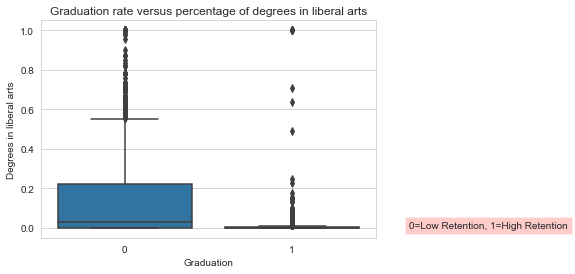

In [699]:
# boxplot graduation degree in liberal arts
sns.set_style("whitegrid")
ax = plt.subplot(111)
labels = df_oma_ftft_num.OMAWDP6_FTFT_POOLED_binr

ax.text(1.7, 0, '0=Low Retention, 1=High Retention', bbox=dict(facecolor='red', alpha=0.2))
graduation = df_oma_ftft_num.PCIP24

boxp3 = sns.boxplot(x=labels, 
                    y=graduation);
boxp3.set(xlabel = 'Graduation', 
          ylabel = 'Degrees in liberal arts',
          title = 'Graduation rate versus percentage of degrees in liberal arts');

### 8.2.5) Average faculty salary

In [700]:
# create variable of interest
df_law_lowg = df_lowg['AVGFACSAL']

In [701]:
# create variable of interest
df_law_highg = df_highg['AVGFACSAL']

In [702]:
# bootstrap variable mean
boot_means_lowg4 = []
for _ in range(10000):
    bootsample = df_law_lowg.sample(2732, replace=True)
    boot_means_lowg4.append(bootsample.mean())

In [703]:
# calculate 95% CI
np.percentile(boot_means_lowg4, 2.5), np.percentile(boot_means_lowg4, 97.5)

(6192.42449670571, 6350.423014275257)

In [704]:
# bootstrap variable mean
boot_means_highg4 = []
for _ in range(10000):
    bootsample = df_law_highg.sample(741, replace=True)
    boot_means_highg4.append(bootsample.mean())

In [705]:
# calculate 95% CI
np.percentile(boot_means_highg4, 2.5), np.percentile(boot_means_highg4, 97.5)

(7732.781950067477, 8228.276619433198)

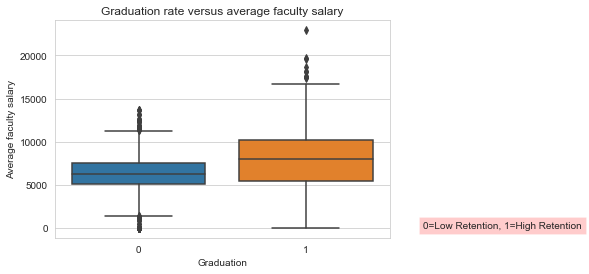

In [706]:
# boxplot graduation average faculty salary
sns.set_style("whitegrid")
ax = plt.subplot(111)
labels = df_oma_ftft_num.OMAWDP6_FTFT_POOLED_binr

ax.text(1.7, 0, '0=Low Retention, 1=High Retention', bbox=dict(facecolor='red', alpha=0.2))
graduation = df_oma_ftft_num.AVGFACSAL

boxp3 = sns.boxplot(x=labels, 
                    y=graduation);
boxp3.set(xlabel = 'Graduation', 
          ylabel = 'Average faculty salary',
          title = 'Graduation rate versus average faculty salary');